In [1]:
import torch
import gpytorch
import GPy
import math
from SC_IPFP.torch.utils import NN, log_kde_pdf_per_point, silvermans_rule
from SC_IPFP.torch.sde_solvers_time import solve_sde_RK


from tqdm.notebook import tqdm

from torch import nn

import itertools
from functools import partial
# np = jax.numpy
import matplotlib.pyplot as plt

In [39]:
from torch import nn
class NN(nn.Module):

    def __init__(self, input_dim=1,  weight_dim_list=[20,20,20]):
        super(NN, self).__init__()

        self.weight_dim_list = [input_dim] + weight_dim_list
        self.layers = [None for i in weight_dim_list]

        for i in range(len(weight_dim_list)):
            setattr(
                self,
                "f" + str(i),
                nn.Linear(
                    self.weight_dim_list[i], self.weight_dim_list[i + 1],
                    bias=True
                )
            )
            self.layers[i]  = getattr(self, "f" + str(i))

            torch.nn.init.xavier_uniform(self.layers[i].weight)
    
    def get_var(self , other=None):
        return torch.tensor([[0]]).double()

    def forward(self, x, var=None):
        functerino = torch.nn.functional.elu
        x_ = x.clone()
        for i_, layer in enumerate(self.layers[:-1]):
            try:
                x = functerino(layer(x))
            except:
                print(x.shape, i_, x_.shape)
                import pdb; pdb.set_trace()
                raise
        try:
            return (self.layers[-1](x))
        except:
            import pdb; pdb.set_trace()
            raise


In [31]:
def solve_sde_RK(alfa=None, beta=None, X0=None, dt=1.0, N=100, t0=0.0,
                theta=None, noise=False, forwards=True):
    """
            Euler Mayurama method
    Syntax:
    ----------
    solve_sde(alfa=None, beta=None, X0=None, dt=None, N=100, t0=0, DW=None)
    Parameters:
    ----------
        alfa  : a  function with two arguments, the X state and the time
                defines the differential equation.
        beta  : a  function with two arguments, the X state and the time
                defines the stochastic part of the SDE.
        X0    : Initial conditions of the SDE. Mandatory for SDEs
                with variables > 1 (default: gaussian np.random)
        dt    : The timestep of the solution
                (default: 1)
        N     : The number of timesteps (defines the length of the timeseries)
                (default: 100)
        t0    : The initial time of the solution
                (default: 0)
    
    """
    
#     print(X0)
       
    if alfa is None or beta is None:
        raise ValueError("Error: SDE not defined.")

    n, d, *_ = X0.shape
    
    T = torch.tensor(dt * N).cuda()
    
    DWs  = torch.empty((n, N-1, d)).normal_(mean=0, std=1).cuda() * math.sqrt(dt)
    
    
    Y, ti = torch.zeros((n, N, d + 1)).double().cuda(), torch.arange(N).double().cuda()*dt + t0
    t0rep =  (
        t0 * torch.ones((X0.shape[0], 1)).double().cuda() if forwards
        else (T-t0) * torch.ones((X0.shape[0], 1)).double().cuda()
    )
#     Y[:, 0, :] =  torch.cat((X0, t0rep), axis=1 )
    Y = torch.cat((X0, t0rep), axis=1 )[:, None, :]

    N = int(N)
    
    T = dt * N
        
    for n in range(N-1):
        t = ti[n]
        a, DW_n = alfa(Y[:,n, :]),  DWs[:,n,:]
        newY = (  
            Y[:,n, :-1] + a * dt + beta * DW_n
        )
        
        trep = (
            t.repeat(newY.shape[0]).reshape(-1,1) if forwards
            else T - t.repeat(newY.shape[0]).reshape(-1,1)
        )
        
        tocat = torch.cat((newY, trep), dim=1)[:, None, :]
        Y = torch.cat((Y,tocat) , dim=1)
    if torch.isnan(Y).any() or torch.isinf(Y).any(): import pdb; pdb.set_trace()
#     import pdb; pdb.set_trace()
    return ti, Y

In [32]:
def plot_trajectories_both(Xts,t , Xts_, t_):

    fn = 14
    fig, axs = plt.subplots(2,1,  sharey=False, figsize=(15,10))
    axs[1].set_xlabel("$t$", fontsize=fn)
    axs[1].set_ylabel("$x(t)$", fontsize=fn)
    axs[0].set_ylabel("$x(t)$", fontsize=fn)

    tt = axs[1].get_xticks()
    axs[1].set_xticks(tt.flatten() )
    axs[1].set_xticklabels(list(map (lambda x: '{0:.2f}'.format((x)), tt))[::-1])
    
    n =  Xts.shape[0]
    for i in range(n):
        label = "$\mathbb{Q}$: Forward process" if i == 0 else None
        axs[0].plot(t.cpu().flatten(), Xts[i,:,:-1].detach().cpu().numpy().flatten(), 'b', alpha=0.3,  label=label)

    n =  Xts_.shape[0]
    for i in range(n):
        label = "$\mathbb{P}$: Reverse process" if i == 0 else None
        axs[1].plot(t_.cpu().flatten(), Xts_[i,:, :-1].detach().cpu().numpy().flatten(), 'r', alpha=0.3, label=label)

    axs[1].legend(fontsize=fn)
    axs[0].legend(fontsize=fn)

    plt.show() 

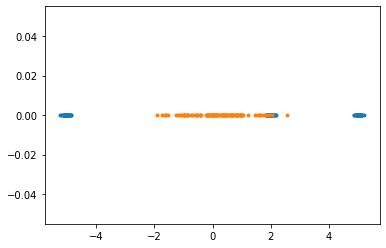

In [33]:
import numpy.random as npr
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

n = 102
n_2 = int(n * 1.0 / 3)
# n_2 = int(n * 1.0 / 2.0)


X1 = npr.randn(n).reshape(-1,1) - 0
X21 = 0.1 * npr.randn(n_2).reshape(-1,1) + 5
X22 =  0.1 * npr.randn(n_2).reshape(-1,1) - 5
X23 =  0.1 * npr.randn(n_2).reshape(-1,1) + 2

X2 = np.concatenate((X21, X22, X23), axis=0)
# X1, X2 = X2, X1

plt.plot(X2.flatten(), [0] * n, '.')
plt.plot(X1.flatten(), [0] * n, '.')

with torch.cuda.device(0):

    X1 = torch.tensor(X1).cuda()
    X2 = torch.tensor(X2).cuda()

In [34]:
# We will use the simplest form of GP model, exact inference
class ExactGPModel(gpytorch.models.ExactGP):
    def __init__(self, train_x, train_y, likelihood):
        super(ExactGPModel, self).__init__(train_x, train_y, likelihood)
        self.mean_module = gpytorch.means.ConstantMean()
        self.covar_module = gpytorch.kernels.ScaleKernel(gpytorch.kernels.RBFKernel())

    def forward(self, x):
        mean_x = self.mean_module(x)
        covar_x = self.covar_module(x)
        return gpytorch.distributions.MultivariateNormal(mean_x, covar_x)

def plot_trajectories_( Xts, t):

    fn = 14
    fig, axs = plt.subplots(1,1,  sharey=False, figsize=(15,10))
    axs.set_ylabel("$x(t)$", fontsize=fn)



    for i in range(n):
        label = "$\mathbb{Q}$: Forward process" if i == 0 else None
        axs.plot(t.cpu().flatten(), Xts[i,:,:-1].detach().cpu().numpy().flatten(), 'b', alpha=0.3,  label=label)

    plt.show()    
    

def plot_trajectories_2( Xts, t):

    fn = 14
    fig, axs = plt.subplots(1,1,  sharey=False, figsize=(15,10))
    axs.set_ylabel("$x(t)$", fontsize=fn)



    for i in range(n):
        label = "$\mathbb{Q}$: Forward process" if i == 0 else None
        axs.plot(t.cpu().flatten(), Xts[i,:,:].detach().cpu().numpy().flatten(), 'b', alpha=0.3,  label=label)

    plt.show()  

In [35]:
def get_drift_data(SAMPLES, dt):

    X = (SAMPLES[:,:,:].flip(1))[:,:,:-1]

    Ys = (X[:,1:,:] - X[:,:-1,:]).reshape(-1,1) / dt

    Xs =  X[:,:-1,:].reshape(-1,1)

    ts = SAMPLES[:,:-1,-1] #torch.cat((Q_1[:,:-1,-1], torch.ones(Q_1[:,:-1,-1].shape[0],1).double().cuda() + dt), dim=1)#.reshape(-1,1) 
    Xs  = torch.cat((Xs,ts.reshape(-1,1) ),dim=1)
    return Xs, Ys

In [43]:
# initialize likelihood and model
def set_up_nn(Xs, Ys, weights=[100,100,100],
              iters=50, step_size=0.01,
              optimizer=torch.optim.Adagrad):
    
    N , dim = Ys.shape
    nn_ = NN(dim + 1, weights + [dim]).double().cuda()
    theta = list(nn_.parameters())


    optimizer = optimizer(
        theta, lr=step_size
    )

    for _ in range(iters):

        loss =  0.5 * ((Ys - nn_.forward(Xs))**2).sum()
        
        
        loss.backward(retain_graph=True)
        print(loss.item())
        optimizer.step()
#         self.lrs_b.step()
    return nn_


In [44]:
def gp_drift_mean(X, m):

    mean = m.forward(X[...,:])

    return mean


 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


248409.33099181973
282861.9220076292
264920.1860908471
247889.6906677512
253134.17909679087
255702.73253679
246262.0973001612
248105.59555671556
250461.7861767523
247034.7072415927
245467.0977680392
248146.71478004655
249248.00172152597
246943.09668693546
245325.0576788251
246043.90770193696
247479.53271689318
247704.74446328438
246637.68332268175
245583.25311087433
245354.75313619868
245789.72357916587
246309.80559672468
246460.21350325266
246176.49853050726
245720.4177733091
245413.27150024034
245398.50986597934
245584.86245167325
245769.48166661095
245818.14773069293
245744.89164293883
245649.15767336008
245613.40740029735
245648.50772270738
245705.16102013725
245718.53220282358
245651.42763953633
245519.75726945497
245384.250891232
245313.25880375234
245340.6258714568
245443.04281195364
245552.14483672354
245594.4086075927
245536.2831515554
245401.5003596106
245252.1065279495
245154.17775714875
245147.43934924703
259749.36942482257
273168.79385371075
264304.09428330266
265276.93625

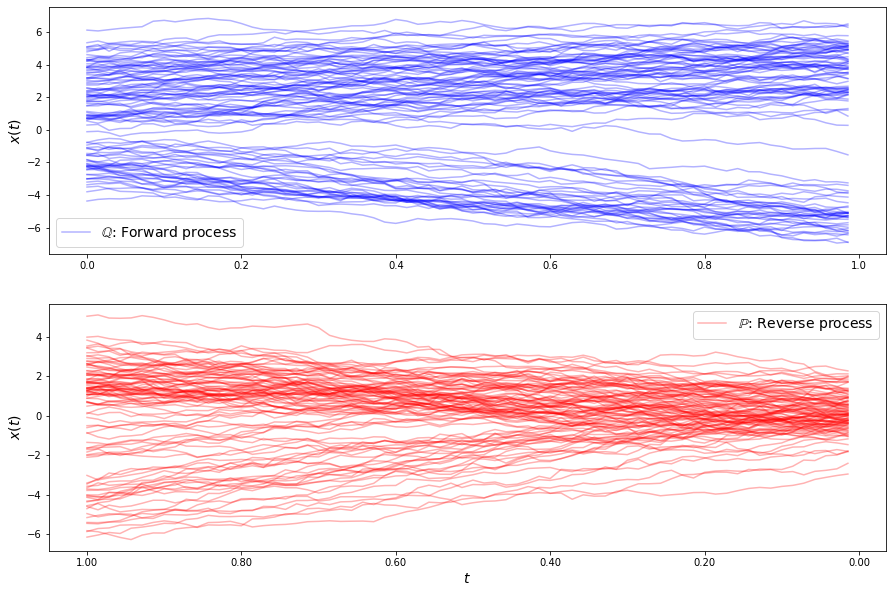

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


270051.245637777
272400.6211388621
260953.34289104855
261082.58078953676
249507.16432976216
258460.1904563118
251545.06710916833
250277.4871441943
251945.70954345324
253463.04541991718
251355.85607723525
248793.49634583318
249567.88224529373
250591.80197000873
250509.54463855433
250015.21538590844
248840.50652920216
248588.60675500942
249526.3573220583
250104.84411110845
249956.77137435458
249621.46460361098
248985.92011435717
248244.52931741657
248149.26226183958
248629.36111957824
248946.3527593643
248957.84099231428
248908.55716092972
248619.29046964928
248161.0175412459
248044.39025142702
248295.56198161002
248532.29780613858
248615.47194848827
248646.7960832282
248580.25539172633
248277.72878662255
247885.96588119905
247706.39470339526
247773.30268815396
247911.31925580054
248057.51195536152
248217.71990204544
248231.29456714005
247960.91655204463
247594.37820449378
247382.45788062204
247321.07608197496
247314.64655671013
254453.18678334018
242898.87049973308
257419.04322820142
25

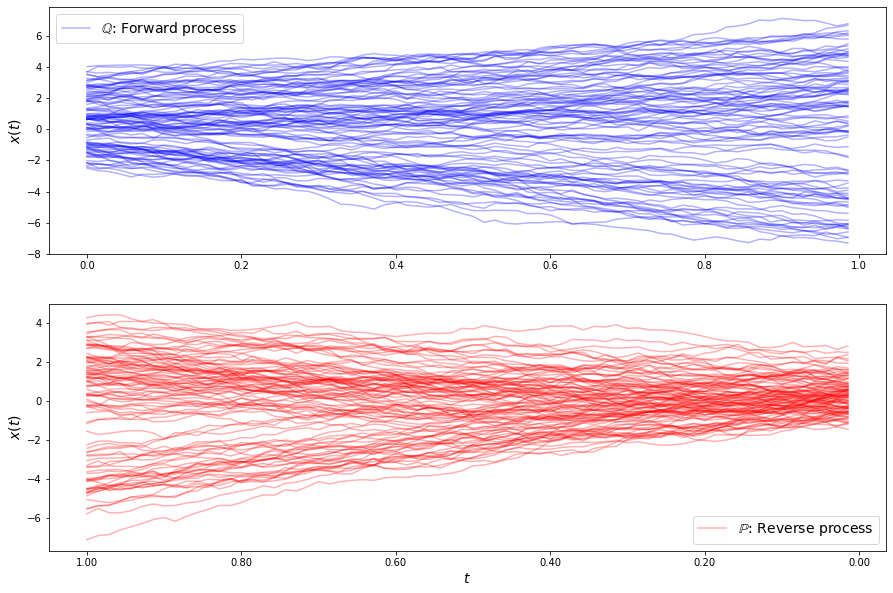

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


260419.34834732235
260691.03564321634
276606.45920257503
253395.81202663295
257513.94041538273
244891.64974250912
248183.10081861715
253156.12544345195
248816.5390379419
244366.60398220434
244986.16546063492
247279.6325450192
247575.70158537006
246052.54810479976
244437.34003816187
243844.45579655975
244470.6420254492
245472.76397868147
245281.75132910747
243913.2147239359
242945.4945205501
243112.92836748302
243975.10286559683
244655.9697010388
244540.9200223496
243738.40641775163
242880.74261534246
242524.0112503685
242802.08693956322
243417.1423326598
243861.3511200315
243770.69111001593
243230.89688360578
242679.96174235828
242469.01277278052
242588.80260900373
242851.1988715515
243152.40386954742
243362.42948946962
243321.01949282782
243087.69125702232
242807.500475873
242510.8411492267
242353.70372442223
242454.07717777794
242658.55343162117
242873.8643562149
243004.81633481255
242874.12882441125
242611.91829207487
271978.0010407901
255440.53623744918
244699.15850463154
262059.85

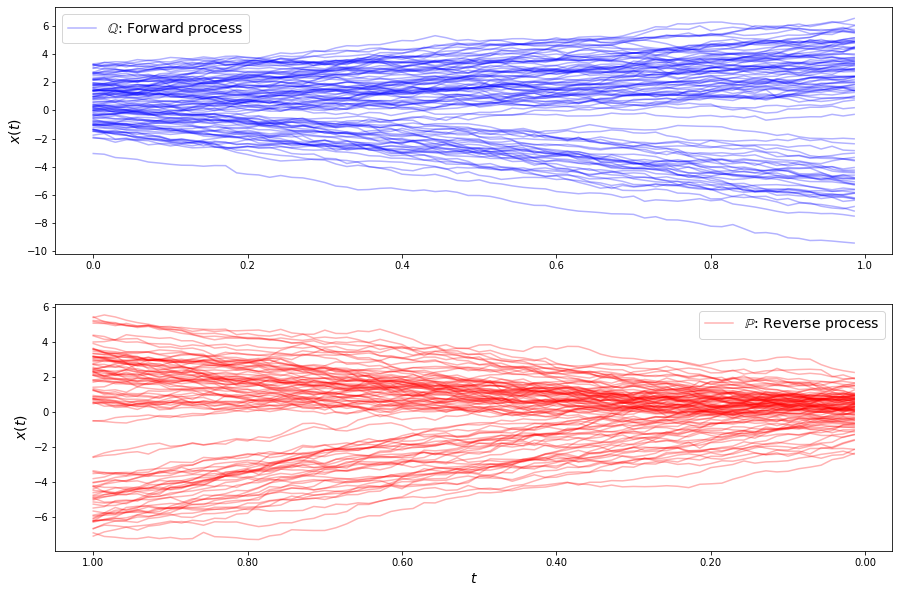

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


281589.35616509337
267295.5752588346
272846.9948746305
256588.4074728145
265028.546049822
253261.6224515781
254969.2548994361
257865.62551567057
252728.84102408477
251398.76422544208
254681.1705821277
255094.8095377051
252306.48016891076
250885.8349062239
251919.31961726627
253383.8422113863
252946.52644368634
251147.0126772828
250271.3871828965
250817.70142069322
251809.66817372103
252178.44619825127
251682.38479363054
250820.4900322681
250137.89256842295
250005.03137949074
250428.30740352592
250959.2427338325
251142.54277228127
250889.82315476344
250378.89396024024
249960.2685291248
249896.3883666847
250096.36858585654
250441.62709402177
250782.54266759552
250912.8257194757
250870.20398619573
250609.45622980312
250269.6090469328
249974.28991781353
249791.78300972172
249846.43564560922
250019.75005124763
250301.8731055545
250442.50106071777
250454.88696455327
250232.29112659392
249983.71736071026
249756.12180270278
281132.4588582349
243558.54720965805
246619.53020987398
260931.9773599

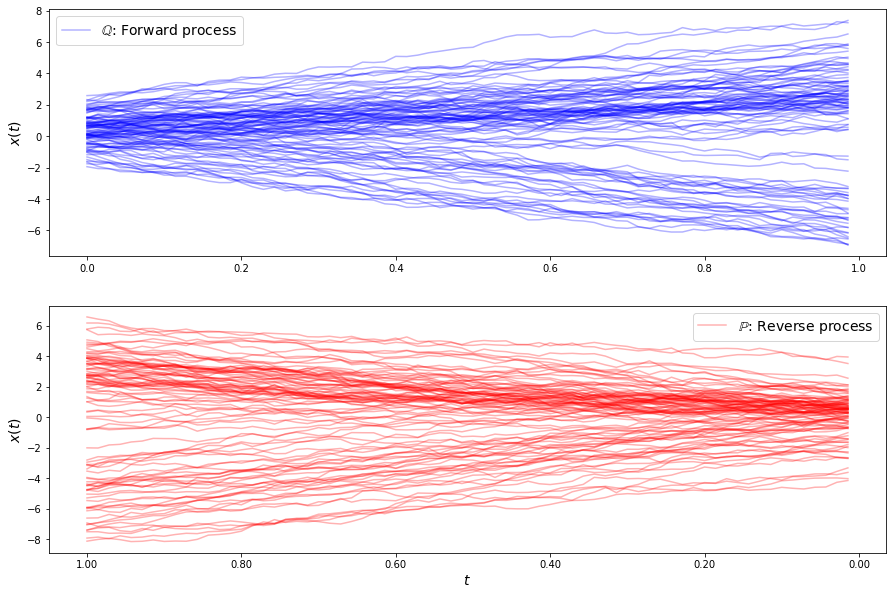

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


294891.58635814796
271896.57992985495
268187.0413453989
268652.20780479745
263657.19746385614
264676.3942374508
262197.2196898487
262605.3456296333
261448.14151989965
261326.59724633343
260471.77177240228
259785.76065987075
260785.9725080722
259357.5011853727
258945.33303748298
260296.0512454447
259059.52290750202
258020.7624496916
259238.07732660454
259556.51822373935
258151.88126788556
257865.4656151946
258894.29614336402
259027.87094460375
258118.32935689948
257771.9733523583
258155.17634558794
258443.11769905908
258379.23194515076
258075.10625246225
257688.00700444635
257584.0575309984
257912.5646595591
258216.4755197413
258013.09570195456
257501.58094538713
257279.60226929298
257545.572833543
257924.79695515562
257977.93223195287
257678.26409788016
257342.22039725696
257221.1336186843
257308.04038964468
257442.7351281811
257490.09602760972
257408.63764181535
257228.6933962468
257034.5957007615
256926.57922166152
273726.86768012913
248545.52936993795
248625.7613648243
252651.168627

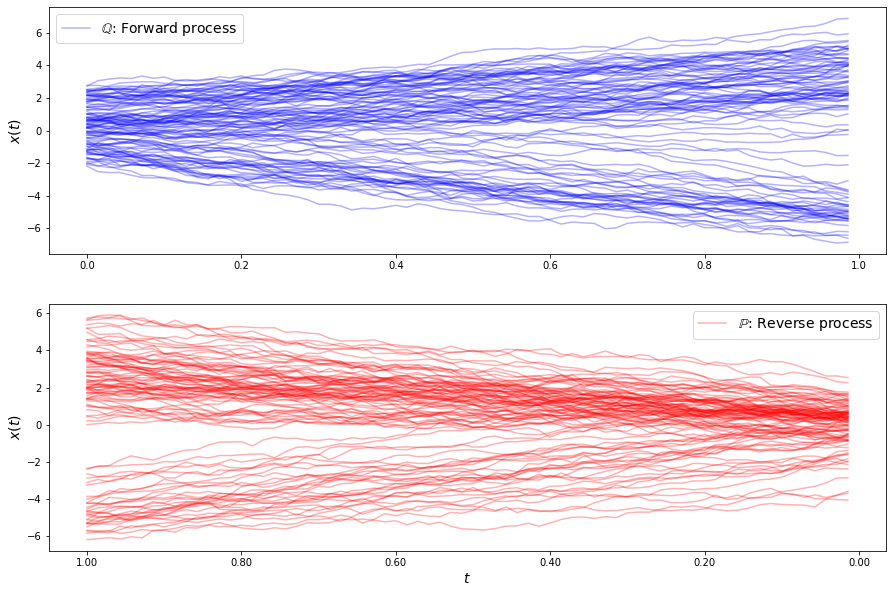

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


275927.3175819622
282967.7851282816
258155.00527714365
272578.3878903217
255769.8931262847
259083.4479478352
261429.39483539635
256314.25810796005
255143.87304504358
258092.3091759141
259029.222633203
257185.08900740911
255087.57003931986
254348.34433796105
255443.12983676238
256570.53677965546
256161.59841271598
255082.06731838512
254330.93351941812
254356.2819151404
255111.1804056357
255829.06056761445
255853.2592899137
255327.45325926953
254640.45528147588
254066.08522004692
253914.22181140777
254292.89266864874
254785.63917188343
254884.29802357868
254576.27451799408
254128.21874934807
253744.11490530075
253612.68923594404
253828.90313910344
254225.4839816823
254471.16290364432
254373.3610032819
254003.67792818588
253561.153034085
253225.5878659421
253106.3573207145
253215.4584106432
253438.56225328
253552.29644106422
253381.2303437349
252984.76987204887
252612.69673403868
252484.2990136563
252620.25011442686
268173.11022716865
264517.6657505975
255456.59748056554
247543.3895384784

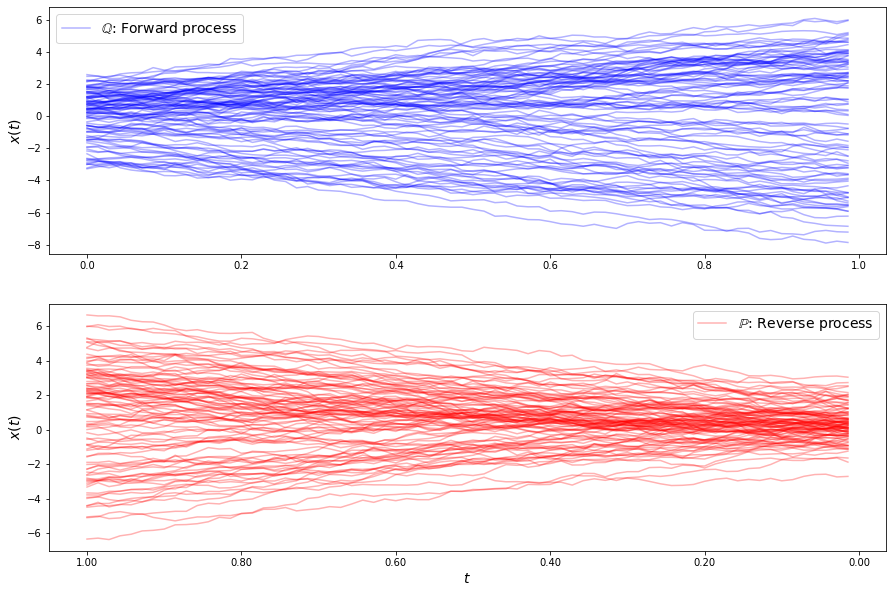

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


280229.9638579588
273522.39497286524
272159.7732642185
267971.1613312098
260917.3373693736
264413.55789543426
259099.8799197573
262560.2743010741
259954.20488255564
257981.24382555962
260473.52105442804
259603.37055679865
257591.0362007505
258338.26537625538
259557.54891015287
258916.9090841518
257498.57659907584
257187.6537627708
257946.58969071833
258447.0192150065
258012.37216394892
257252.55667352976
257025.57719263734
257456.1036627427
258031.30709926467
258187.40705721246
257767.50395187066
257106.0128254861
256705.9916394336
256820.2741280062
257270.7838430778
257615.2573527643
257542.34722979597
257143.13843577277
256760.99201348424
256648.7288236253
256818.36695759883
257116.60236641933
257359.66165466147
257426.01598760276
257288.55960720143
257007.724636529
256702.93141737825
256507.51491461584
256507.65353969863
256689.7719391198
256932.52922070835
257070.71654100847
257007.31157726276
256785.3364661534
268644.98340854456
259543.80862587667
258339.2484253102
242031.50173651

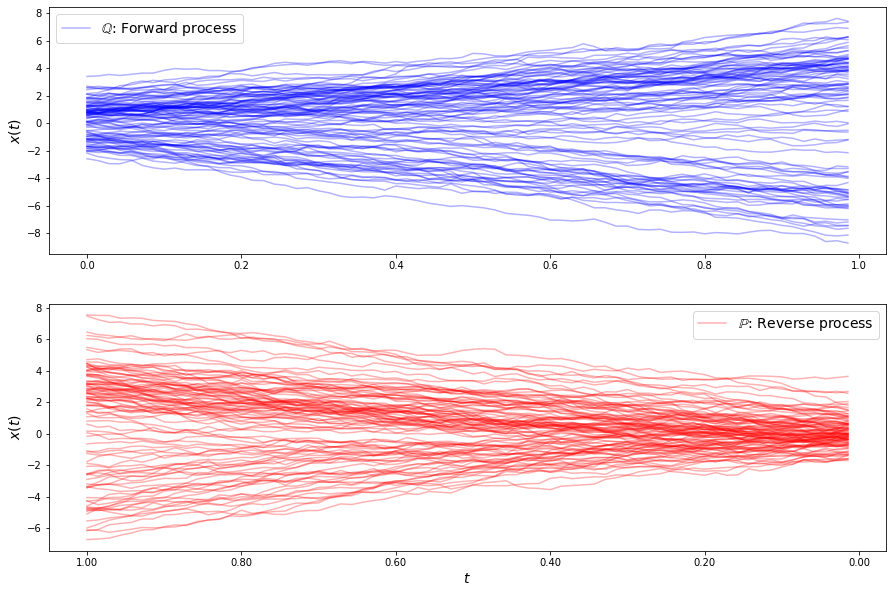

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


301371.7167296611
269128.57095030847
269233.34652555734
267666.33435569715
267227.50840623106
263306.85331668647
266108.5947988149
262014.0333113739
262315.5170047843
264272.1630805052
260555.47768489915
261550.2043924074
262314.32350145816
261865.59538976572
259923.49472061353
261005.9417710452
261517.62914457335
261242.51496097536
260392.74032715295
260059.81190408484
260825.36225277177
260518.82043488158
260395.76425020228
259781.90366582086
260183.35294184412
260428.9856738632
260369.68020554906
260177.25740151145
259542.55673864455
259787.4306988373
259765.01539200876
260287.25904981574
260196.28236629363
259878.33204021497
259649.4442720752
259300.9960277142
259659.41901996333
259606.43066967162
259839.12541298528
259598.61272059006
259254.7495206853
259176.94280433367
258976.21523863243
259292.57278082165
259255.38376668343
259092.1862287724
258983.09495158686
258705.8207315726
258969.0548966541
258988.23600972735
296202.93323610106
266542.73523939913
252990.3496116206
262706.17

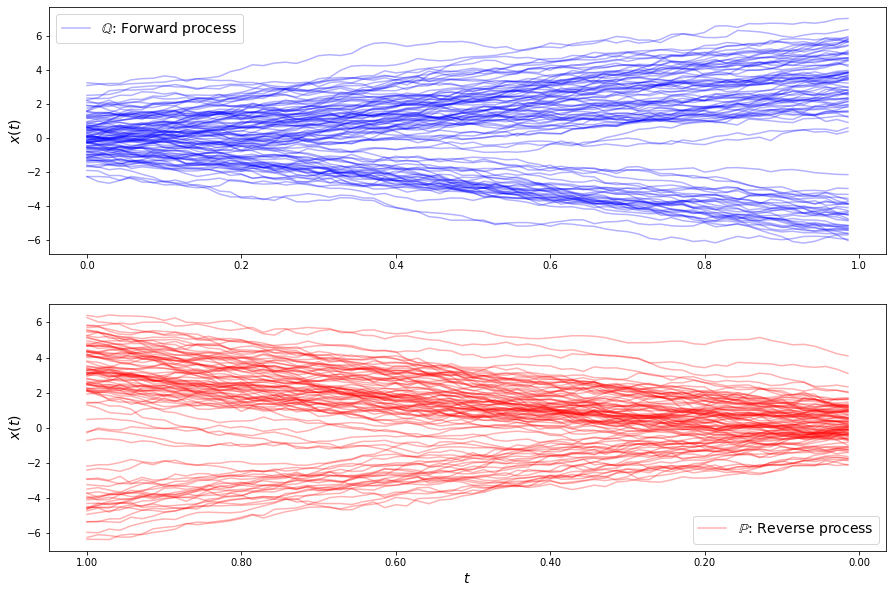

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


281634.20404553006
283703.3646129323
267565.41744511604
273158.2697599681
264348.72679045366
259238.17512305983
266777.69699241786
260377.37956834928
258081.98098996718
260949.8864429245
261757.193981209
260192.6962288162
258255.07338868116
257373.94978056866
258312.184822742
259647.98189800035
259003.91051426518
257125.04585985487
256314.5041235915
256841.3749832782
257616.69381048315
257913.82062185183
257686.8707883148
257065.14930157736
256239.03097512433
255652.43339862488
255759.23473511054
256433.3052004091
256937.74538081913
256726.5314616785
256047.3186603784
255466.94988937586
255251.58143119022
255372.85726131347
255708.46072193125
256080.4846324742
256251.98197944387
256043.99103295573
255509.58480429195
254952.83355636257
254713.0969307696
254893.45771520777
255278.37270960672
255514.72474522924
255403.79800277157
255029.56459648453
254634.4667279949
254432.98935145084
254512.62904646416
254792.4629209131
254021.6573163353
275672.98054297094
270301.59870495973
253891.20357

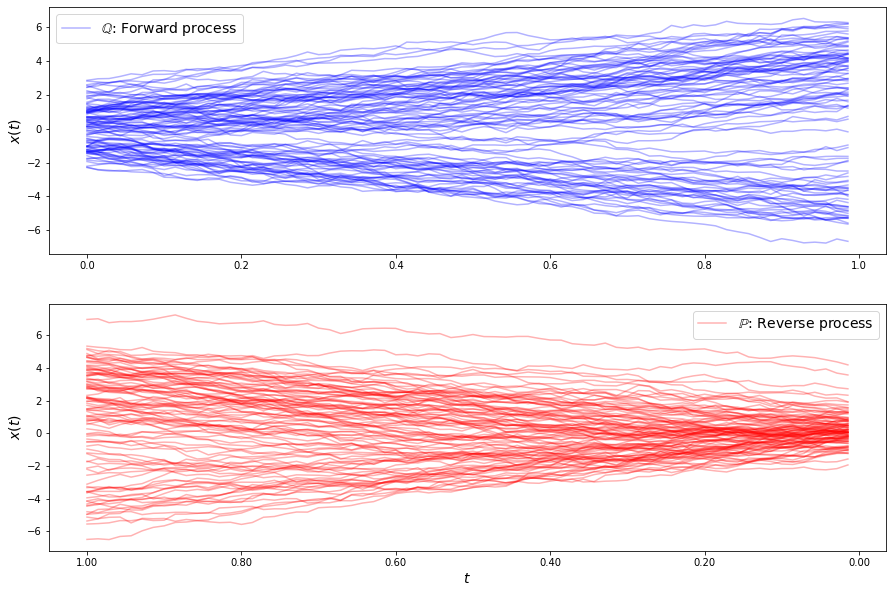

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


275282.8570274176
279446.2887604318
310351.41632538405
260808.29702416898
270386.73610919237
254017.70772459335
251480.4728354349
258466.80058358028
257242.29947789854
250839.6546138802
250470.490164567
255123.17316746427
255480.96022903934
250872.90745898883
248754.61212680332
250609.28580293249
252213.23685157628
251489.39358761167
249772.84898199423
248503.74778652308
248201.84827857715
249188.3068863399
250577.76986956078
250440.59473296153
248698.1558284044
247408.76265872672
247533.441684568
248129.369066693
248528.04834972805
248925.9845361841
249020.96371489583
248225.32454271865
247100.2215820118
246849.56868037838
247449.8548206167
247861.81420653648
247884.77468416683
248128.19826400877
248437.4862564939
248118.06249033654
247328.43675936738
246899.76490311784
246964.8017694034
246928.89645263745
246702.50720133499
246812.82762956055
247284.46327067225
247517.44179808715
247233.0060169053
246870.65374595553
284670.5724322956
256293.9442120284
261495.8662997019
252420.6078047

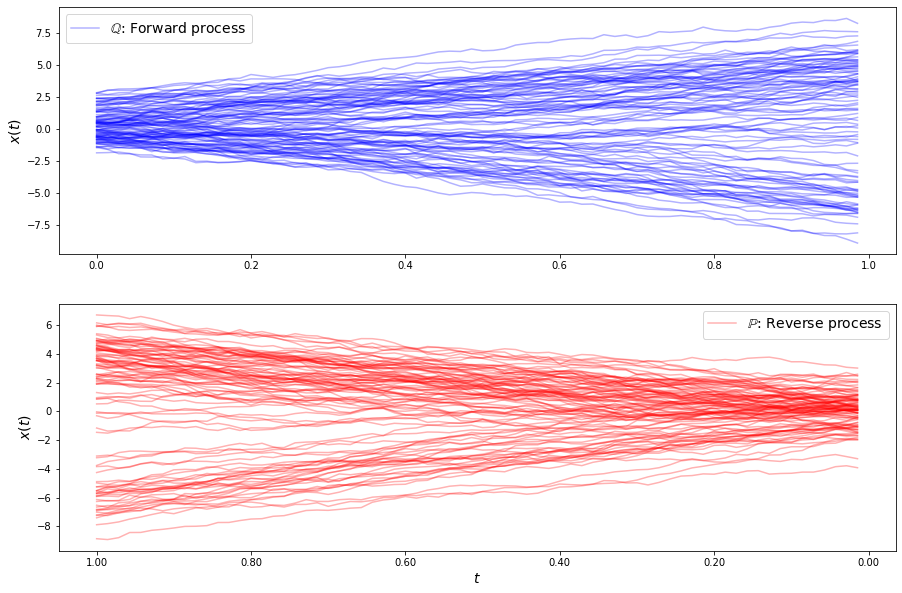

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


301272.2632525725
261498.99813940417
267382.8278190633
265720.6018114084
265472.2743611685
258726.0887214563
264960.12015187705
257037.05128738243
261453.12352972617
260101.72890074752
256705.8705205171
259090.86574544513
259174.91896630666
256513.42055290152
257090.90760245206
258819.70840489198
257563.78959729837
255804.50057533698
256600.86727443157
257784.72221756898
256816.4924998236
255697.94103625178
256208.76806292962
257163.96171888907
256943.00590751815
255845.351981958
255361.92829287925
255966.08269978812
256653.5206569985
256428.74725389166
255668.10719397425
255359.42489343995
255721.20867546712
256179.52441127668
256160.95849403384
255666.10488396903
255184.54429445026
255164.98922281514
255583.0464314841
255963.0111706688
255867.34330316924
255394.8115817298
255025.29913397765
255052.71644822214
255357.92746194627
255608.4369399816
255559.87772380447
255240.54988572036
254917.4482146816
254865.91318518674
297059.74698579503
250440.14286885085
269139.1621115565
272834.29

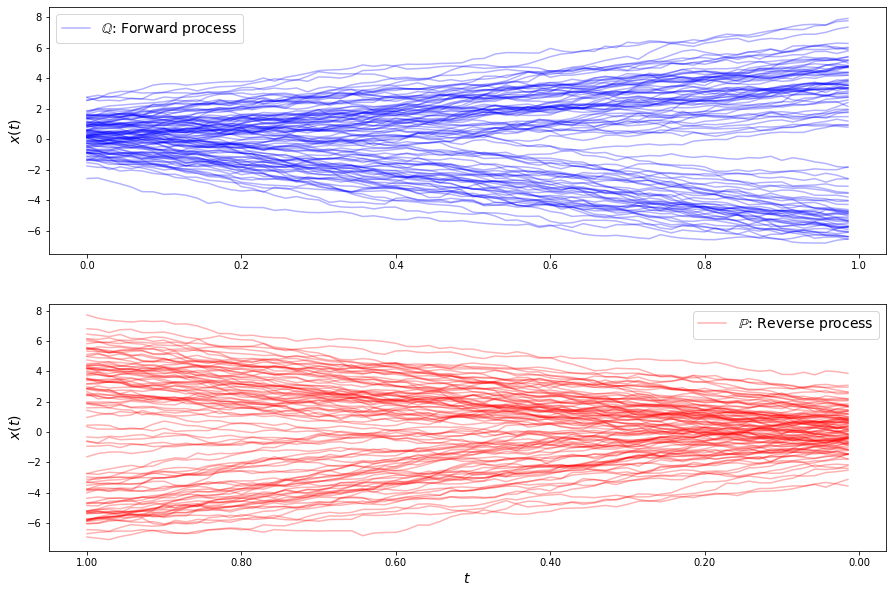

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


273388.8530928178
274869.93492422265
266672.70050185476
268996.2759237709
253285.3106834255
264343.6371458135
254658.18865351606
253674.78740802952
257645.80618055398
256849.95796371694
253912.32014889538
252225.02519106749
253471.14231923467
255348.4128211409
254015.48681259717
251831.27770970532
251689.95520987117
252624.11830865603
253293.10871729077
253401.48200672015
252853.32992508914
251777.5488844763
250939.90417133557
251046.10720171017
251808.8110832745
252281.9555870266
252048.1557809309
251423.71453577647
250792.3839915091
250408.52235164156
250435.71465651298
250821.768238668
251274.76695875166
251444.6480101811
251164.95976656835
250567.1644057391
249973.57449822064
249665.93744257354
249713.50501006472
249960.3339225677
250152.63203625605
250105.86250212876
249796.1851774514
249349.14768459002
248970.72385650568
248837.80714430052
248986.67111290334
249271.54673157743
249439.8882483747
249302.16175921325
262378.6008900408
270725.0904024652
283686.1033995339
250032.399743

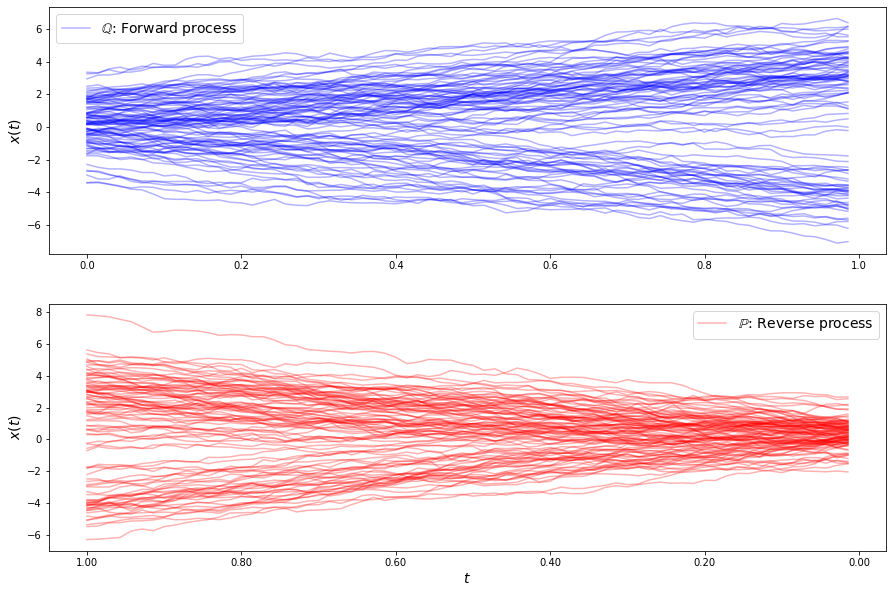

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


287065.5329588439
267646.95200839336
276126.8824555585
261736.65997471835
266308.4130151405
258578.79438112606
258307.83479599367
259639.40335520633
257902.4700010271
254390.60002672081
257744.66186949954
258913.11481587752
255643.94374788099
254848.685806458
255617.25658417935
256274.18898908
256370.59387665227
255139.1943691298
254001.7273803032
254435.05895018126
255739.38255108622
256112.63818464678
255024.07064826583
253800.00238230763
253574.98567726306
254178.13459101456
254803.00122713626
254924.11261572043
254548.15426244255
253936.5321106799
253458.50137065168
253505.66901263726
254079.95183707145
254647.30523432675
254722.314982868
254427.06353046492
254103.49780603015
253800.0406729672
253497.80028118112
253420.71824886845
253749.12167711364
254208.4753144951
254311.76702125522
254009.2005754814
253675.1418167545
253515.1128329751
253443.73005206458
253445.93727962492
253655.2859704704
254001.87369702721
280750.8939746469
263591.9090404996
255896.89324140424
250450.97458943

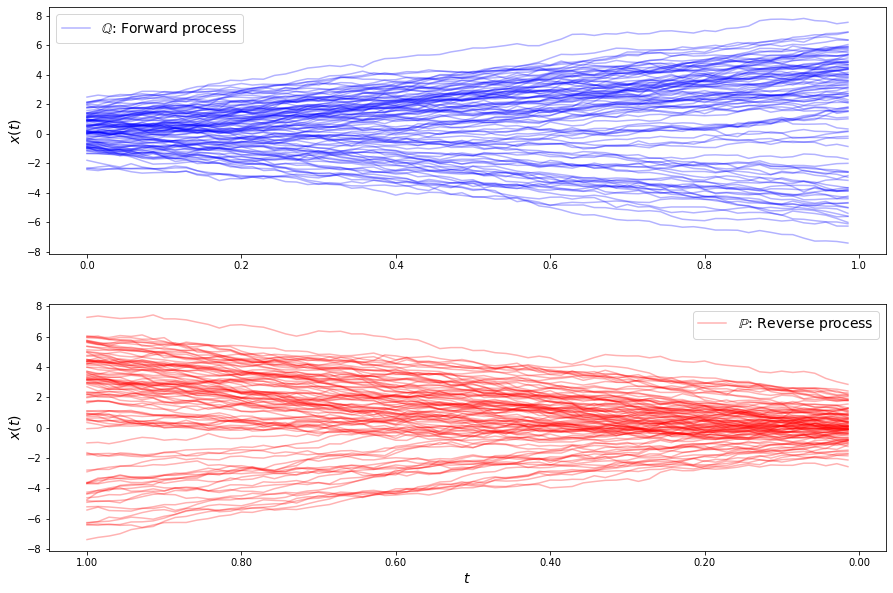

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


295336.51046825625
257227.00621843897
256449.31227430745
254552.96371005566
253296.25784925406
251108.49267249333
251345.85493819707
249217.77740817965
251370.99648654799
246363.31534490848
250240.6448339413
247348.16569167067
246839.12555369837
249287.5000916607
246862.20765433204
246104.65104790797
247740.1088498141
247012.04971570577
245748.4573355702
246424.81573541492
247333.85810031026
246854.86333386123
245880.9099469457
245730.63536866946
246261.44283390837
246503.56583835836
246102.2726473997
245614.853237205
245603.2829207264
246016.56137548597
246389.39305105506
246312.3113798601
245798.65881274128
245295.595276464
245230.40270924132
245566.62051484105
245886.10170040393
245865.25037449112
245582.91960056592
245343.05814936315
245318.71212128314
245462.0159209082
245652.33441885427
245786.06731731424
245765.75156970497
245555.46220706066
245277.1810388027
245149.73774150386
245273.34103764023
245520.94118884258
287234.7181338134
280305.80349189555
257085.01805911685
265710.6

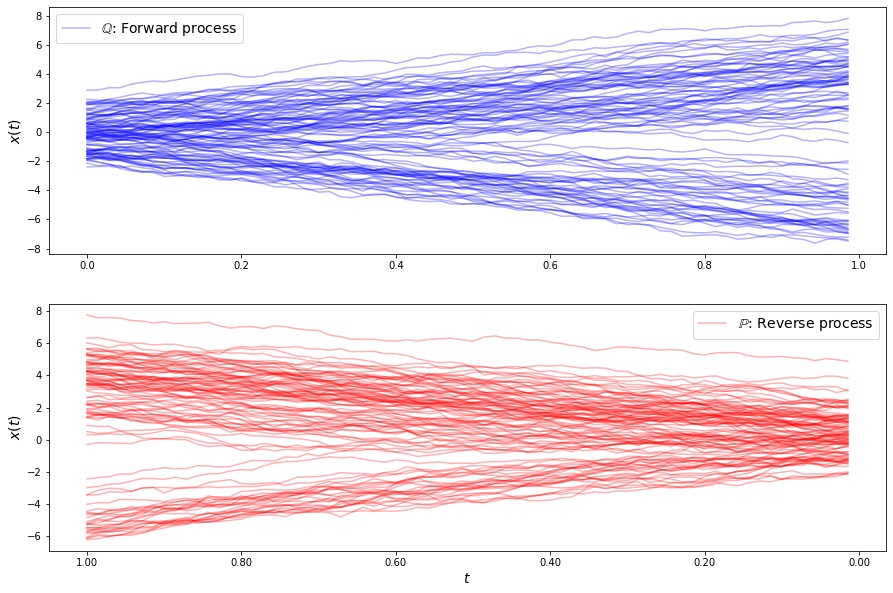

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


285526.74513090204
275322.7317067472
265344.26483331865
263583.81247983826
259308.9604504375
256746.97545435932
259355.86252161858
254994.92574180962
255715.7489761126
257259.82878206557
254288.1841385866
253049.28749838026
255091.44395648155
254896.90086748175
252723.15191597393
252759.46494006275
254521.04495250175
254187.4427972691
252135.69615738472
251803.62739201664
253210.6970005301
253793.06890436233
252706.50616644125
251660.5663359088
251923.66950087115
252788.45502571837
253072.2995442949
252568.48920471894
251816.1327326717
251461.99538036506
251810.7856331985
252465.63535724825
252587.7497603855
251964.510644633
251325.06711550787
251276.30294470166
251726.05650874303
252193.35536841297
252283.7182309305
251949.62046387495
251459.52615527395
251159.63727761514
251224.6849345142
251553.68157719134
251845.21989000877
251831.38699278148
251503.9660996105
251100.20627320564
250891.5973843705
250995.5679843532
280577.07093785796
255318.9650380025
249728.8411049823
244761.070784

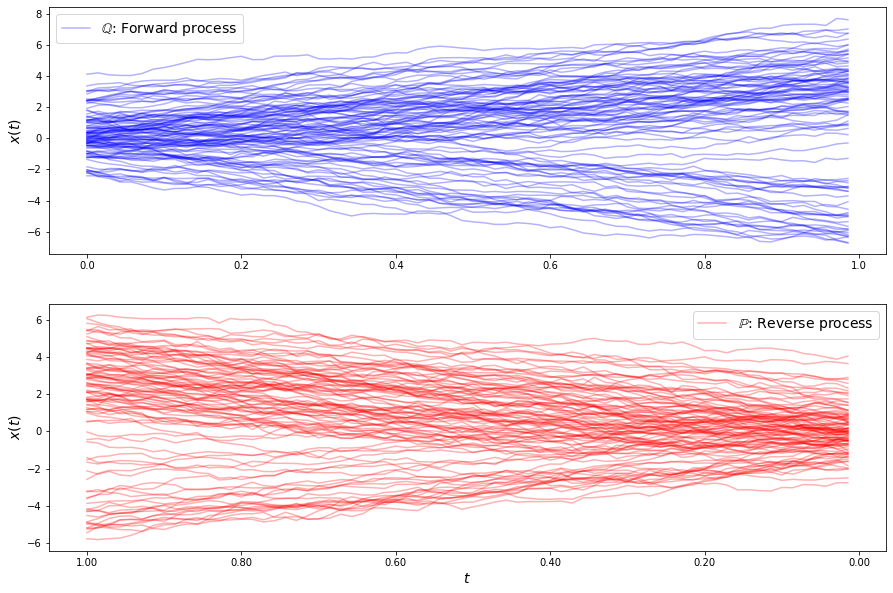

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


291368.20577983843
262208.2963909767
264099.2615269334
268602.98222692095
257322.43701717362
261871.80611599056
256871.6555873407
256866.7455204021
258842.99593052873
255035.76321738513
255455.67069664004
257013.0924349454
254811.9838595151
254087.93038728426
255454.30721456642
255427.83221156913
254039.60200633586
253660.62881528417
254471.95830277697
254629.90961483063
253791.2925462413
253332.67677739076
253644.3267696611
254032.0167974487
253841.10274456703
253257.27391348715
252875.05067205316
252982.5063055014
253394.0661176974
253821.5292252534
254621.20916920467
256614.6963223024
256996.93828080164
253383.6767799352
253926.17726547737
255739.02641746018
253077.77025363006
255043.008313037
252942.51571004375
254013.53666598763
252711.9514531428
253917.38244975565
252701.00055622676
254182.3361706802
252624.83360452764
253581.53620024136
252698.73645086115
252406.8582412319
253154.42592494708
252245.07947085163
268764.73593257344
288025.17217930406
254629.31364540703
267747.69687

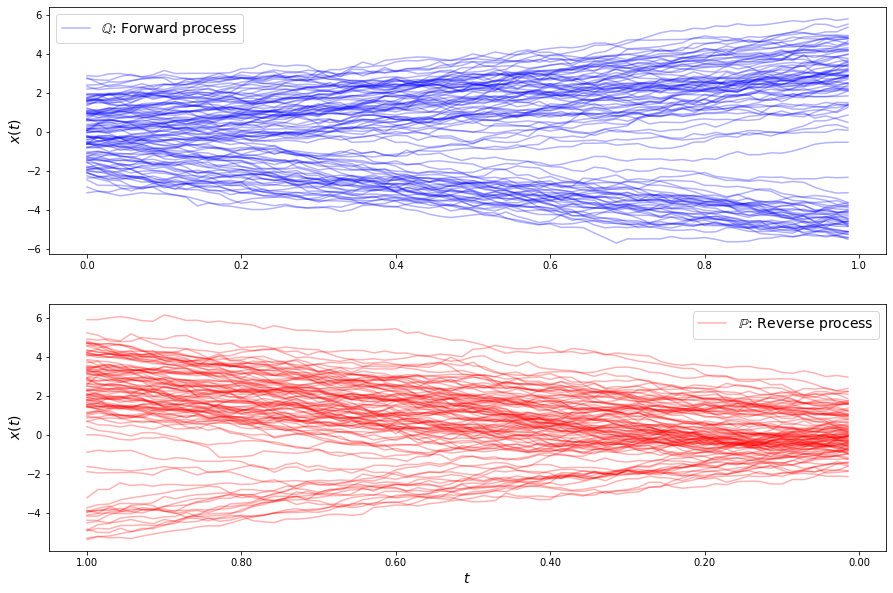

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


267749.0008505398
279367.4527707263
261209.9039516783
268170.38732251176
256629.42937934896
249730.07802970574
255381.87784585328
253892.5588512057
249543.9493417394
250383.35928424355
252475.61118977884
252969.1723219079
250921.7747728814
248413.3601710947
248230.1944599037
249624.54404425347
250058.97512593295
249179.58764753258
247859.99113230308
246959.3226619931
247153.16745279776
248010.9930125001
248451.63985067193
248040.46637409145
247167.16614588915
246286.06632363115
245792.0315119743
245993.582428017
246573.09709756947
246734.45299464243
246222.2260680666
245536.412529159
245150.22718171397
245221.11974598657
245672.90808563086
246080.0588018121
245916.02704966554
245282.18655163748
244822.81135665707
244819.2810581052
245065.35419521522
245361.99487138935
245484.34279869462
245163.0842125531
244551.88154855103
244146.3883980472
244171.9971522944
244472.64437830047
244734.67647769355
244655.01596168792
265419.43008992553
280647.16477931075
268655.56768441835
251738.99665640

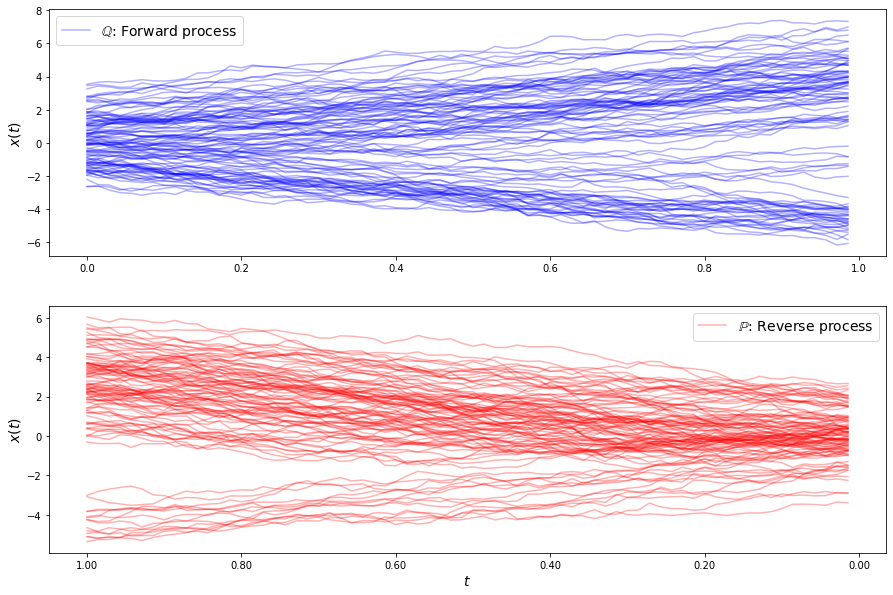

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


296915.0128839846
270544.29050320503
268681.1063837249
274330.56290104205
260924.2351745211
267308.03895094874
261087.59784271056
260839.1236894266
263243.3062808576
259190.80375547183
259033.34047085006
260867.77376589557
259333.52088679918
257638.73561867827
258414.5929687863
259456.99605261
258264.65745222307
256921.6759470033
257280.47534135735
258001.42076451614
257727.32484494895
256748.74058978067
256331.0074395379
256892.6420860235
257436.49831534244
257036.56975159672
256210.82105767267
255934.59780349076
256289.49161685884
256643.2379942382
256556.61858101332
256156.7741015365
255788.39989369153
255673.05800011134
255852.06545592204
256146.7927118159
256225.79349572753
255946.9778482715
255503.81696829948
255276.6689923964
255376.45177817886
255557.66919126507
255513.73256592223
255169.5866416031
254873.3128203477
254925.5813059402
255158.09571399874
255102.00130850455
254689.61228824913
254454.8058302016
279468.84505491547
276270.03026980505
255779.33990777528
259030.5028993

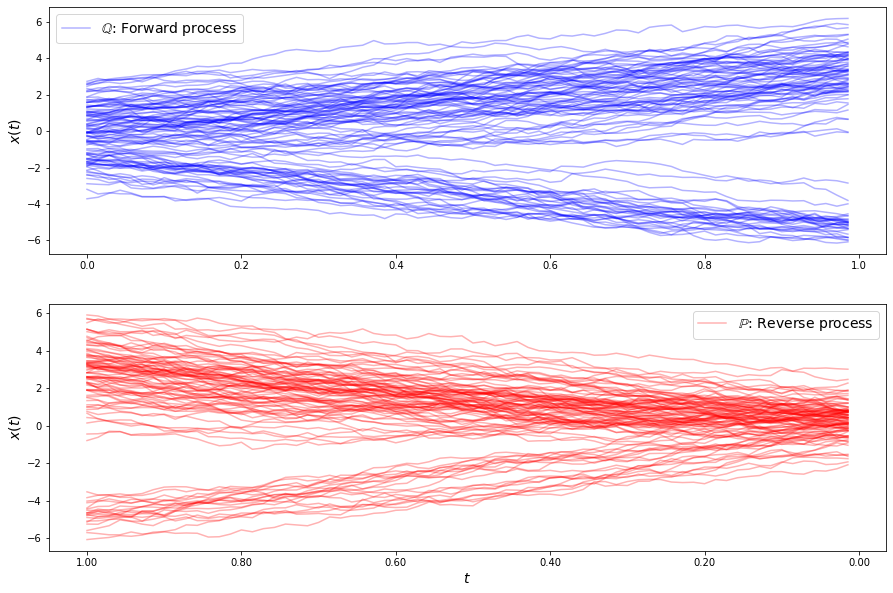

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


291691.87624337384
267271.5576342282
269256.49056312465
264303.3525771424
263376.53093623667
255782.92365888954
262421.9652212365
255579.16023127356
255552.52443091394
259036.1187207942
256202.17401231875
253316.5784642533
254752.035240444
256308.54425905662
254788.50428626168
252857.68994255317
252952.1167644087
254148.75137979328
254627.1033914091
253788.43656216108
252587.3651494137
252110.24700790708
252532.82908841292
253209.63596512616
253357.24141319873
252860.10317115166
252156.11125423881
251829.47930760798
251992.6722398835
252423.34375984833
252808.55691649823
252868.14510091703
252573.93324063162
252127.36611863013
251748.90371040703
251569.06734264683
251633.7801238543
251854.3641606172
252077.0609042235
252166.63361174654
252092.04791387223
251979.46473086468
252158.4437627289
253131.2953247554
254868.9008732911
254482.54495361244
252157.89431022876
252400.33719608356
254438.69860518494
252894.08081218612
278701.92154661287
254179.98902747006
256756.40961325122
241075.657

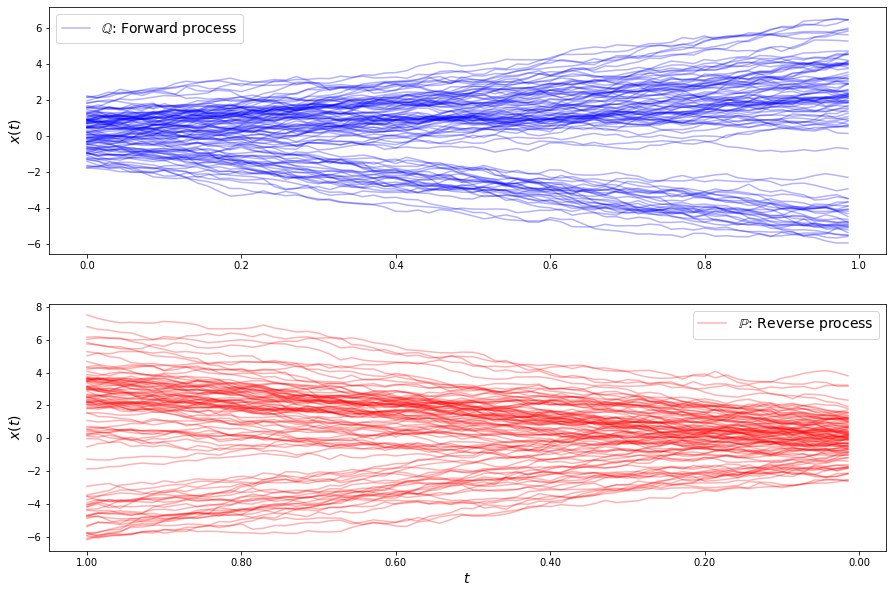

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


282520.97290881735
271013.38391412684
259775.52764966333
264297.20468946797
254507.111458699
260249.20912756163
254960.76276974543
255064.73256187135
256009.7006487868
255532.67083846708
252458.2671971934
253734.43877104233
254605.90422997213
252972.49157512037
252579.31838156568
252307.82644289773
253640.63577237463
252672.19579038402
251761.78295143897
251690.40302728035
251502.54522056377
252405.50030305894
252310.59124790813
251432.12830133154
251383.64816808383
251187.52872826648
251262.43707768177
251676.18164302586
251152.51695250662
250797.70278945344
251069.53475230894
250956.29693209525
251135.5798585008
251297.09411524402
250698.4255821576
250350.20722307023
250541.02699967165
250572.86150153546
250677.186222442
250950.56558896802
250790.67621628594
250357.4085259206
250308.73965018408
250436.1279490043
250349.3033854894
250368.991797379
250458.2835436599
250155.96915980568
249822.88330301153
249961.44540562175
284842.59736554814
249405.67197239044
264286.5364788332
243699.9

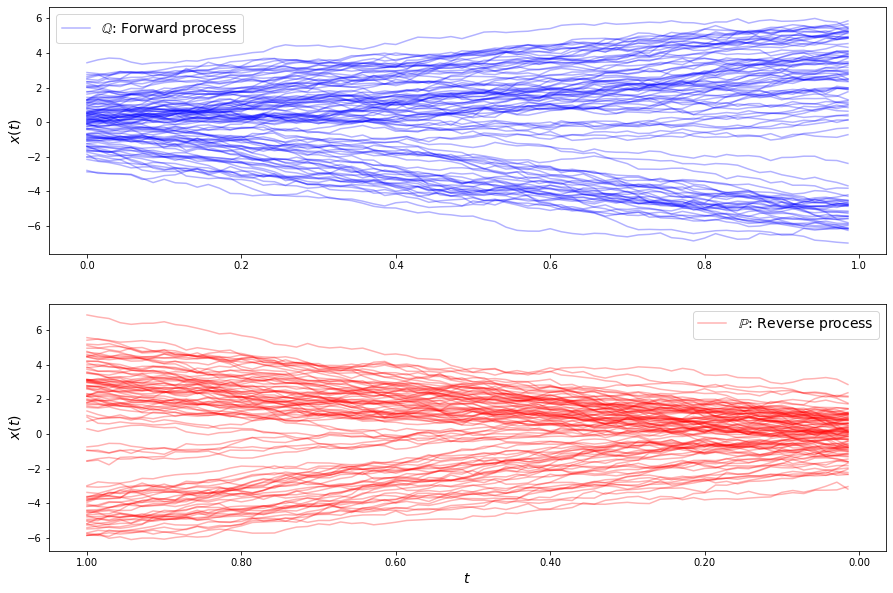

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


285496.330708102
266834.21510735154
258400.56654346435
270223.50662786595
260071.58974211162
260938.494293782
257990.06918513047
257120.4544792885
259799.3086459359
254812.99449322314
256791.70547372772
257624.39467961626
254559.571725366
255091.5797670117
256400.68289598823
255301.2170349992
254067.5654211947
254466.30948084532
255119.52638208994
254623.74085259804
253577.02737821784
253469.21205483028
254169.06463265352
254187.278311727
253321.11180170823
252834.92668360652
253208.22741252763
253677.1279947177
253407.25232932443
252646.3873208024
252417.76116223814
252984.67625919002
253336.48710714665
252831.6120779697
252250.34253791033
252344.47313931584
252840.31580699323
253005.84994323459
252555.55425522215
252031.6767723818
252112.12235506022
252630.1910301508
252760.87334084476
252278.36426045262
251851.03223319203
251967.44526158867
252360.45792014233
252500.42808821643
252248.98079265535
251902.27020240843
275461.70187277935
264697.76243428263
260579.64914626195
249745.4356

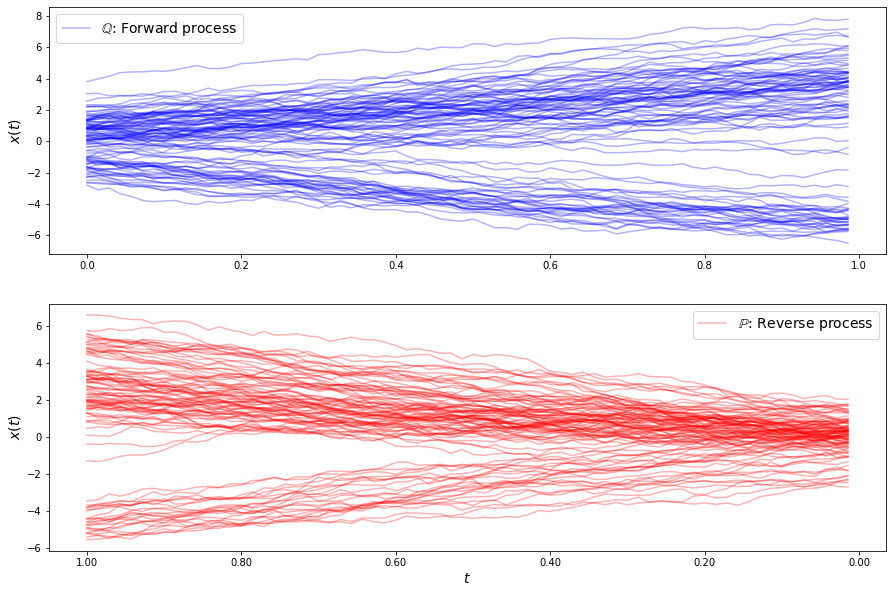

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


296189.18838377704
255471.21028607545
257874.32075631275
264135.78548892954
252457.64546315628
257117.86380597396
252713.96025683288
254327.40804464708
252692.76122832822
251703.51940216098
253195.1577642581
249751.26760378957
251446.1834297608
251652.12930901928
249511.12653609208
250672.94544052714
250566.25654202083
249782.41174558786
249158.64738844236
249561.66373863962
250352.0356602954
249181.21482858428
248580.3165727208
249179.00301203772
249183.47354953477
249160.8998767099
248836.85899761572
248259.3320169166
248611.43189114315
249055.48439539765
248790.54280307936
248609.84750720006
248269.50239059853
247858.6468735194
248181.70145017066
248477.72709447914
248187.40534867294
248093.22059063983
248016.26875390697
247859.76564545959
248066.20789390313
247957.88182389914
247533.9920746123
247741.4135540205
248018.76701549045
247878.4112162179
247865.98052487365
247679.45432494849
247364.46511855494
247636.84483414335
271554.45743245067
278593.3132813972
252361.39061868
260918.

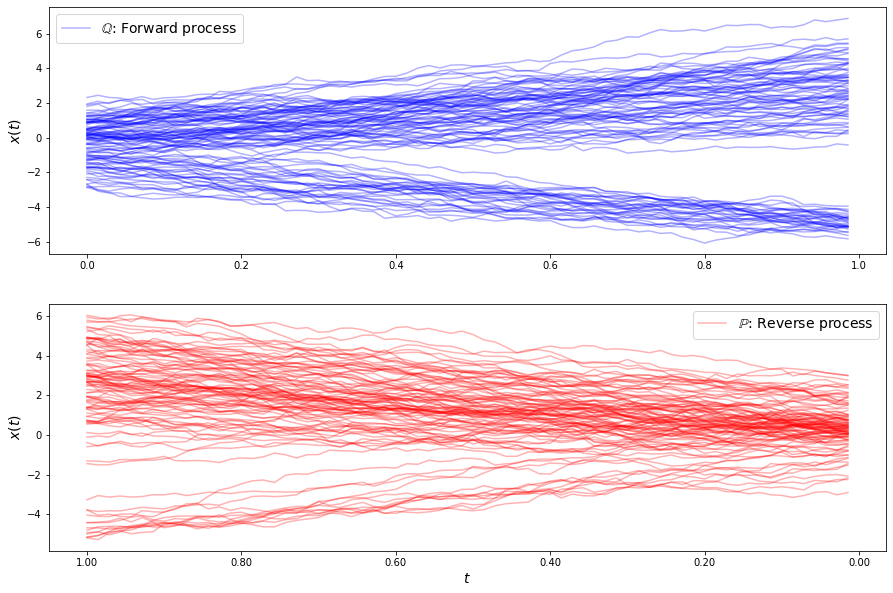

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


280862.42269775935
262063.53589094427
255108.07654081832
267204.29498058534
256907.701764538
261616.89030114078
253787.80415896088
257514.04309134424
256430.6997337372
253391.72556971907
254558.71297643613
255467.9676815844
253944.60440036707
252876.72704639484
253948.3857856635
254717.07005475782
253883.61129642796
252844.74322087644
252733.45097393435
253256.26699007073
253648.89595824998
253343.33916591608
252576.2963293029
252221.8702624048
252551.97152292824
253016.53686843297
253029.72243653488
252584.9634787294
252095.25393087245
251887.0636012743
251991.0688754018
252219.70588277784
252296.58339793576
252035.91673290057
251579.55054528842
251320.41175910624
251456.31457726518
251761.19503187665
251819.57483128904
251471.25128161925
250994.46227444772
250784.43116874777
250937.06921085328
251176.74516260112
251153.40178311965
250810.60708058474
250464.32087186695
250453.08279073602
250718.50529997193
250843.8079728178
273798.60223116924
257143.05019750068
264023.6303123726
25075

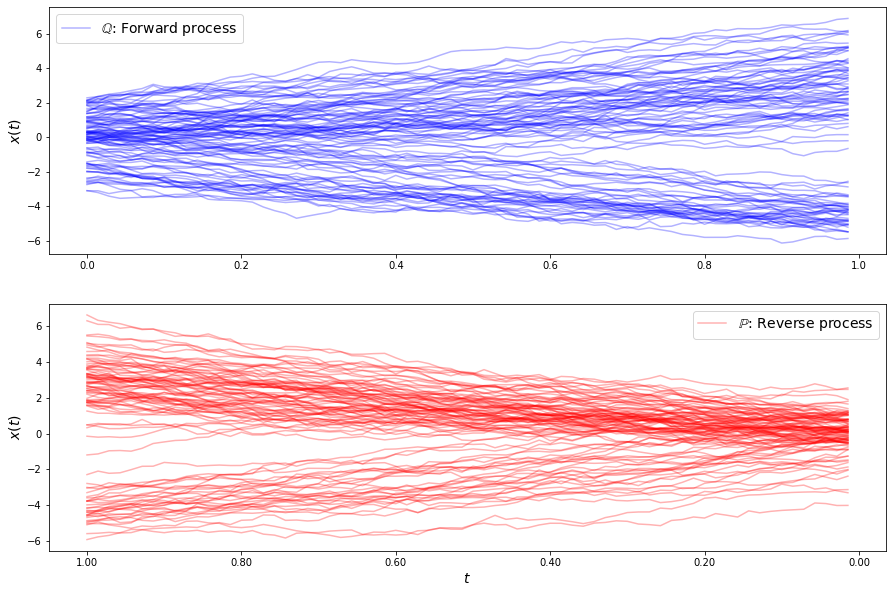

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


273611.8455933467
271422.5176044596
258713.13511041203
262712.57956207916
252525.54223294003
260273.98720875895
253782.7133396382
252872.4177403496
256127.44979299413
254638.57323650835
251706.4054815894
252394.33946696742
254197.12494444248
253159.4208930455
251393.86726114916
251538.87809534164
252698.88709547577
253086.9203102218
252280.78192410464
251177.39850273935
250793.28865926352
251326.67603640084
251940.631461452
251709.35500095753
250842.26340164107
250255.8055379924
250370.6871062681
250876.82010606967
251178.2152562312
250904.97843152928
250214.97531511565
249637.96519667294
249560.19024411528
249874.99042531935
250113.0014142152
249877.22898191895
249249.92887753565
248724.53416291633
248650.24535111658
248939.62523408045
249171.05292842304
248969.15788480424
248404.73471823367
247911.75828380635
247820.8203584485
248078.44134183953
248280.14987218543
248062.2915488928
247571.3358688912
247263.70514174883
278707.5393084794
262704.7582322312
249194.10562044915
253731.8084

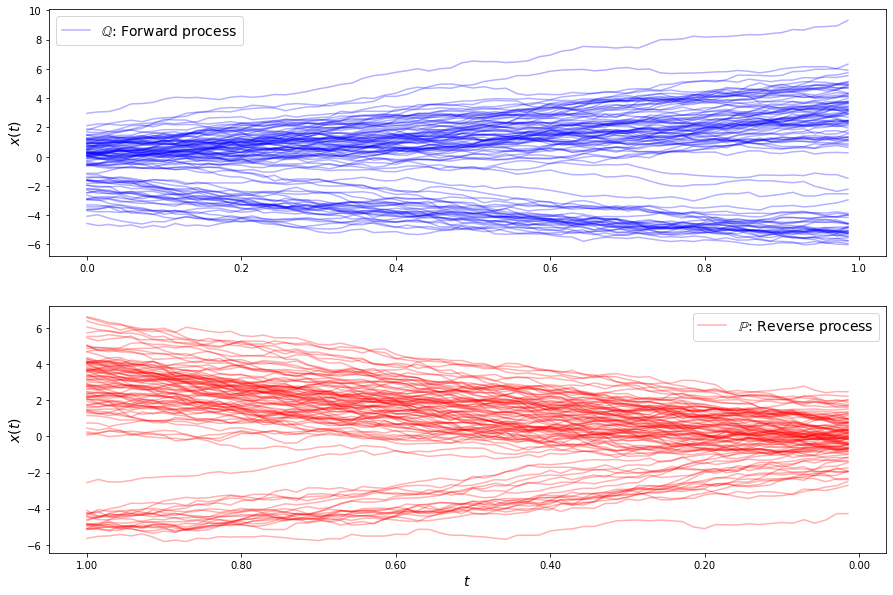

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


285437.2178329688
272816.5918976194
257989.26209153834
269145.7079229021
258350.070328499
261247.17872787215
260119.39108947292
256640.34836658635
260612.17961244233
257815.38651543268
255672.8323289756
258327.4249465929
256962.75275233106
254707.94750451786
256129.67890493575
256609.7036491483
254585.7611616252
253887.6695115015
255100.3154417493
254885.82687253715
253158.05062848164
252977.55126318397
253949.07819462282
253648.34177560208
252269.97479255634
251967.7909507905
252807.094129031
252705.9500946005
251549.31857940325
251261.66178929905
251988.46033170656
252172.92114038955
251330.52587802772
250764.51409602613
251255.93326397365
251733.2099089779
251204.5408673747
250561.7333940589
250801.8955817491
251375.58894015118
251265.03413333808
250608.74297053652
250422.5782407267
250936.8824166305
251208.94799583656
250732.5204338687
250278.7489623954
250453.49192567763
250854.43802946107
250820.9368916108
273727.3315315906
268119.50090835197
261624.58127141529
250994.14456765135

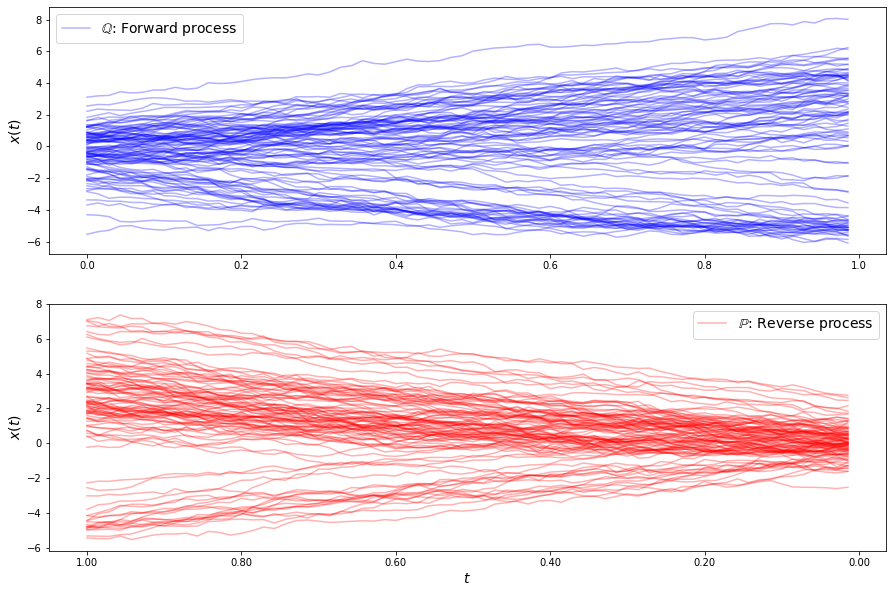

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


284557.4494922551
274424.36324637174
265495.19552210276
259960.99506551647
254927.8224828641
257276.41392570158
254198.39009320532
250346.27136386558
252571.8310106162
254764.98255687405
251574.5918450932
248524.74381021893
250120.58664256896
252347.15449071646
250668.41841317053
248231.79688900468
248090.87206815515
249440.8361364855
250356.7351806363
249680.3593492919
248011.89697015152
247135.1420288274
247677.09404262147
248568.65635625424
248723.7860443429
248139.94423750165
247315.96819251467
246719.2388910842
246751.9072014896
247358.1529691869
247859.9326342753
247842.93599150248
247525.4378153655
247031.59895966618
246453.37613409097
246230.47585489493
246506.66712772046
246900.82920136917
247140.91472675197
247177.4995108926
246884.80178422784
246376.045314704
246094.0997938287
246156.17536183924
246346.26876225218
246640.61342788558
246934.21110888195
246898.70469271153
246613.99887819652
246317.5043921035
272173.78272859904
271058.8550509381
245732.8192596432
260701.9333077

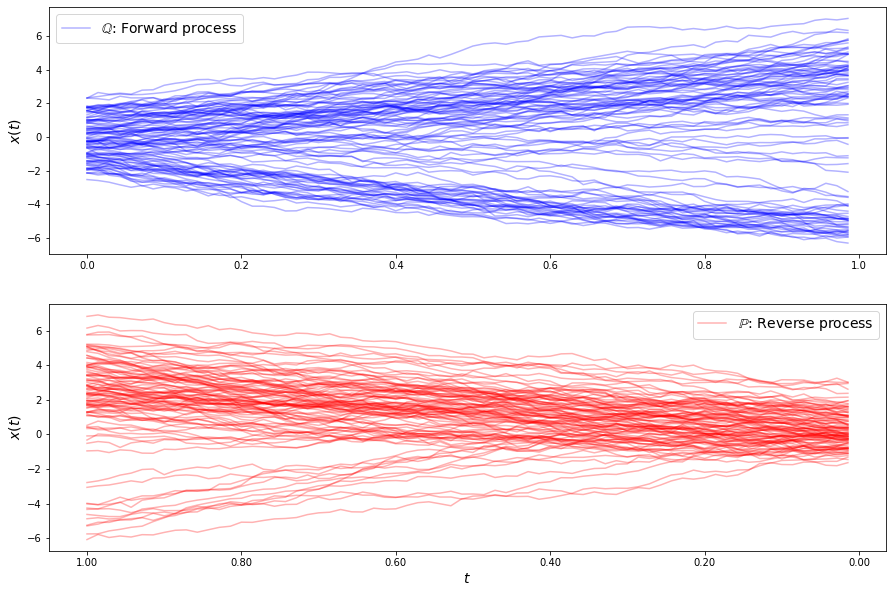

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


290210.79250486224
254113.99549907818
257736.75148515627
258082.5036039037
252463.6790069809
257075.84022592625
250940.0982454234
254744.97219292383
250815.25470432383
252214.80824305324
251764.63407591177
251049.48481828568
252036.67134184414
250333.51651084237
250569.85309439592
251552.75352236023
250569.2530025965
250153.2275705761
250787.53906007193
250553.81654575485
249707.45973408356
250061.83243525506
250604.92627387622
250334.00122731723
249759.40483438884
249731.18258308928
250102.59061597523
250004.10793322255
249712.42254012258
249574.3783006099
249801.6226505393
250063.2572367431
249810.45567394642
249445.836973681
249291.49035283853
249410.70103630406
249662.18555605353
249590.5728568652
249323.65595073713
249216.35888517625
249261.69333487796
249413.40297712878
249438.98607960372
249173.48686722468
248959.90629291465
249033.99759326293
249191.00697485456
249254.54490792786
249194.56935125915
248993.43291864468
273853.9579796497
264997.7434878773
254785.26574013114
246032

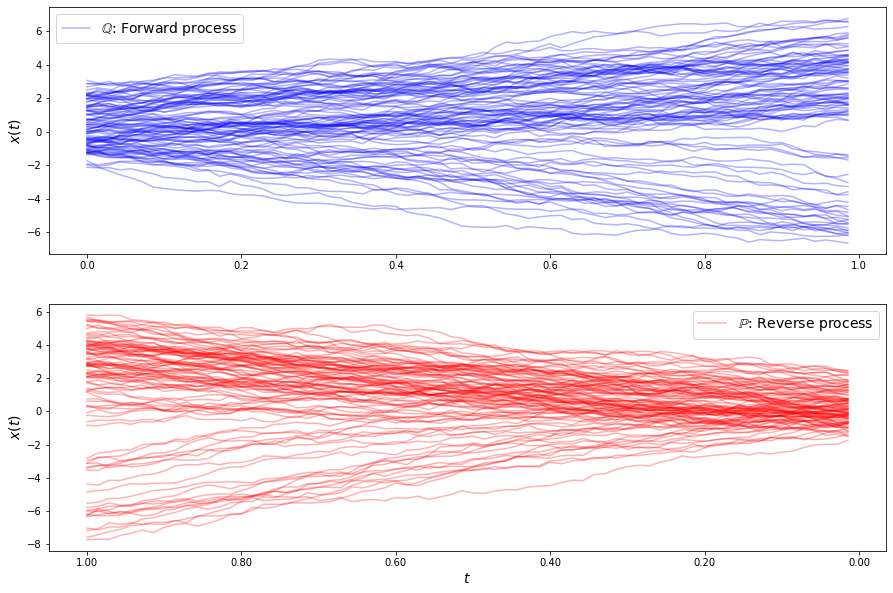

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


288246.1358402147
272193.1271135248
269565.5963232269
268849.50045776454
262758.7611734116
253567.78748909192
260876.72443364124
254523.44777001135
253668.10297838942
256930.85372501166
256758.1071979323
253154.84298091294
251986.5546978677
254044.21862614484
254861.608406018
253007.25169991446
251512.20915031256
251982.06781286307
253234.2709454111
253611.6828061191
252758.16058140201
251572.5626408751
250970.10898716073
251148.90162191744
251707.90202518663
252045.89427444706
251824.0845001202
251253.99408170793
250839.7724514628
250877.88915748044
251271.42526319186
251665.097818099
251705.35344607782
251311.78020446553
250759.64118698938
250444.40079568716
250541.06578222703
250885.18498556147
251160.75884006478
251196.5099185324
251066.21640163483
250904.03293057112
250729.44100309117
250526.60544687288
250376.14620109263
250392.31860059826
250573.9622225092
250779.90875601966
250845.70876965666
250715.49453608243
273087.7796988363
240369.2368465958
256848.26583226846
234526.46121

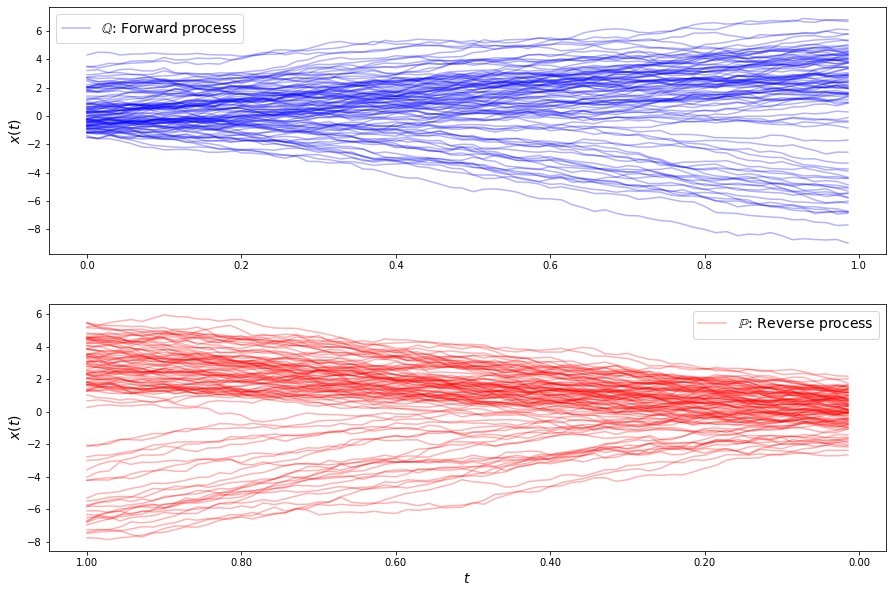

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


292411.48999272403
274407.47835917835
288788.3009440898
266053.93126126024
273249.1534205745
257180.13425229065
261676.16624673552
261187.31399369444
256881.75229892792
257883.1451119926
260574.00934665452
259005.2330085158
256011.14868939252
257185.7132442705
258778.58328858632
257135.74972099316
255692.7966818889
256377.7211938633
257343.2299028869
257730.60096084632
257223.92075665417
255744.37788800476
254924.37685452626
255724.2669149408
256599.67434907446
256280.17811098095
255619.47419493253
255234.5511086175
255042.40176448505
255391.2243754107
256025.09688853374
255961.79228133385
255316.7139141888
254949.29541769606
254897.09361957558
254922.3701670025
255226.26399308702
255683.64692450193
255637.16034041255
255077.78207317763
254660.99702170183
254570.88591470334
254601.22031240296
254794.52967090905
255206.83700668078
255465.65343375856
255238.47002353135
254797.2568454208
254527.6852921847
254429.2482583921
289097.97828162543
263743.51091858424
250459.67753872357
251767.69

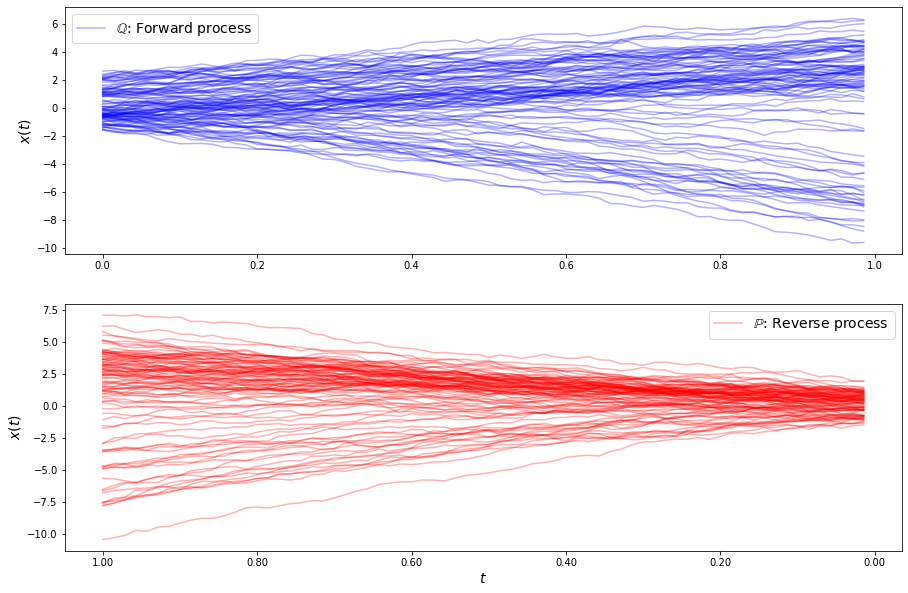

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


304931.02012639784
270952.6191010282
290486.4531369819
260534.73944873217
274442.3351771146
263319.3874146912
259549.6060777776
265510.46006471687
262722.9377725435
258453.67784379877
259739.2410404869
262469.21955127915
262328.91545421886
259776.7312578819
258137.53122440522
258534.0860096409
260234.5629291446
260568.2569644095
259451.86696080182
258068.204719059
257843.8816296786
258555.13910892507
259447.3936916456
259943.6307151552
259598.52143013114
258895.13710053204
258022.02485098946
257738.04539745592
257834.0636144954
258433.91456076302
258813.53693290957
258967.70329878223
258577.60536676075
258131.45664100102
257721.59665881732
257688.46409712272
257885.59176966955
258252.38700527314
258553.0763329458
258667.45544702123
258547.6168777216
258239.26655857934
257904.33233489466
257668.36103585246
257651.47948321427
257815.8655141983
258039.6923940388
258179.29930936202
258121.385225557
257944.26050516154
305664.0266415898
241071.52739641306
258764.9078162088
250034.84696475728

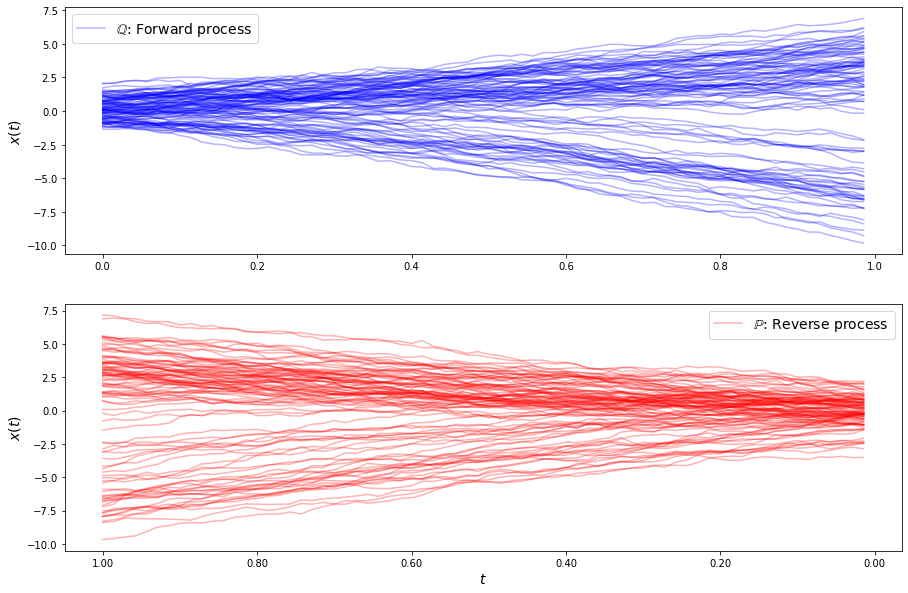

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


290585.5604255129
285983.6501576724
285438.4399543961
265753.67289684166
263232.619451224
264650.35656801943
259539.10684301017
258727.75586638006
262959.6496732047
262256.0705254906
257180.72294381715
256565.21905849833
260074.00907885013
260193.61121006144
257318.09998730003
256264.85854298115
257215.11605284366
258742.01804482294
259241.0905748154
257686.3105840029
255984.7305340307
255955.89381348313
256909.2999671423
257743.42161199462
257990.5310461841
257200.6252561045
255937.19415209856
255589.0870878909
256073.30748838926
256559.03988497128
257119.11803586804
257322.98739497268
256704.02563621907
256190.874455833
255806.57858079724
255508.90284852596
255894.13403473538
256216.5325601915
256324.6761661032
256521.5815596465
256214.21142891323
256002.2588966221
255977.45140308357
255741.78105457433
255957.97624642256
255935.26206674613
255925.42571888425
256024.67207909864
255774.64098047582
255913.2727981886
296817.58916966995
254282.81726153888
258280.02358740027
245389.7592241

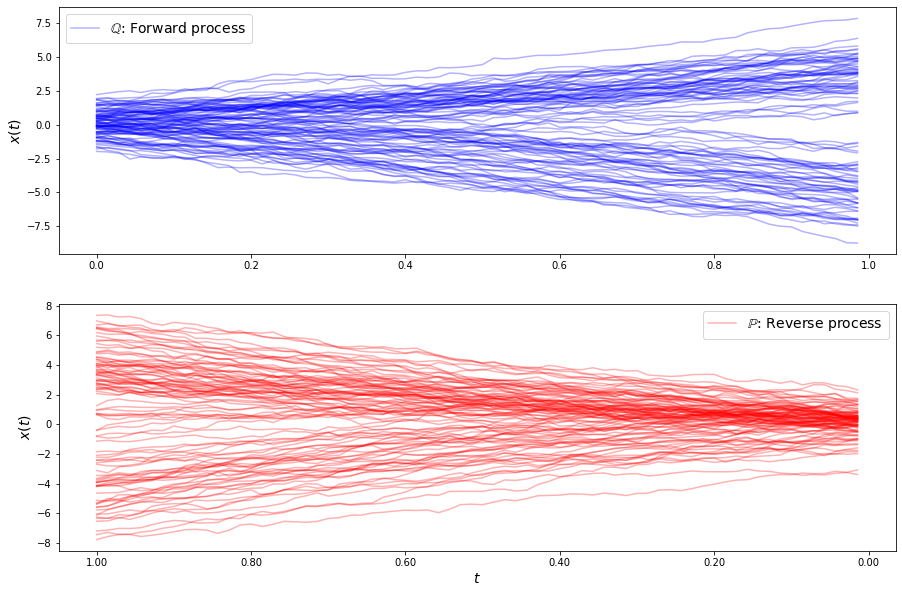

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


290336.7944029027
256203.45804385323
264118.6814811875
269892.9674026404
266860.8654161374
254441.11827592895
262801.95313253615
254217.92441419096
255197.44923983762
258758.29493354255
254834.9174266315
253154.36365800543
255243.20300361948
255389.33988170922
253597.98973453374
253188.45070219255
254023.6152697037
254569.35213184106
254260.1393145837
253536.0602331379
253021.39592476992
252937.41024067736
253201.72853639693
253559.3195015356
253546.53285119095
253041.6108681015
252553.3217265131
252555.62942659642
252995.51995477144
253447.81351976184
253503.34778859882
253079.0849853006
252476.63150133763
252125.44422798185
252224.89330455163
252598.99153036287
252891.4620159837
252895.29999855487
252675.1503162458
252393.39196780408
252161.48536838655
252073.47652514133
252196.45661808347
252468.01066183107
252698.4997218698
252724.34496780438
252551.89297506734
252330.9458416814
252178.48179826292
252073.37248721905
300129.6941703921
252909.8289810074
256806.37175563903
243752.0526

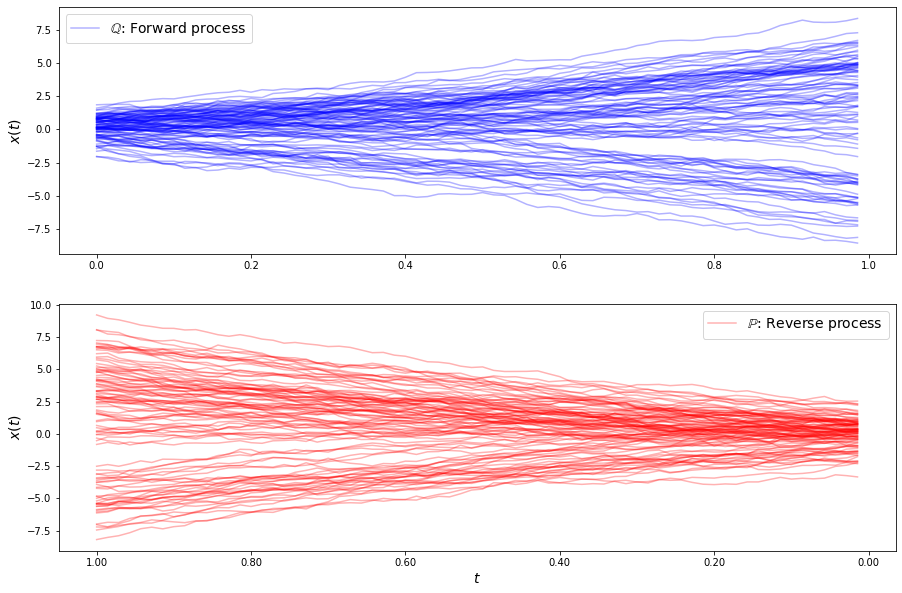

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


302664.44737225736
263492.7088225795
271841.4875637747
267651.43584722205
269114.1949125831
262481.7694445391
265871.58098344324
261063.53570518672
261814.08551253792
263590.8740149317
260536.55647554153
259031.71215409366
261797.87422321166
260820.21182564128
259474.68291844265
258594.22680957755
260048.94717014913
260316.65124697678
260070.29990165637
258641.43928214413
258508.7596816988
258436.28742236635
259366.09365715508
259133.19668817587
259078.45150544588
258180.4907015048
258271.4409039371
258198.40967771303
258784.3900598153
258928.38495108407
258942.54194715747
258701.64110583713
258164.07515833696
258073.8312511449
257779.81249980963
258198.9477767672
258198.89645592732
258486.8551855848
258216.82700131464
257995.50546675056
257782.36348488662
257603.01133708292
257886.39343349758
257900.89118166952
258262.1015996255
258140.1906690972
258064.45899726806
257800.7154102059
257469.59355779816
257504.90412876394
302338.26392801263
253337.874356043
251956.75385857627
245098.388

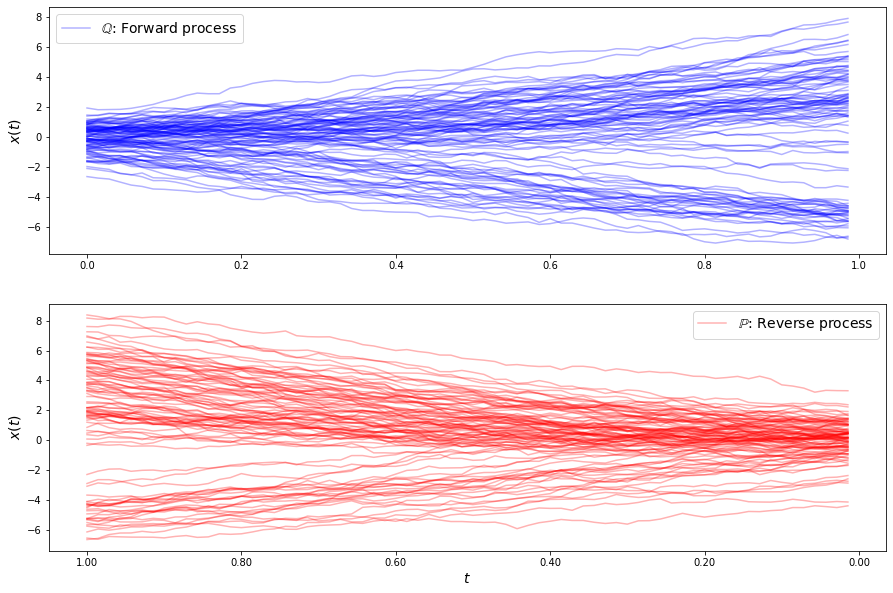

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


295719.20577766746
266225.0387923408
259823.83989514416
259448.67276930728
261803.8608560064
252665.1319976058
259010.53854271653
255337.45924707566
252458.1725389323
256127.37201524334
254449.8796847413
252739.95516511553
251862.43617131154
253579.9185603357
253447.64712473156
251994.54624056295
251397.6240369949
251386.93946194038
252370.4248049155
251871.42219428194
251703.5028874842
250447.46819445002
250875.09444201918
250683.14545316473
251420.52531650523
250815.91927882968
250558.24752440624
249938.3944183658
250095.2284973656
250202.6392510618
250605.39881575987
250477.7311459172
250273.52617399162
249701.46884310833
249496.79914833044
249336.51473193435
249658.96749244112
249715.4739955141
249786.20130633592
249419.73184719146
249345.98156569534
249131.1174822668
249242.2616650305
248938.05880922888
249000.05195801007
248800.92826995786
249175.32985736837
249013.0560523084
249158.11318166234
248634.68941288785
316148.91859560285
254924.8670673025
252658.58227201123
259673.4367

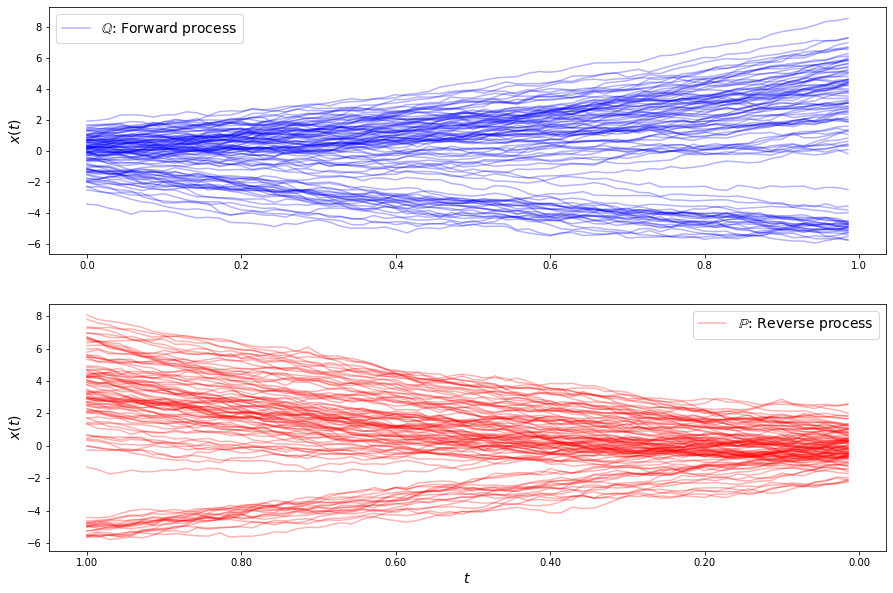

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


289152.6889509442
255913.68955096306
263357.85195722716
256057.15261404024
257272.6619025407
251372.25284697107
255532.2148479464
251591.5101832311
250822.2150245757
253291.3999693889
251645.07373643832
249563.96727489185
250568.3277164921
251286.64181134477
250467.16563038403
249578.2776126098
249187.76468572536
249949.68726804905
250401.6313431884
249955.5792955862
249454.3850445753
248777.8517606696
248811.41772177006
249154.75638808578
249144.2638400729
249168.56504754766
248766.7013196611
248483.6890564775
248631.50926962428
248542.02187058964
248636.46634657594
248611.0220056894
248371.88271921172
248464.56712543333
248372.50514259702
248178.23008609808
248105.47165161843
247826.33334484376
247737.99586077576
248054.48441128543
248172.9003035993
247958.16268348866
247747.4436849844
247569.33125912148
247442.37719195307
247531.44021136776
247512.694099568
247237.8661743978
247226.46337465162
247457.6773057065
283808.32614266395
248611.77356832352
246393.30029260443
251235.19953559

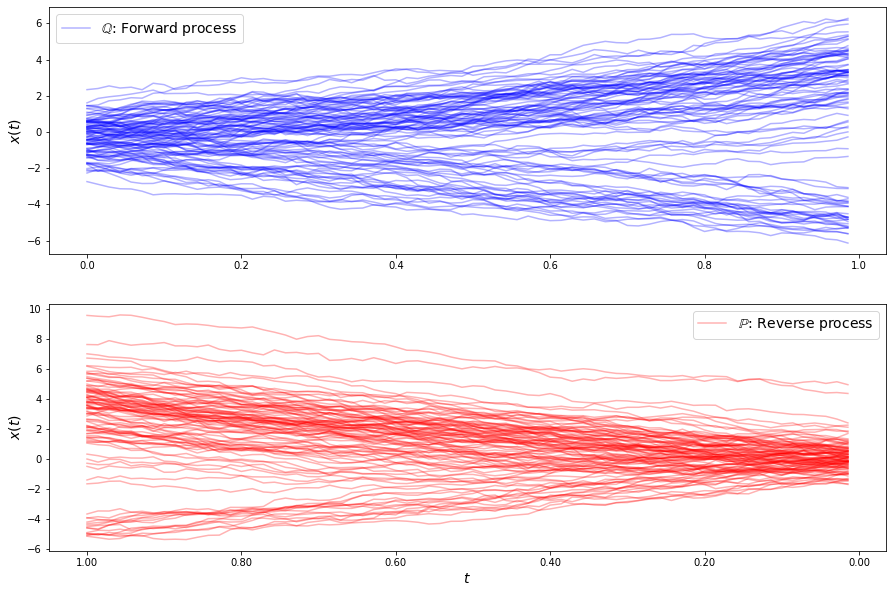

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


305768.3350075618
264155.3024199975
267541.1099394793
268836.7679898628
265944.54186717747
265271.26149046095
262470.98547976767
260606.5594431813
263168.9704772658
259176.92212004313
259710.859877186
260733.47895328404
258522.05376682186
258547.71343800938
260010.04200820997
258623.77923709244
257569.7880347026
258718.2602153414
258781.30369106794
257890.6512922907
257159.99536276382
258001.42920712312
258319.23992835754
257429.68174732322
256973.17861953576
257112.5610817023
257603.11476143688
257506.0585735297
256678.5936833037
256508.35647561649
257001.63795951032
257153.01027557586
256877.67803807673
256413.15566074985
256093.84127011214
256361.2132143343
256694.44639271335
256356.64025613948
255809.34606291808
255704.45438252413
255877.88437091265
256032.24122110987
255947.0418126535
255463.56703150942
255104.0107292683
255296.03954460716
255504.80027039992
255296.3910273383
254926.3282901409
254624.61611277403
284802.5970004446
250248.83447745332
260693.99541988788
249091.947602

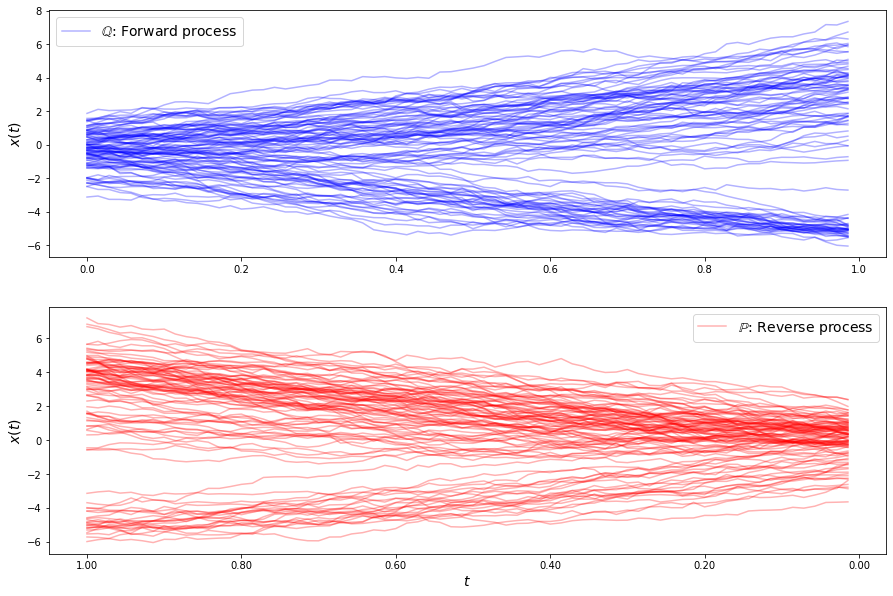

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


294667.41411570646
266836.5812574049
265541.1947795927
265409.77097676246
262638.8290180297
260657.84241088718
261821.17576955393
257789.76985175148
260565.33856494434
256373.20981446182
258357.21585667445
256710.85316030547
255643.3642240115
257007.9733777246
255053.11334222008
255632.88825333444
255728.13623026037
254602.20180554496
255007.59137232948
255495.87164206585
254153.7906988685
254645.0099301935
255143.80200413166
253894.78246972084
254073.9437243478
254800.79621406161
254080.09954996954
253611.52775532706
254188.73084541218
254274.16650474665
253569.95524959272
253473.44109446328
254041.37265922976
253948.52144173265
253337.4766784795
253349.12822572712
253719.4701172227
253550.58364150143
253029.59174879035
252994.77785518012
253374.30837233283
253111.3104733443
252585.95557735828
252882.74713216876
253151.91972355073
252609.09581389092
252532.3840627632
253088.8508325821
252600.45574476873
252387.0621119138
279158.81638770434
267376.56161367527
271398.4352347176
249838.1

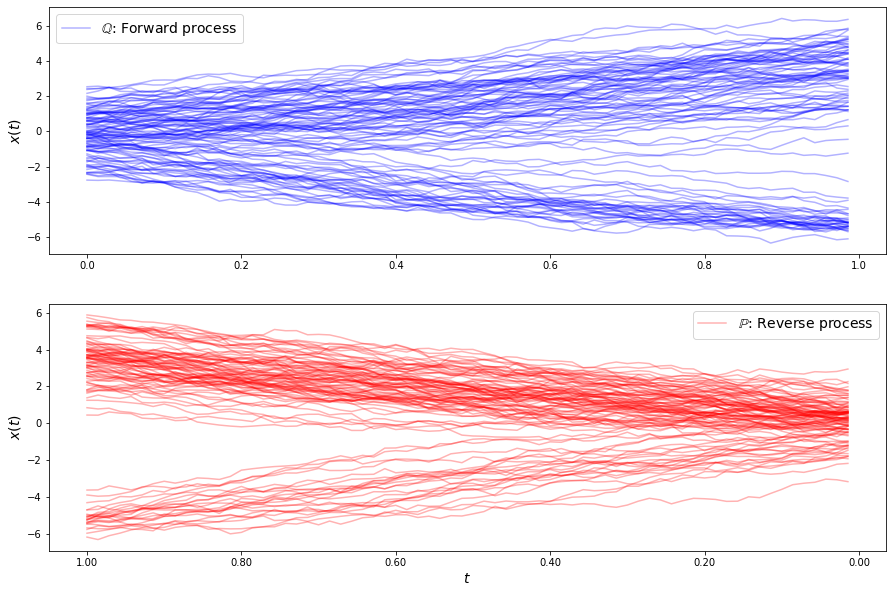

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


301061.92669148673
278959.75163664506
273248.5110743581
280649.2285412929
265386.66255754477
269962.0392798848
266599.1204452032
263194.92802320304
268537.4217933606
264300.29834605905
261708.13388345402
264870.481078677
263986.9027189899
260918.7382139419
261415.3541954044
263090.02617437416
262499.9745797276
260455.2757328152
259609.94333710286
260455.34497691205
261166.29875363538
260416.3739131691
259140.46088282694
258748.94524701126
259332.2656264824
259997.513656226
259931.11300040048
259154.63991882396
258376.80964711687
258210.3512173204
258655.40067391744
259129.22271754654
259079.6377164399
258579.2935219246
258144.899686214
258138.87384308153
258450.43772626526
258663.07050915147
258574.1362861543
258337.09214029156
258182.42760599428
258227.60496478685
258376.3705420879
258485.69470114147
258467.42608304642
258293.778013739
258078.7073055359
257941.23266275204
257977.774328648
258163.37800371277
291571.67421688756
268272.6079678058
249469.47409579318
254431.08228876445
242

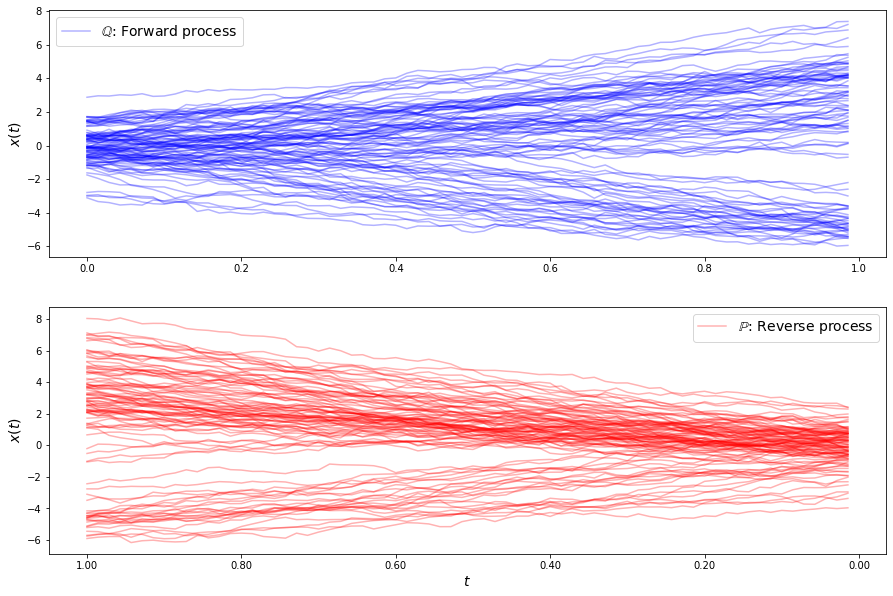

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


290098.4882300382
257343.01455603592
255110.60061836077
263631.83087095973
259926.15057432762
262461.6539648206
252507.25983593264
256152.21499158698
254712.5372147878
251780.53881659007
253155.3925442451
253690.8594342377
250659.42715257997
251654.23275925528
252471.45047236615
251601.02629741945
250722.99694105564
250013.6379258643
251170.49633511275
251155.98365776503
249775.5241591999
249560.20305988652
249844.18510399573
250224.72683243
250245.16809351929
249179.67245992983
248781.35865399113
249387.48505420733
249548.13701742268
249332.6189044168
248999.8044706691
248517.67006255104
248799.1587288492
249413.51320086763
249174.3044756485
248701.60948319844
248528.26071490406
248453.0204116389
248856.98239679687
249109.00615415818
248525.19825361928
248138.95850746476
248394.56206725264
248577.66328888683
248650.73360568826
248552.94913526165
248037.14162593024
247772.48653430436
248168.69766260573
248351.80999850263
290371.0542727497
275507.5299177769
240798.83130307525
263822.485

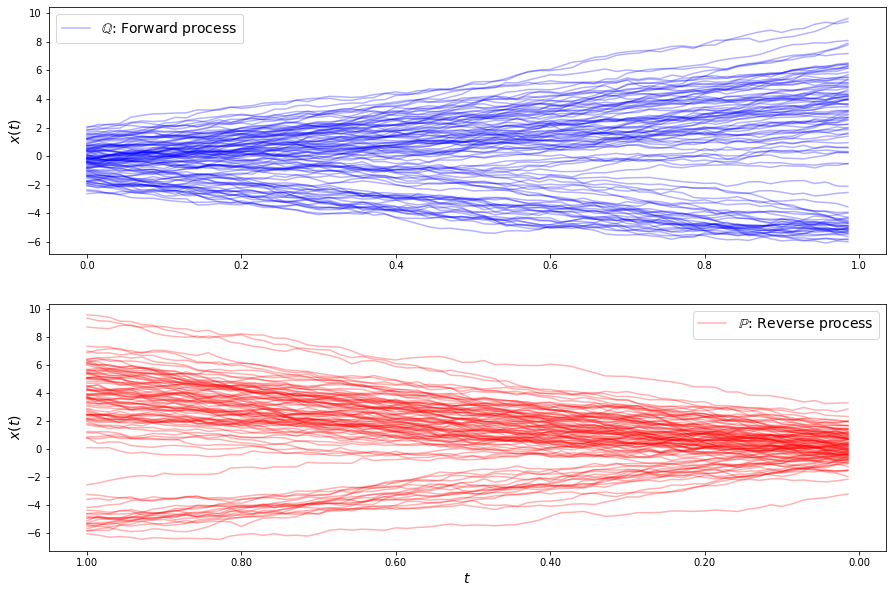

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


321278.8441918952
263826.4354439778
266411.3807526242
273623.96751130413
262389.0082869755
270224.6167058063
260206.37909395137
267156.9545344257
259840.00139590993
264854.0933676305
260385.78349021712
261724.54546458434
262267.04125558754
259184.52913182147
261316.3300108023
260983.44242076256
258976.46518525755
260480.1847014804
260687.4961258128
258867.23940509645
258917.17352133925
260070.02236589938
259419.65610524538
258413.81184044288
258975.5277142495
259642.26937870402
259025.81797087466
258143.58355917077
258290.02544222248
258981.06543249133
258935.35288032016
258290.9656533546
258045.05283620072
258407.13479263478
258730.82650264032
258464.99947010988
257911.2540071631
257700.06813784206
257988.98644796057
258357.1733619796
258277.9649888245
257846.46547464642
257590.78017114822
257684.54626003467
257880.7612742859
257895.19574162163
257703.2345605002
257518.6006726376
257500.33099521557
257609.12102722505
292069.9492605104
263894.1930851635
257988.05073705415
251806.763430

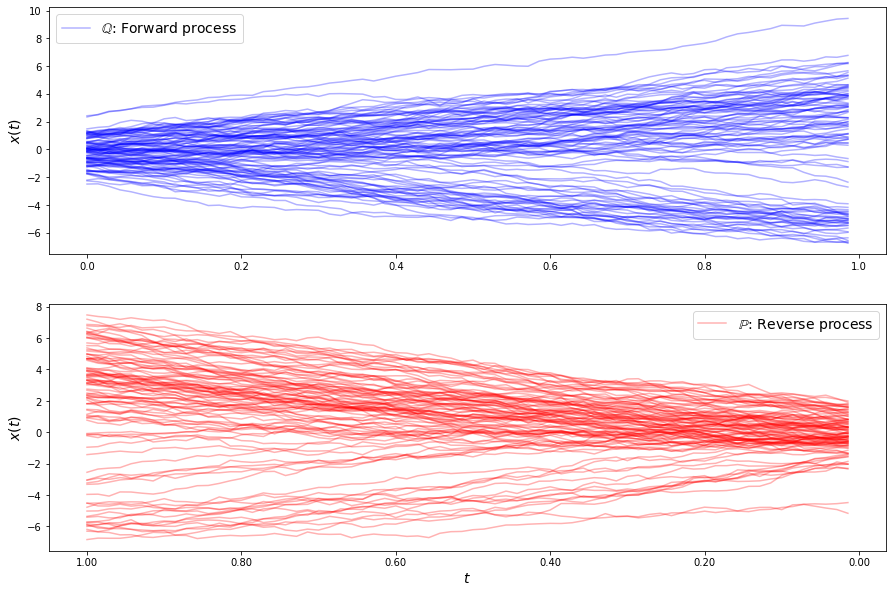

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


294544.6346841475
267533.7881072066
271622.10313171183
256272.08358603052
264983.70336925524
255874.87667385503
257594.38308264373
258794.20012983054
254555.37982489076
255501.4798044448
257535.49182543214
254584.8354580772
253733.12267479312
255554.819491638
255369.38174245073
253913.6659727884
253341.90219303666
254512.3260058275
254954.29240827146
254201.01314367054
253410.27683028494
253079.80599569605
253708.11055397772
254163.73650520045
253854.53077224214
253461.28311741614
253067.3918044447
252944.93019912028
253381.89321386343
253756.2769620713
253707.26664828183
253581.26253276283
253397.2896126795
253020.6889758305
252773.45604926004
252937.6688924175
253246.7624366432
253325.07857520616
253206.24043776403
253084.52864868357
252953.90454567972
252729.6590531175
252522.92127187352
252562.70209258707
252865.73805755307
253179.14284811128
253219.4113381221
252921.53739463014
252515.411046157
252305.42550712643
280742.1586478404
266444.9399410065
238957.1151190671
258176.4004383

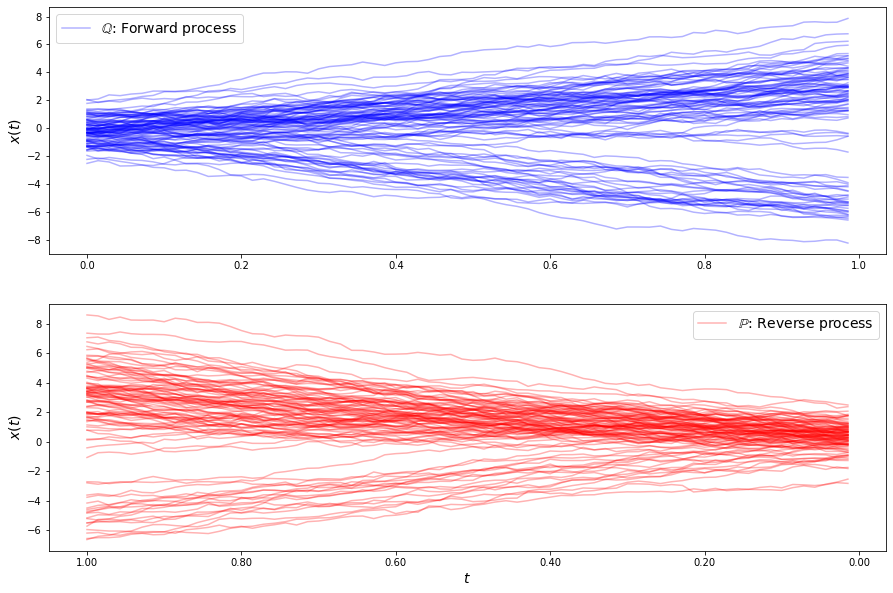

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


290800.3594619538
273774.2061050079
272071.8569509547
265098.81998905254
269003.20598537277
259700.7005947098
264282.3122418476
263173.9242846951
258592.23261463767
260623.8280212052
262650.85966976127
260173.52039753058
258359.08519004245
258593.8220748598
259563.71480929188
260052.07706404582
258714.4099242575
257680.6660675652
257996.76439132087
258348.63914630172
258792.8555635946
258691.17719901897
257840.42368319657
257566.39934195596
257415.81602759962
257592.22003741772
258071.82754424805
257749.88986942914
257467.4008646764
257063.9741619765
256748.45483568477
257112.14150674912
257218.7141214754
257596.5447942978
257556.38556025623
257214.58106727296
257009.32182394288
256539.0087170333
256699.53009400092
256663.95622213092
257032.9595212136
257151.6026155681
257168.94480851624
257123.575228808
256762.6031319279
256740.03262914973
256430.16974527034
256648.88865183844
256591.735864544
256882.4944448118
275020.56107979704
247873.9771226414
273751.20826914534
252492.57113077329

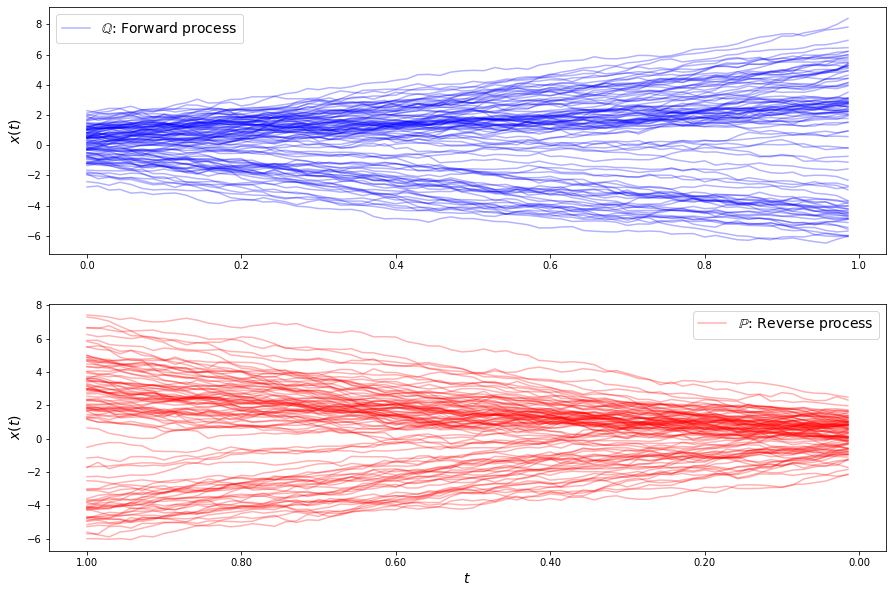

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


289947.29566785344
262416.2705488502
273294.74337878544
267632.7315385271
265404.9760056955
257286.98695233505
253879.49132842798
259771.8605219251
255443.97246710505
251795.53052375995
255021.53112451622
255049.82989189803
254923.38765135885
253796.65031849916
251018.17225971594
252013.66071551677
253514.26500854045
252663.41825629986
252734.46765099495
252363.24096749432
250826.37390565706
251004.62349244708
252030.54540226614
251777.49804122775
251456.447428763
251909.5260626315
251584.6899043722
250456.39788956492
250189.9817690393
250586.96922358318
250444.12852342945
250167.06225373392
250649.70287145965
250973.69190407454
250305.37712411172
249811.24741466716
250012.6414392586
250030.8061067494
249602.7713182742
249566.96336703375
250113.72697565827
250291.82628421695
249918.9216422464
249846.9292278536
250061.32833950856
249812.54520240688
249284.0439528547
249298.4017426022
249630.23067488128
249468.06423166033
276040.3055106433
254437.80244164367
263299.60798402695
254696.495

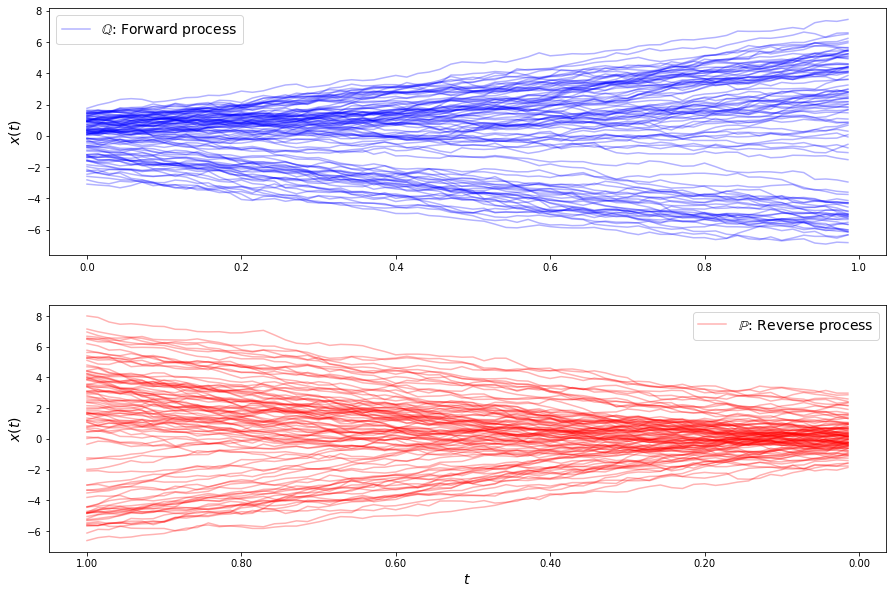

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


300697.552638384
258639.3339454442
274832.0257049657
254220.23368052195
266671.5186282421
252883.83673443977
255714.96638475807
257528.9225466932
251028.4325624347
252501.95179368273
254385.69131802034
253852.26237687084
250152.27589378972
249903.42235142548
251095.7862910211
251802.7155613238
250719.69714900633
248947.30040943588
249228.5812086463
249682.22046414803
250702.5806766548
250625.43332204904
249609.50304487685
249020.12789289083
248386.87410085218
249038.36056911282
249569.81999961165
249686.09972022558
249558.87172010684
248646.89407311263
248426.82979999954
248407.4951929504
248655.53563588875
249287.6645845483
249293.3644769532
249267.32935991912
248983.56248431548
248369.8404380824
248300.49919492818
248215.7893662877
248413.70088084645
248863.60450252995
248816.14509884058
248855.97585343593
248554.82387819406
248106.8905185993
248082.73242078582
247990.00556122127
248231.2747104533
248591.90807545738
282010.79999109235
254922.20807537914
247862.67343899206
248016.2678

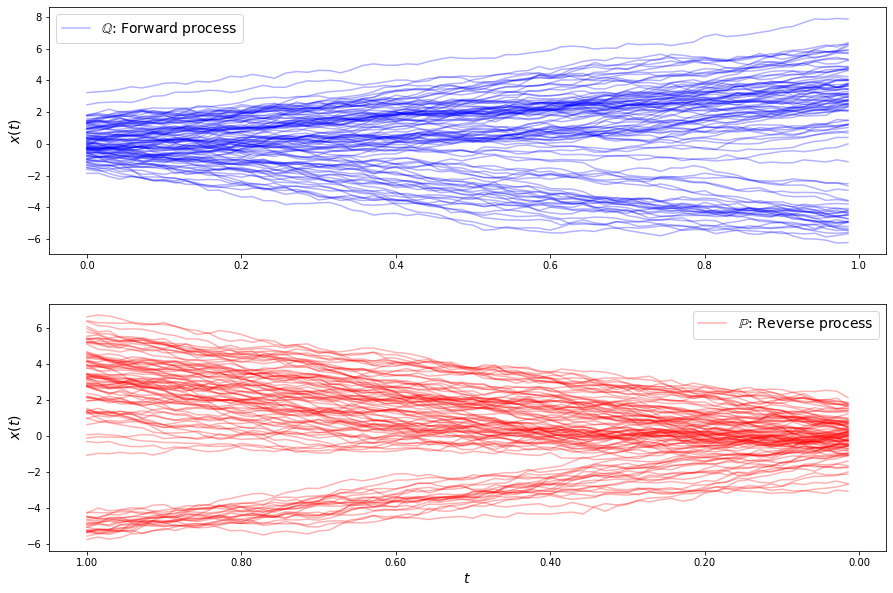

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


277185.3924844756
280739.2147611798
256123.32932150195
271801.4474850259
251005.61006740842
259583.07013291732
255809.19492683496
251332.93438358823
250966.47363860672
253463.34334966357
252648.61150050827
248309.0358972967
248099.33014413668
249778.88476709055
249920.23400166968
248646.4616917239
246838.7386463883
246365.72811966678
247618.12931054778
248188.53768441605
247791.05321224302
247222.0323112612
246007.3977613741
245501.50437487167
246221.6498623434
246753.8478841574
246959.90853666782
246827.99487987527
245912.9199405891
245257.348639926
245446.82852108835
245649.13149018097
245929.13168757138
246270.2615078992
245931.4448893678
245273.7994118603
244918.1978317086
244700.38009259978
244601.2107750196
244839.3544446912
245137.5918777368
245027.8065515583
244600.2735464633
244314.35709640535
244201.9043245978
244107.48015313316
244302.93360131557
244612.54881326028
244460.61080383687
244108.87581873548
298316.64253517357
253176.85927162657
264851.7667377517
254145.9388162047

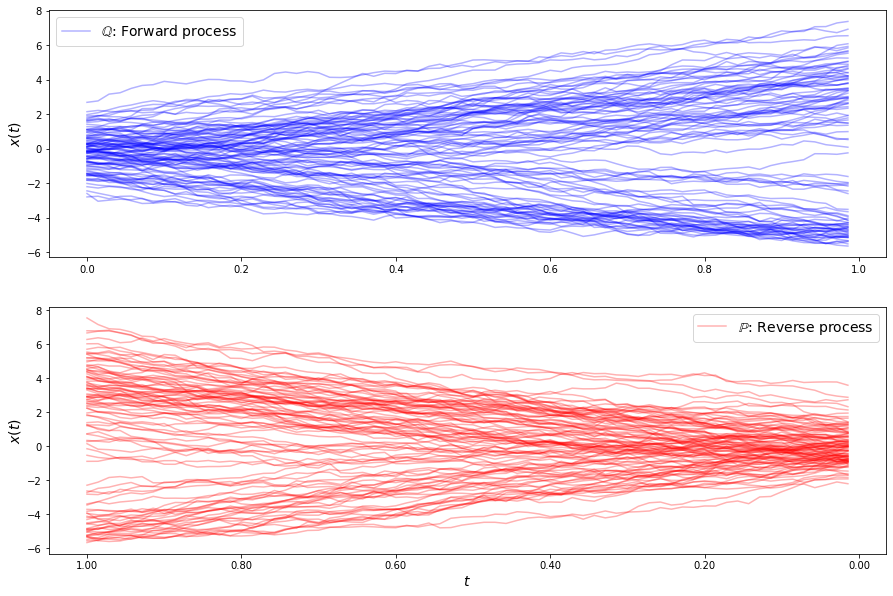

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


284858.5782099457
274271.0126527422
257460.33529082988
270772.28229539737
256118.3899181508
265667.38534081087
255918.0298033697
258789.477588308
260278.57368263233
255101.7270913632
255980.01472770402
258254.99348912764
255913.8094490802
254201.10288018823
255447.17764883628
256570.08792819863
255535.10901237215
253903.2989501837
253717.85530612234
254805.41415246477
255313.96253205778
254453.9717536893
253417.943974144
253311.85882671794
253962.88245952234
254415.55281045003
254033.93928684865
253169.11246296088
252657.18992169798
252893.51609179113
253467.4888547858
253577.4418980269
252965.91663279996
252249.0708794208
252084.13689026417
252455.28318848286
252817.96833951757
252687.34149587413
252123.27005719006
251642.00224183899
251634.29397772046
251954.01861074503
252074.6408583317
251694.57540675683
251151.4803157575
251029.07179611182
251384.88595783553
251670.30407806364
251441.73586281267
250893.5964281456
308739.4156091039
258150.78489357393
264470.75547172525
253958.80516

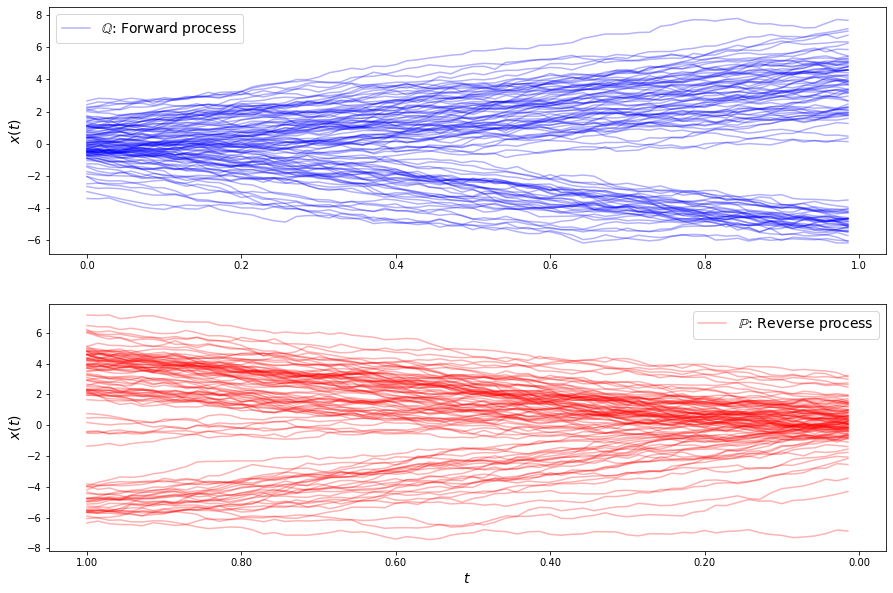

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


276077.2695875805
288722.2092502689
268136.02007597045
276010.7212252729
262642.2902932896
260152.99792200897
264948.826814412
261635.3895137871
258916.0361717065
259966.17153367124
261663.5076459745
261399.26674004702
259078.79435960195
257588.19579870912
258362.8028833961
259425.8140120846
259034.20594251706
257655.59213530686
256643.8000328433
256892.872745077
257795.3634074343
258021.52649238447
257205.9147596884
256159.16114482458
255659.5716285169
255856.60837708684
256350.04347600482
256406.25054205913
255699.12411924492
254892.74744275268
254780.40807327116
255312.5230195196
255778.6576952685
255581.69367709217
254820.581662715
254172.19961769163
254164.88422675227
254620.9057972739
254836.1707495229
254383.85209350724
253637.89058052556
253262.8467772214
253435.9103111968
253787.24232472223
253841.1127975512
253458.81612268102
252931.234229508
252683.79074776254
252872.03973700874
253204.73039780022
280763.4952806563
261117.74900599636
260248.48277619042
245154.29502651189
246

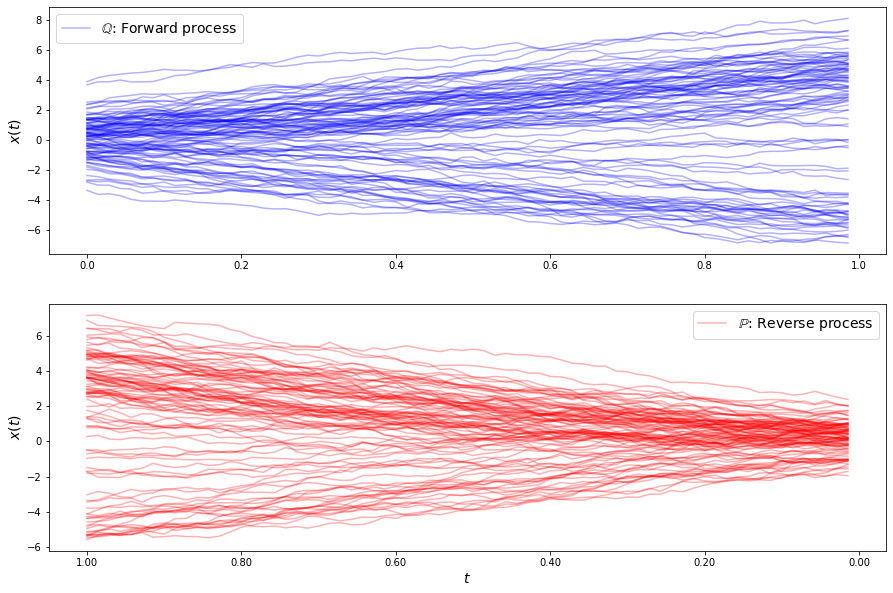

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


301858.0521228163
274916.5206048673
270953.5994366617
260292.43283858863
261099.60932230196
260500.29572429112
254541.38589624214
259519.09038146958
257110.62159279562
253023.5832589667
256901.34640540052
256758.06144422517
253249.89556107632
253737.05019835086
256299.26876422227
255373.41037028073
253235.980509118
253077.54854822592
254499.15664772125
255261.08439800853
253619.5393652494
252682.7956237531
253134.40273003583
253905.7115139676
254315.3294542101
253552.356062825
252766.17919752022
252555.62871595746
252861.8532177605
253552.13846105238
253507.77131160995
252979.7555193476
252560.92310727917
252302.6091515352
252598.74898760597
253002.5151117146
253144.69906480145
253194.39054072724
252856.7955548679
252411.4298860254
252201.9930874992
252043.66089573503
252212.01551842823
252535.52879146812
252617.63099041712
252620.87646326938
252375.79905099497
252027.89530672738
251936.9936633726
251888.81618151657
283996.0889823148
253863.87741821702
273078.9670758905
248804.37118281

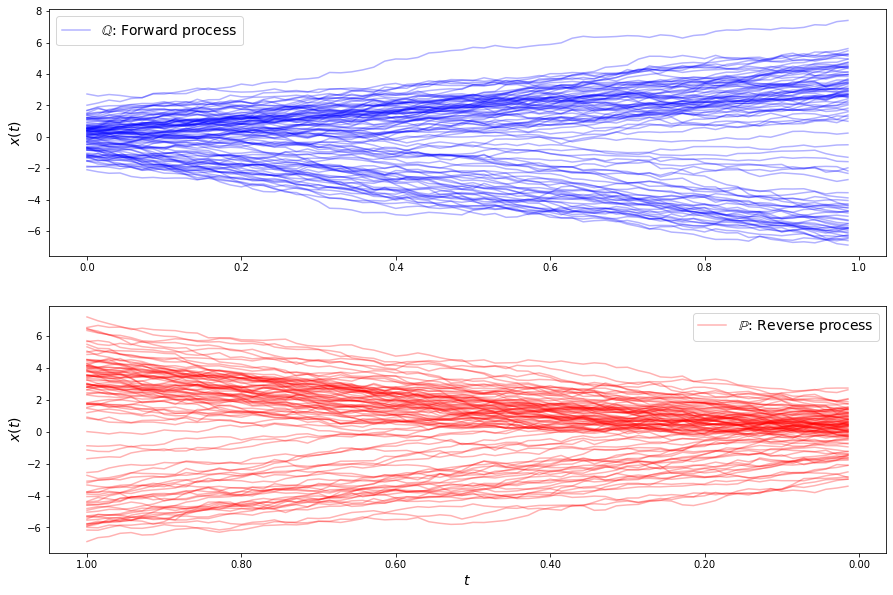

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


290499.3412128136
260241.69394967103
258491.43766150193
265701.8912330668
257641.09566893947
258523.83938446347
256034.58931810042
257300.96361617476
255047.51281851757
254216.0406998055
255843.68417377223
252219.7861699732
253887.74174230185
253623.08709898003
252847.9194860732
252076.11554889276
253232.43177462422
252070.0175415733
251127.43616919388
252564.14262435416
252094.75298664614
251409.073764153
251337.46307929332
251661.81059079553
251935.933518558
250940.952225837
250861.45065303706
251695.12146971023
251470.29708616168
251140.32002901606
250937.1347636483
250727.208506205
251193.7104752138
251320.01567347458
250623.9836096478
250514.2047957152
250881.66626842477
250923.267164585
250934.27236679898
250672.23784846457
250252.8841622425
250502.28849715498
250860.78731576196
250582.3469124833
250271.6449210504
250269.5015062493
250227.576143231
250330.53430762194
250488.89340646684
250130.7744164599
277415.7763738574
264134.77693221904
276181.0088511233
248515.21116513992
260

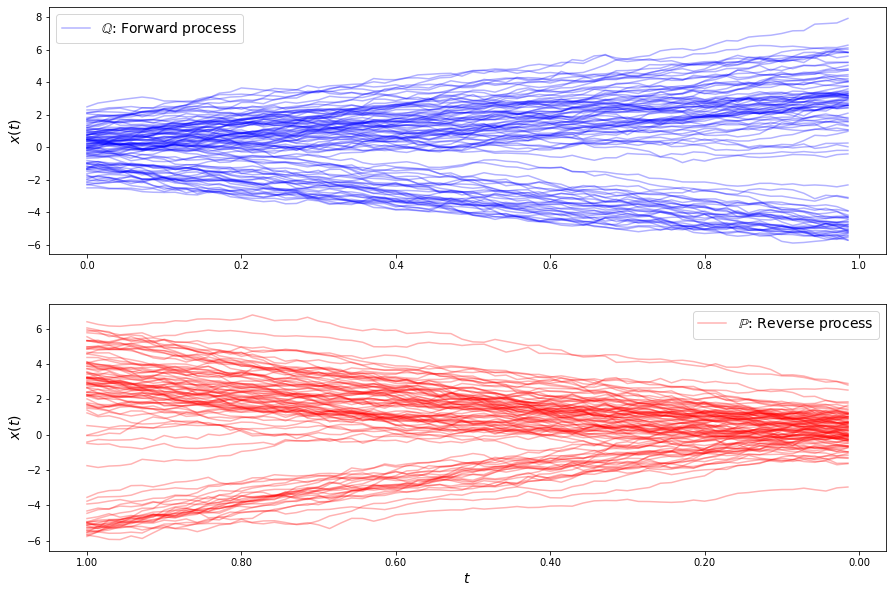

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


295483.71519201354
263090.2504803381
265375.82993346814
269300.45049972937
258302.5337320208
261407.86245258158
258844.73660410923
256085.71596269135
259435.35694947344
256149.39114989067
254578.3376782716
257026.43976699119
255597.0985583294
253957.58686335836
255316.4155979293
255483.91355724385
254667.2771202728
253696.58834136766
253605.7190057583
254794.95753300202
254375.3798204617
253558.7706651765
253017.5663665703
253178.7056281589
254020.89784766038
253845.89512602298
253584.24701727886
252715.4427576432
252705.6900788202
252812.0623164389
253250.11168350535
253237.90629589447
252946.67017121834
252648.0869727324
252449.42780738103
252574.01528469083
252633.7209273291
252848.7801132009
252778.29259028734
252710.9582728569
252329.5686348016
252119.2562556972
251973.01678174216
252261.54416543292
252422.6111200478
252410.25082262652
252094.21389562136
251953.66214341891
251804.80919695133
251693.22123902958
274763.62174292747
265400.64317087736
249872.33661766973
252407.7808188

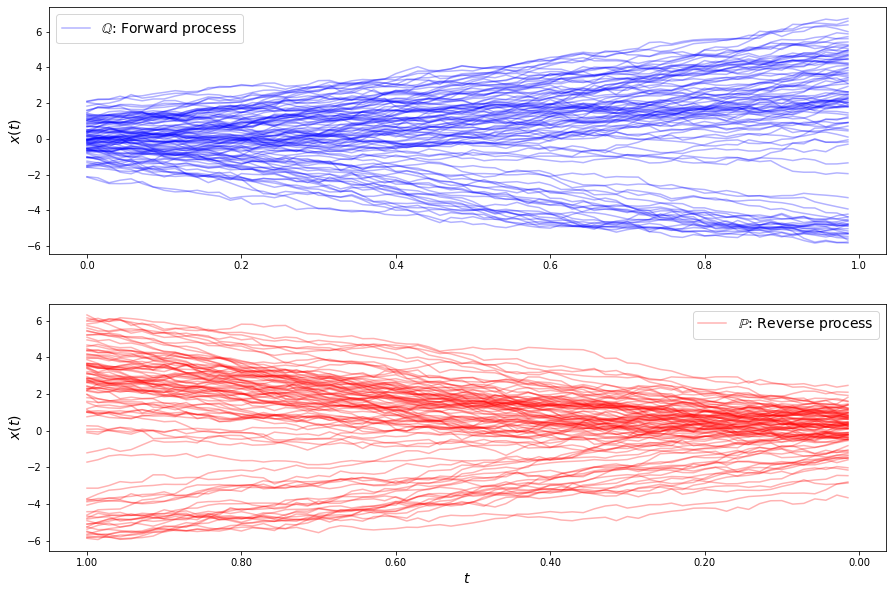

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


283947.5813016285
258279.97890730324
254395.8985337467
262033.6299866285
250746.49298325865
257442.0478444726
249998.9674924978
254696.82480181314
250552.34074069344
250619.1486714575
252121.910996918
249050.86615274154
249936.21580434422
250944.91359629965
249149.24375680467
248545.20998736628
249542.9966726026
249595.68297039834
248461.78045040494
248048.5559385661
248774.55290111277
248993.83331191464
248474.3295186742
247723.91336562508
247822.45205796766
248319.2594389717
248344.30582680757
247752.7519794589
247347.9067619929
247541.2530323884
247880.60890966607
247863.6098157385
247350.32709175773
246935.78028245587
246970.30955726415
247361.00572527794
247341.89049762362
246867.79315031253
246413.761915188
246544.33712349442
246809.76981558255
246806.74467538472
246293.84293811885
245922.8272219241
245991.57877780002
246332.07621299408
246156.41159294418
245640.504307629
245343.4648393381
245603.18687525782
279621.1898284427
247437.1859485836
262711.4916575874
247662.0543088848


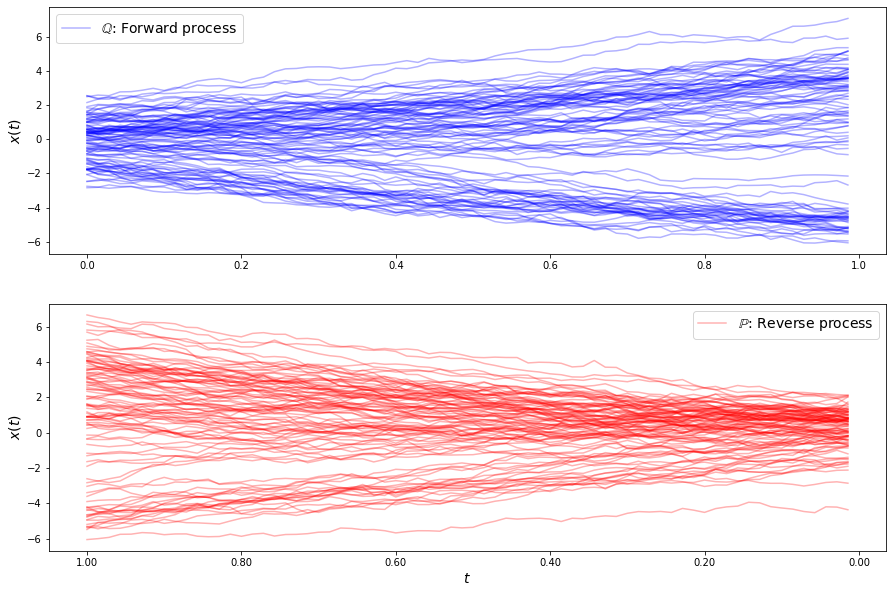

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


283465.9470247403
276973.29302524705
264906.818523928
270245.35401333845
258399.17927718896
267763.21161013277
257241.17643111752
260733.6348426477
261999.866695242
258586.26193939615
257671.54713204436
258368.8443971941
259291.1786710851
258260.59960024193
256454.06615412154
256813.9455852721
258435.61201074824
258515.32120685576
257170.36264448235
256357.49436971865
256398.1332058559
256638.97174639822
256968.7495384848
257255.8457013024
256859.09694660074
255973.4588419121
255639.65125086956
256101.09781924894
256686.49404366565
256808.08379069075
256489.9977186501
256082.49138913327
255774.47760465086
255576.56474850263
255575.71586316117
255836.64258773997
256145.0242157806
256136.15462450124
255723.64659949316
255232.07587448804
255040.1649722381
255222.0562647243
255548.17792171193
255737.86589240923
255671.29800447775
255402.28380118572
255056.28611994023
254769.24595676002
254666.20752814016
254792.40497938596
297636.62032127345
246366.49474331958
254273.76818666572
242863.926

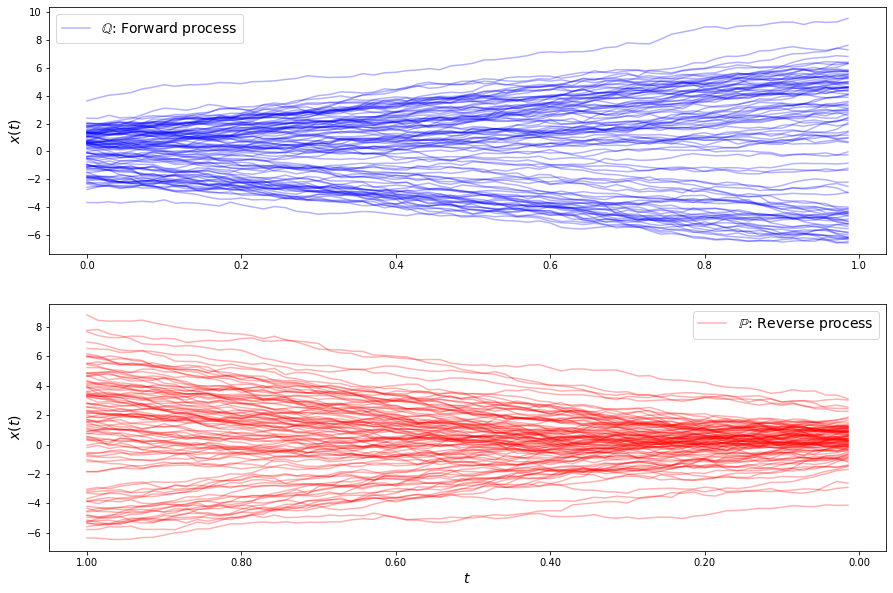

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


286686.4280298272
271743.95474324
288176.5749248931
261201.10269411525
275441.5525458152
258543.45884021232
260944.94026539277
265336.9459565251
261083.069047356
257010.73134032747
258677.3911910366
261418.4886761907
260237.70976458347
257458.958853019
256943.39739836563
258369.57774760833
258964.74755266082
257592.267685684
256151.2327649608
256068.50151698466
256969.12517793453
257703.6141152988
257530.74695900874
256649.6623520743
255737.2660304429
255301.14182874927
255408.7344211256
255809.917484737
256161.67653662892
256235.2122404636
255995.7709498654
255591.38249737857
255237.28914022745
255058.09784037326
255053.8622546093
255180.4972879557
255348.40558307592
255443.78629401757
255417.69266313227
255271.42616202295
255016.10536156423
254713.3840033524
254440.51823309448
254228.3769666236
254108.74428919872
254099.2555252281
254172.87898697154
254281.14977079275
254346.8863964866
254277.15906208905
293389.38119510096
251849.98910006572
249128.07907384282
260384.3681771303
25022

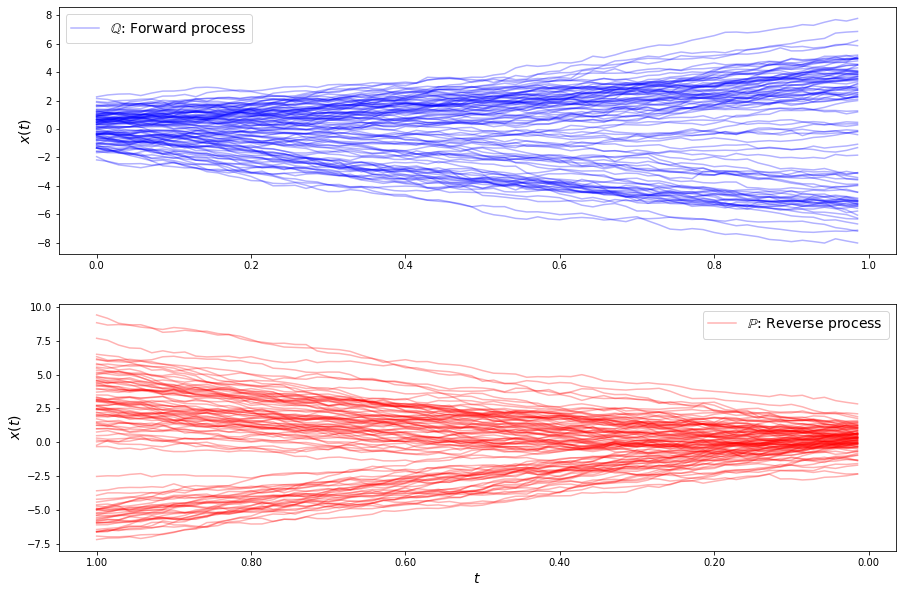

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


305589.84498450963
266737.32064063963
289178.8337649356
260392.50006426522
270724.59241604933
265540.33437679906
256579.81841644965
263210.8551196229
260586.3686059232
258650.6835633529
255520.69333776282
259140.81705610035
258373.16534588468
258295.97360218738
254636.59983606578
255102.79821560264
255089.28778268976
256656.30190161167
255594.2222287217
254317.96955159705
253646.45956942684
253690.7670191285
255071.10449639417
254782.06872218335
255418.09137594746
253637.84789288254
253818.39428862388
252726.76317282725
253726.3279821033
253816.05138409586
254161.42746884027
254140.19416847723
253070.4461902486
253289.8402547136
252401.28794924458
253103.33827471358
253190.54894932997
253391.51323368377
253958.72830455482
253265.91706428258
253533.66211547377
252851.0387905694
252568.45833828693
252793.52493437237
252353.51893917623
253047.74136182663
253009.99992402707
253020.49261511996
253330.0003362974
252648.2923492158
274761.6165320013
232068.25953722664
243968.41419498698
247034

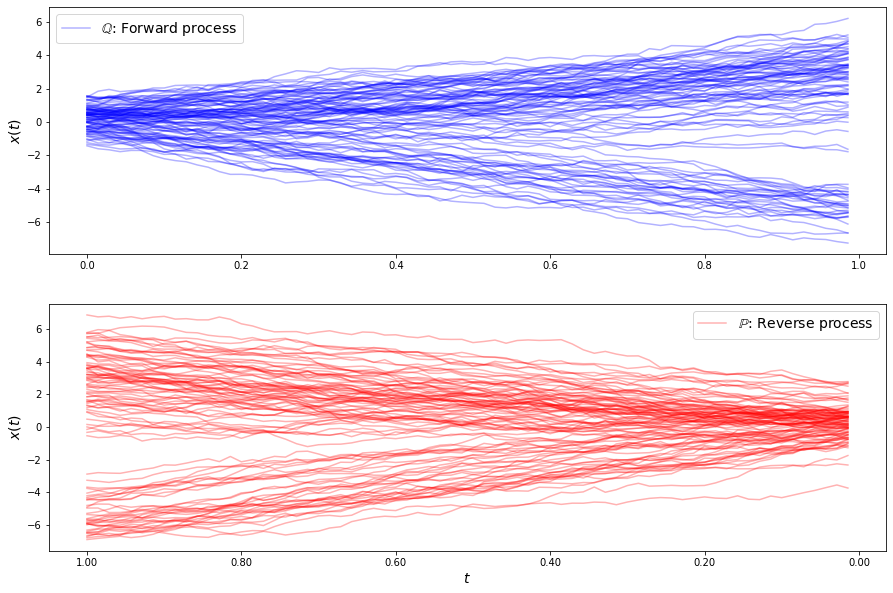

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


311366.19507096475
263958.14475913433
282823.72182507225
266707.889626284
273556.0327985045
258346.93837398884
266385.22915054706
261954.01968899445
257844.87188220854
261091.505387431
260855.26297017303
257809.72588767778
255559.62439589418
258469.6353234501
258087.10551786603
256132.16786107718
254874.4255172875
255297.51298129003
257152.30085959015
256225.86798854632
255607.84880020944
253874.99648877233
254499.78603105102
254912.69015313612
255442.0320389216
254706.3706195525
253891.09681698598
253645.48752092718
253802.09528001008
254462.9698520839
254371.07640347796
254387.87362533348
253582.19301674463
253530.35012706032
253130.21439747058
253682.2074474452
253602.73976656867
254007.51221983338
253457.17553065278
253418.58620610178
252796.88438752803
253105.93340378802
252967.3544733182
253473.64636209654
253150.86017822818
253252.0720978866
252683.9109890585
252812.62043932386
252517.40112903528
252902.59078459162
308731.61147245014
250123.87575822216
261268.4226779956
256033.0

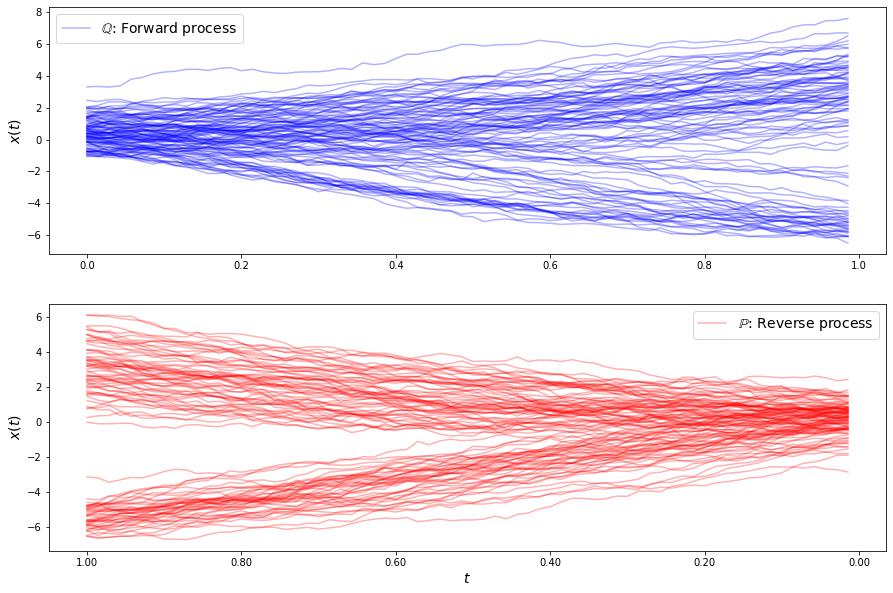

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


287293.6705603575
287665.66484080744
276736.1377463123
273688.2717680754
273667.20228170074
260175.6722137609
264347.8453717446
266868.7912297456
260590.60748438537
258741.80706967853
261184.16071698527
262888.23941114976
261750.79725634714
258899.5214473263
257019.72113934148
257327.33665537424
258278.76977967072
258519.282600497
257927.7775985289
256534.04408862256
255473.88090821035
255584.72462952
256061.5345450898
256350.73270457142
256401.38994151662
255751.2597201405
254800.17059105332
254282.80123908588
253985.81744936964
254051.7982070178
254485.89883774333
254446.31054293597
254055.4828803661
253480.24536021808
252752.40780956968
252619.91652731423
252784.5555231835
253070.3835317795
253450.52131662308
253250.80598560703
252879.26749358457
252301.12337848044
251809.64060957258
251799.7821739543
251868.914724989
252300.09975312368
252433.76332353594
252354.41518896818
251945.57427171592
251405.6306966791
304072.9845304246
262272.8535114378
263042.7253755887
254998.17586241697


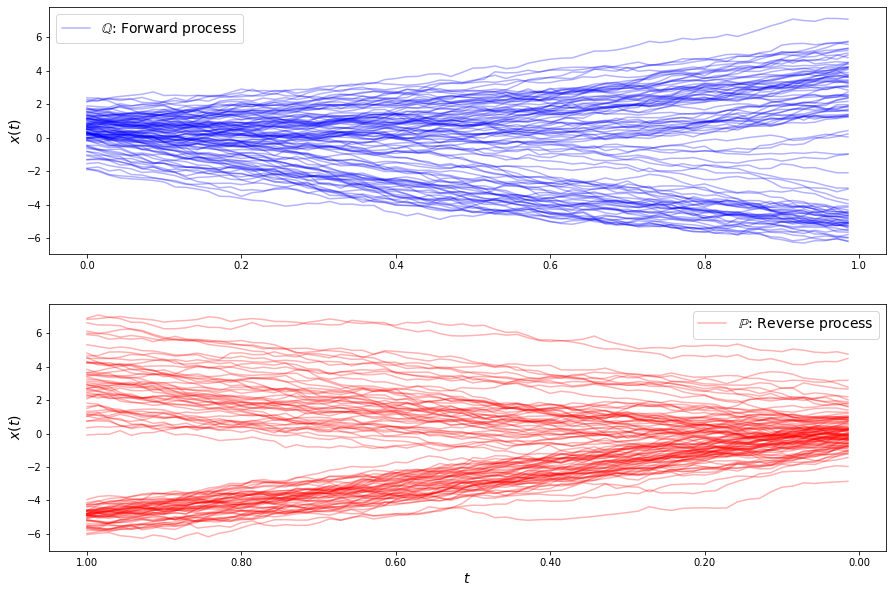

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


298361.3377319268
268799.597913665
280887.06905838987
266598.7430893006
273525.8210823223
261977.36154885372
267043.6537969854
263117.62630778947
259807.95277502376
263111.5130991436
261809.84812413217
258386.9208473734
258871.01564036647
260177.26788139425
258766.97737128666
256950.699083934
257294.42548599112
258416.95097807504
258026.7341284821
256643.57604576176
256185.11016035694
256917.3386043055
257512.535756229
257021.07538871514
256068.69930502828
255746.94027199326
256172.79144226524
256580.44643830537
256344.88251624492
255695.29019889943
255244.42928761337
255263.91021107225
255605.3244448482
256000.09545846
256370.2598198339
256943.2471135712
257609.68374295253
256870.15598350854
255417.63410497963
255879.8090491048
256747.13793141453
255648.89205177786
255599.99077715952
256135.73339897423
254827.42867144625
255122.00371308817
255074.38116538263
254385.0765814481
255316.36926910753
254612.30931043648
295471.48082815803
249912.64013388677
261129.9325000014
263904.582728234

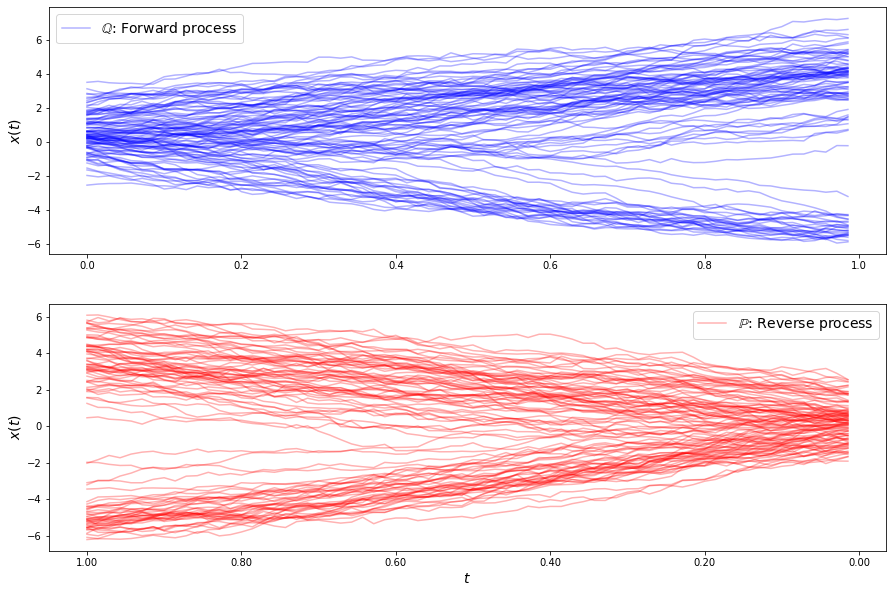

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


307135.65838071686
268921.6299049128
266282.0336233224
276813.8144744176
263521.5806731085
268929.7596794294
264077.5207067707
264821.4378741104
260432.53561735112
263952.2777927406
258252.89778246696
261700.37098561105
259048.46524116062
257722.5290199373
260052.75573896623
257053.17894517802
257201.86206642288
258561.59176985492
256524.3223938523
256079.17731879625
257541.84903431495
256345.15721666245
255287.68692671906
256373.0299180331
256596.81255720387
255308.31763019407
255071.02290033517
255980.17307289678
255986.0370814546
255102.5210761843
254874.09125108522
255556.5030902755
255847.80386026338
255334.63676777424
254744.28169202013
254865.3901716827
255298.53282285703
255340.1663427503
254811.2653830772
254399.9568674718
254567.1297905854
254965.8192726347
254983.98533161165
254468.03565236097
254103.95886062086
254184.93731712824
254544.59268531384
254604.97951035365
254237.95664214133
253909.4131844968
295367.620027418
264274.4797708558
264322.7932946718
263483.89975528186

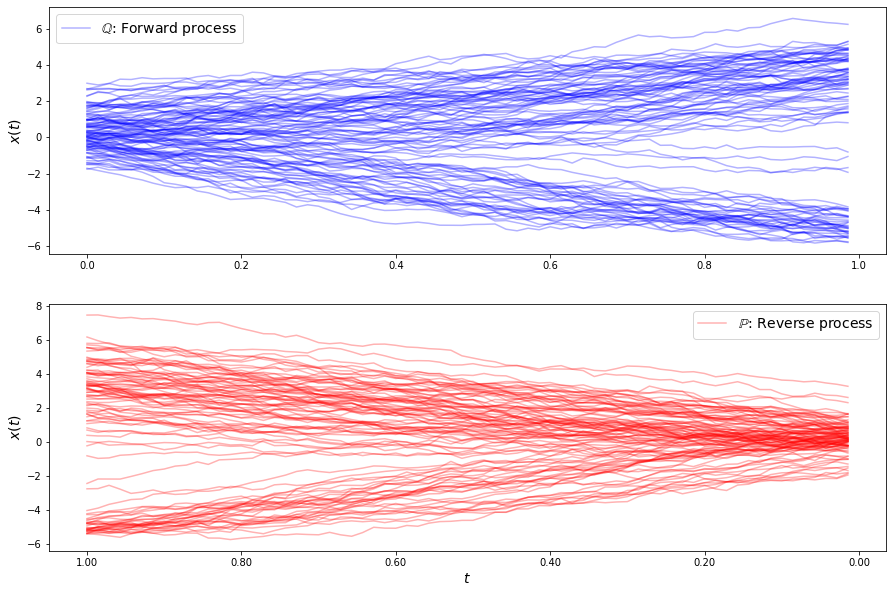

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


299915.18495487736
274172.3186107431
274153.955642245
262688.45272932487
266987.43004429055
261856.09913882348
259897.54302643682
263095.30460453895
258174.76712054413
257057.33769157517
260530.22990845836
257159.7551728299
255105.85387422558
256879.7641411372
257199.12117930685
254593.27840972092
253931.85394756624
255713.34615647927
255642.2939046668
253731.66791985038
253695.68956221465
255028.8580718268
254651.42467944918
253169.63280843932
253131.72237485307
254233.65228007917
254315.4261469538
253181.35086829722
252567.92897601856
252991.38571076293
253544.71928586886
253591.65715967742
253192.2951151353
252763.70556271245
252779.37966727925
253115.83257175336
253290.28549464187
253195.8479254729
252817.74939453567
252377.01558354858
252314.82558629275
252522.07371206736
252713.95303718525
252728.55750720462
252427.09243161167
252075.46942211327
252056.0664337363
252285.7189748639
252527.5899900106
252555.48157852134
294224.2274401988
270176.17115935124
256446.12476844306
260289.

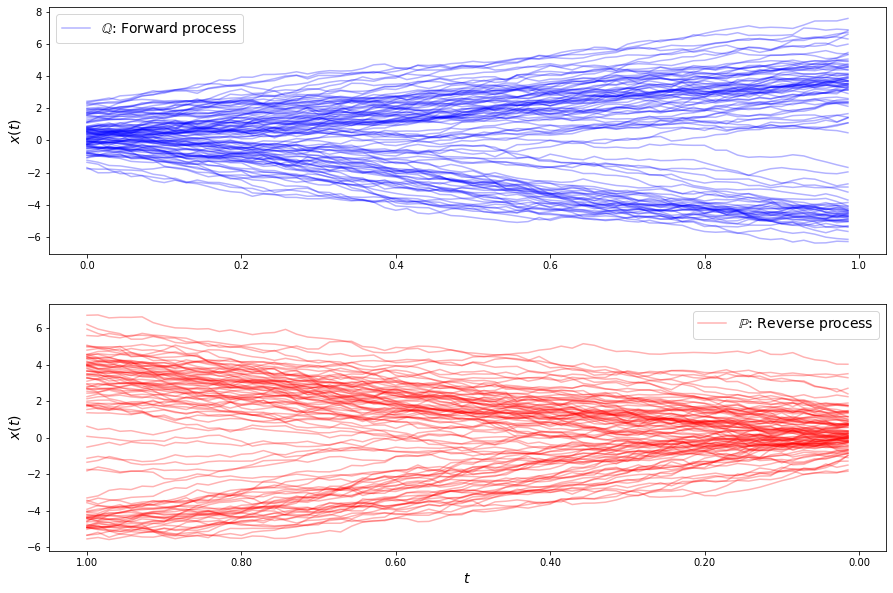

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


291842.0267382696
269719.1734182236
258000.45000536236
271352.4376710383
265773.3919783212
268174.53981824144
255562.68143003323
259669.7380535318
258491.76676971692
254745.38809918985
254803.5534577813
255813.66919132316
252913.94647478583
252144.31917093668
254367.3592176625
252599.1626909711
250786.50957060122
251081.67632337657
252087.84492156658
251981.9014603313
249970.8146842175
250027.61040665733
250907.08501754896
250902.39957310268
250213.88504527466
249051.02688712516
249535.6000660801
250287.10707418167
249930.68863919674
249457.66371566663
248748.96301482065
248871.11272013985
249662.41775858024
249699.49486054658
249571.67828238086
248990.48407851037
248550.14888450663
248999.066277397
249221.15627781756
249368.39153958744
249108.77986798418
248387.77074145232
248440.13602436383
248662.3809168138
248944.84504097438
248862.92855541757
248230.93989572092
248281.6797015937
248408.5250586943
248706.52143226692
258622.15670175565
283770.16627540364
259822.21634715865
260938.13

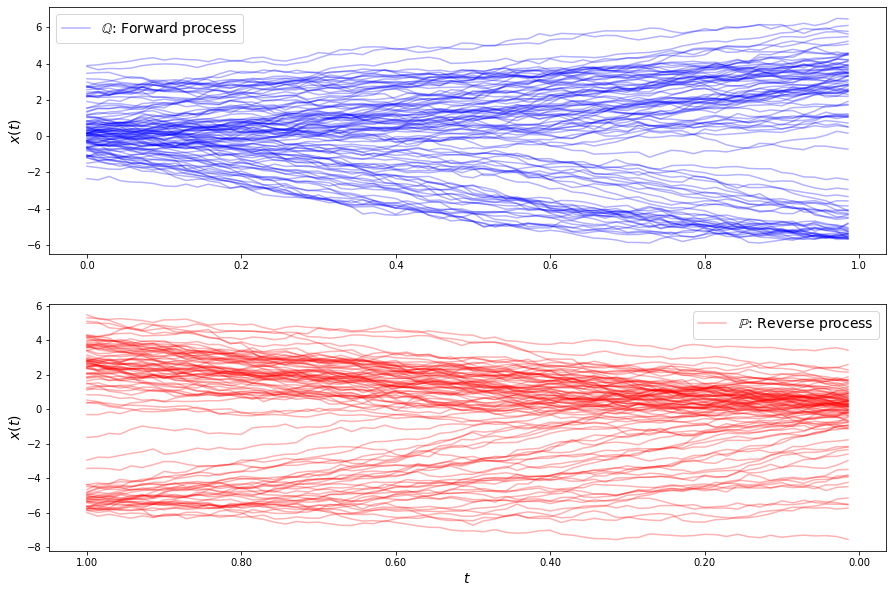

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


302061.6943895187
264192.97836269776
263736.0659390606
266677.7371956024
261339.12412931543
265332.62423786893
259602.4151388809
259785.08622264897
256108.220133255
257068.37762312195
255995.13979407575
253344.32832116552
255109.25630169894
252436.81058459677
252148.57194906563
252502.29096677978
250639.27050566502
251572.25070107513
250658.65631271835
250408.14525345952
250859.64793351688
250192.2753506899
249979.85597917723
250509.2728984323
249331.25043700243
249785.6697105166
249877.22742464585
248880.06329927847
249743.08311908913
249496.30881318636
249221.12771338987
249503.95010319317
250022.69054904688
249408.9246231892
249548.9558432261
249845.16061733398
249715.93978935332
249167.0180910778
249375.8824673102
249563.77215498243
249041.67205568426
248990.28157810302
249237.0017688403
249252.90452489394
248720.90440957705
249120.63534311793
249139.44804752606
249038.5888702516
248625.74235882162
249083.62870629763
285916.369967062
255413.62618843664
258145.85135038337
264578.468

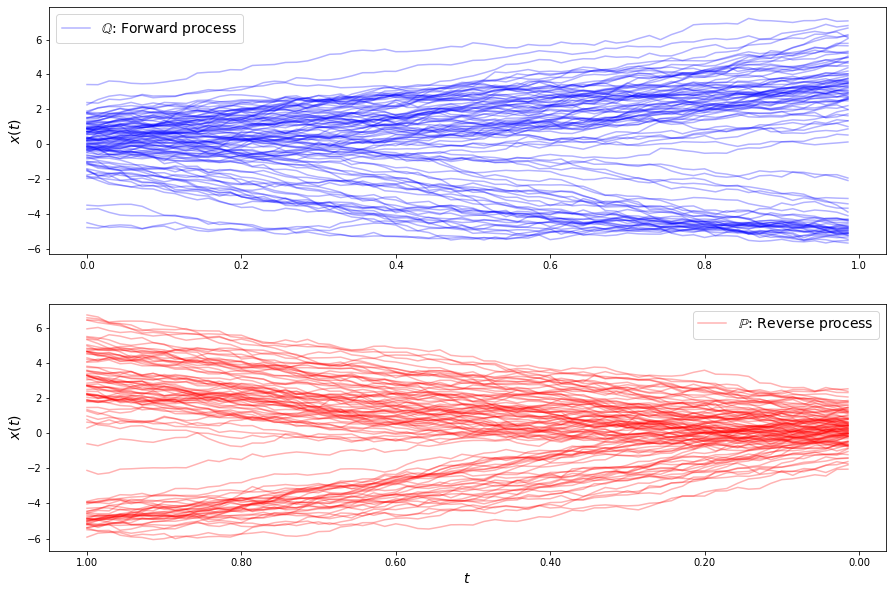

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


298404.31654942123
283872.25683320063
274446.4221478759
272511.3798563772
265507.26471939724
270098.5859840784
263964.11193829414
260966.90365932856
265123.00966175727
263118.80509158253
258928.89777904347
259709.5294332368
261532.86543524463
259680.64155531154
257214.32105417273
258327.71013352604
259546.7684803899
258871.43475593824
256836.4012546437
256492.4545506633
257852.7535127275
258391.29025588415
257221.2564871058
255933.8395214118
256114.23323093448
256896.3277908138
257246.20912317128
256334.81716948227
255518.6138593299
255135.97883498174
255812.6153973351
256085.83814375667
255988.1369866815
255131.68972551863
254873.25255661708
255042.23652269115
255700.74293583946
255980.50544519257
255720.2125144495
255224.72698083866
254772.80877533622
254941.31535724597
255187.48928634095
255589.78227151255
255462.29884079157
255145.32973358146
254729.00304117138
254523.24393218668
254693.45011834987
254900.78783846958
292727.7119369682
263035.53958035045
255958.1259644439
269020.673

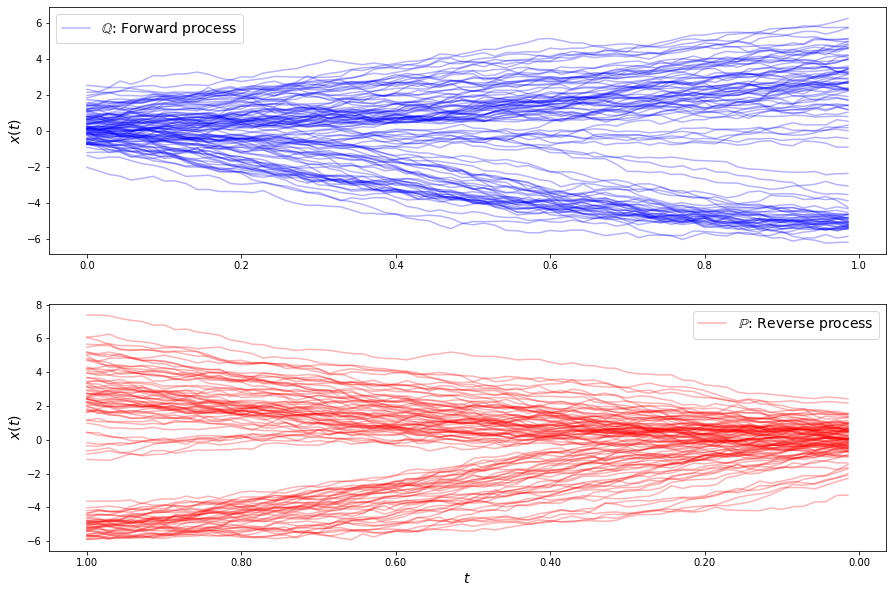

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


299693.5809477805
274943.3948859898
280950.9902612282
265719.5199204863
273220.4866687605
262097.0401882415
263248.55992587085
264874.1390375197
259746.69775476147
259614.03151178607
261117.15914155182
258906.07089208782
256943.67566876562
258128.29779149493
257745.9930010689
254994.04722710914
254825.71113500494
256486.49686319855
255092.96743217928
253482.38393157735
254616.3784999551
254947.25324478644
253261.4065528749
253054.64790475118
254276.06340571633
254026.12505636486
252835.75691002113
253350.1444585846
255789.42492085334
258148.3712729276
257863.80599935586
253421.95142638584
254567.49296274426
257854.4699991353
253622.5793039191
254729.12737413467
254629.8398979203
253922.71234417055
255380.7844125575
253198.67084120406
253938.18639153312
252945.98050413962
253501.58086438855
254015.9298662073
252614.63506000536
253529.38298179774
252271.45024352812
252883.23509223462
253709.19065262802
252493.55351318198
301492.7785360787
251024.12765439186
253144.64060241726
257004.1387

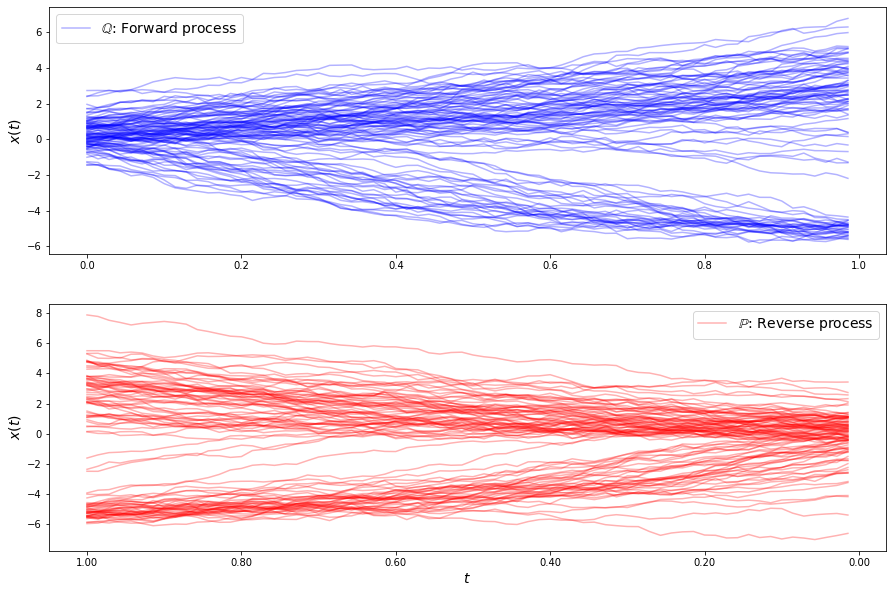

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


300304.0945454561
276113.2771114753
272202.26363151276
296575.65521519433
279464.20845291787
277974.22130155924
269920.9315061936
271777.2138573145
274450.32659442
267211.6140729326
266095.65806500654
268921.2103853816
267100.4481043605
265072.2600042997
263984.8939231663
262866.6487233341
263518.42195615533
264105.15970508533
261878.83209516673
260020.86604137547
260151.6306677616
260181.93196250976
260230.39691225803
260090.93980069665
258603.7884600107
257663.14809452195
258469.7324342434
258611.27531616838
258287.78709104
258165.75478819464
256929.71033653876
256345.8063984623
256893.79974010662
256749.5528868964
256769.9530018962
256700.1775076387
256011.31939128123
256232.5054184778
256984.35090251494
256913.50292252903
256958.78001602492
256684.03359864076
256053.50177812125
256440.58031600522
256751.604558565
256623.76711307344
256808.48320508044
256328.3775307468
256039.522932846
256458.63382476775
289647.85784920317
263616.95240850473
268332.49222772394
273890.97035749385
258

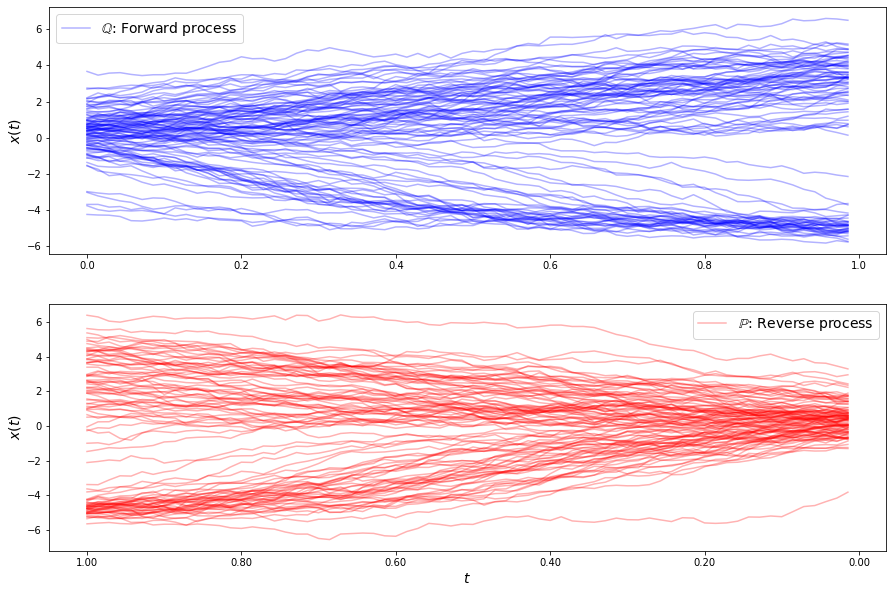

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


279898.1798297239
296225.8580370388
300539.90159006673
277870.0650097412
276737.1958866784
266255.0644398907
265093.7947354263
271284.27947409207
267527.2509431083
261915.33801074742
263032.9943080704
265901.1409676591
264871.914864745
262051.4996558123
260379.40541534522
259596.38169037906
259585.05579494027
260330.60591487162
259827.24843987694
257634.45982049144
256306.71843137278
256288.35448103002
256167.31745472306
256042.42084909487
256196.46950849175
255252.08251756697
253434.1166500352
252644.55039411673
252482.20268332868
252197.37990202894
252373.77741416043
251915.88150670606
250625.79949514533
250912.43437532953
251846.55701146333
251679.74068337367
251315.49904211465
250484.88725769817
250413.36256973215
251653.84771487367
251341.56085624226
250377.34034251238
250110.2074256111
249939.8165855682
250596.7799931274
250260.83841488714
249157.519186451
249403.7153882375
249709.3737717093
250205.59813396988
278761.17671017617
286095.69179931906
262723.4631938004
266291.5578675

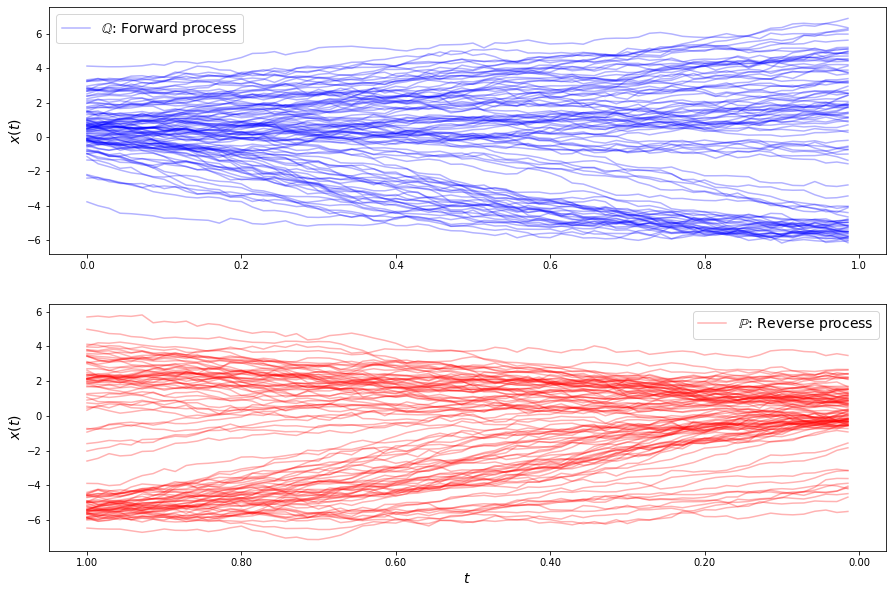

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


287288.8924119804
290906.90952181234
277170.3335171857
276025.43796639214
271951.29252663127
267711.3946816415
270116.7338212811
267488.22573259566
265628.76338870474
267330.53995199373
266876.8078725678
264793.8199794913
263914.2712087212
264674.464399472
265083.30619380064
263741.65098716365
262352.9856671051
262329.4381370074
263068.9380753499
263282.4266616311
262294.5672954519
260859.0052504395
260432.8254490092
261184.08364076726
261616.58086528425
260730.2488999246
259479.14028041935
259141.2464236086
259527.58989169085
259884.599075552
259847.77796380495
259130.81245559387
258013.3455461432
257596.4346169357
258077.38319937506
258339.59254026203
257982.3841404609
257310.05749287043
256505.28950113364
256348.9621089453
257022.96968578675
257191.92975647526
256630.04582525633
255965.2468015296
255482.2647114129
255935.3612952486
256521.63916902518
255984.2757407295
255371.8777276242
255290.51989966666
278867.96605133713
270024.7809774083
255722.3374685737
271345.4754709996
259972

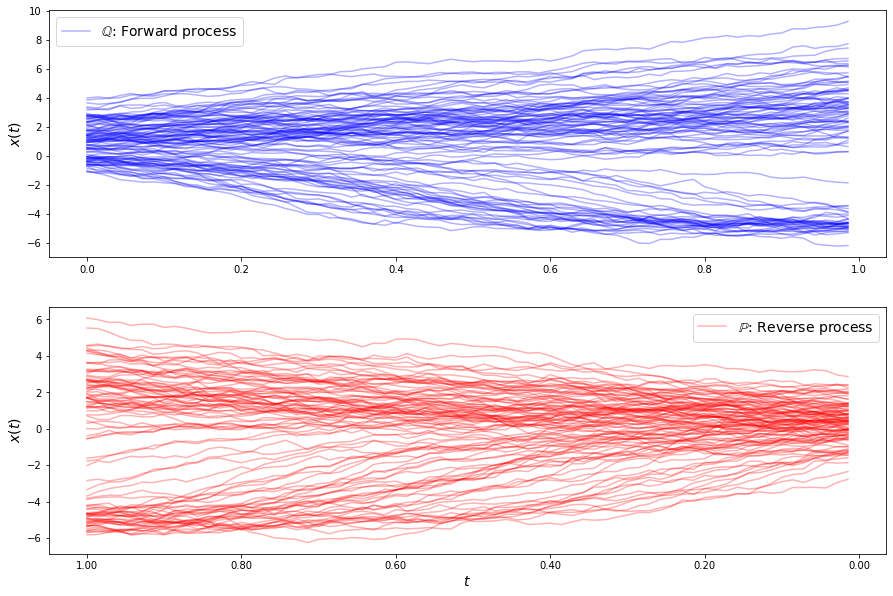

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


275203.5068727147
264639.5630455541
274517.8912726295
262564.75135066174
262656.8028754291
249884.7923098643
254363.3010213952
254696.79073173797
249326.4439137205
248746.32230516695
251749.97568600887
251205.55875222615
247018.93984385036
246031.56954278593
248084.98229028325
247878.63417666877
245216.69885842584
243613.49391058084
244748.30899781192
245619.18614033694
244699.85936656926
243200.4522624351
242468.93884550346
243493.88249394897
244022.02036510207
243286.57058481366
242070.2827575307
241455.77564952947
242173.95705780585
242503.52880767983
242371.6203851222
241305.4997063728
240929.7215334113
241177.54809912466
241899.3677206517
241999.09583041925
241336.64912090343
240584.13174877627
240527.77427113894
241247.1056127092
241506.0138109072
240807.1427647624
240001.09252504038
240315.57685516225
241112.74542617518
241101.64790772722
240234.8849127508
239901.38487765333
240719.019264239
241023.05335379718
281293.8922540393
253844.87248992902
264228.65352772793
256501.042203

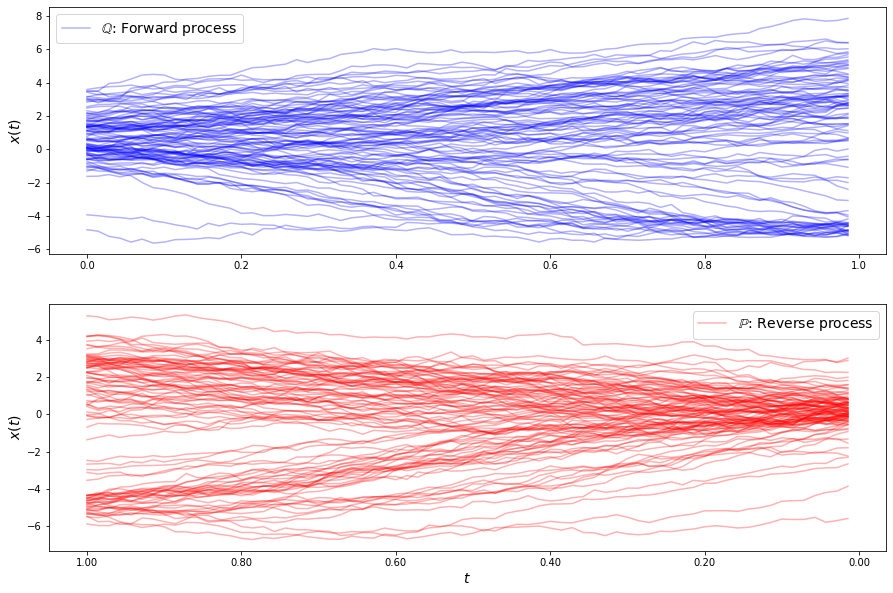

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


283642.41734064184
258909.25118499168
258249.63560231152
266745.0990195562
259329.17879654487
262443.8742396099
250838.0113761689
256937.41871902652
251223.03025296677
249529.30220995971
251533.01800791163
246945.89047729666
246979.22650142718
246750.70109393852
245638.88293324233
243212.26162779692
245387.69466473872
243058.17959957413
242912.3502333095
243670.62960966458
243308.19108176194
241833.76158372097
243876.64060168684
242061.42833441435
241896.27478869722
243040.64225433284
241520.29154260218
241691.9443335505
242154.8578303187
242236.15160013695
241330.59850106947
242111.39476627007
242787.5676397186
241618.66887688136
241798.951149915
242112.44309803506
242170.18457375752
241580.91838250676
241045.4639521596
241855.07235157254
241745.6290181352
240937.99531668948
241121.54790318912
241467.9147946664
241599.34157076458
241232.56025821972
240903.37251033654
241626.5960876369
241715.0603180824
241067.1343112575
291196.6015345354
259834.23425348743
252014.98194426755
261539.47

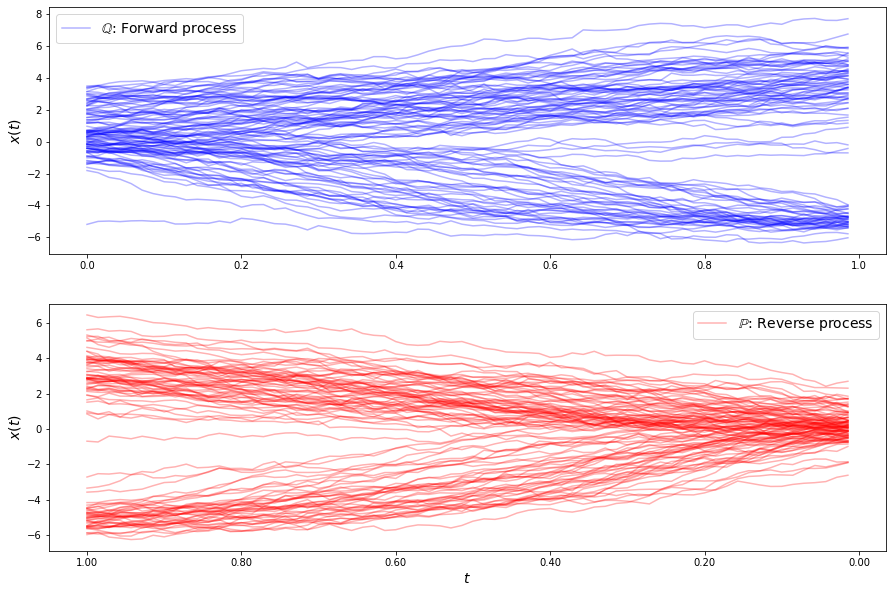

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


294089.1074774604
287295.07598903787
273558.2972230896
277657.37672687846
265552.7627552645
271258.0288460902
264496.7278842372
262778.67926443927
266997.05776019394
261466.45917822578
259447.8543547885
262607.5479598631
260988.96493577483
257281.03727157632
257881.02122952888
259252.9403950368
257563.06151251937
255372.96041798318
255082.31728587818
255729.71759184357
255121.88539408587
253130.63686228596
252108.3020633588
252645.72339574114
252831.4688760748
251640.39573198525
250374.3980250106
250486.31298931333
250947.27006304896
250070.0859798619
249370.16351656834
250267.78109338964
250591.66782610823
249370.35723914354
249140.1260060914
250267.13518307454
250507.5731084462
249749.23008144385
249600.9169754569
250320.83683271878
250568.93806600527
249742.33939995605
249509.66404707957
250253.26259846103
250309.47299405863
249551.66496199125
249087.9504793762
249308.55923629442
249747.4548883879
249514.68045540788
286267.7091230884
253085.13948409856
255933.3742426546
255855.93732

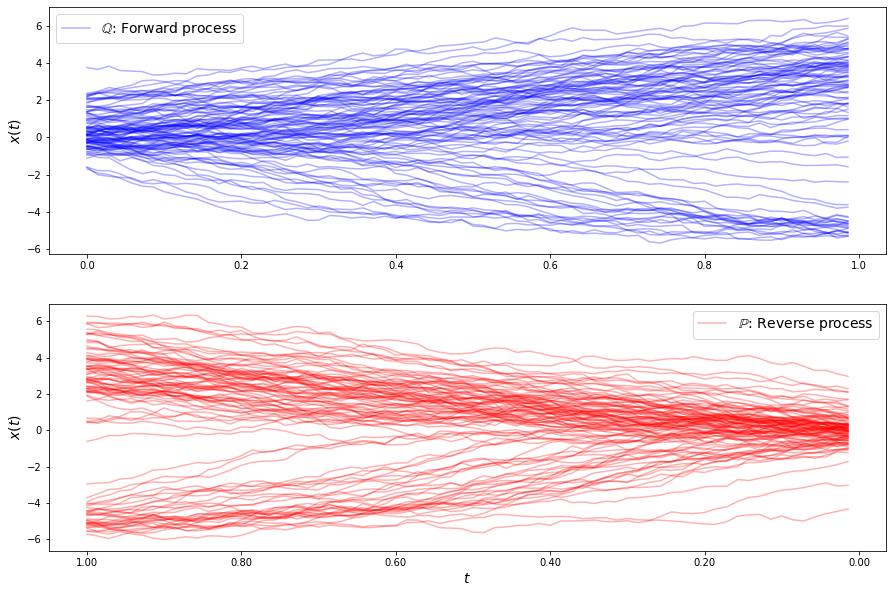

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


301180.92230783874
287108.02152327576
309114.0434047115
275400.1612243441
286999.08110768587
276918.40821150714
273028.1320156016
277523.66629826644
275865.64388461877
270694.2446296661
271250.7958379354
272829.86988672905
269976.02758124773
267411.99728410976
268245.41619086405
268414.5104606455
265635.1549944237
263737.6888905753
264835.59071032936
265478.3763981078
263184.7255757122
262044.6710916935
263335.9415886634
263270.2735567995
261212.1252910395
261005.02272320972
262408.3412025521
261984.99384694462
260566.398942473
261183.480697411
262526.5693256504
262074.95328987503
261076.80657546502
261715.7876655961
262656.8228914753
261846.07770630228
260893.491466818
261370.3855907793
262016.90758550738
261471.0894409207
260591.41807383904
260760.16850243203
261467.65188573085
261324.00519857334
260572.52097613708
260360.79142982926
260830.24696916406
261149.7295998057
260888.0104182815
260473.61657373188
300669.15223149373
267113.279421322
259740.99350169703
263651.11976776284
2587

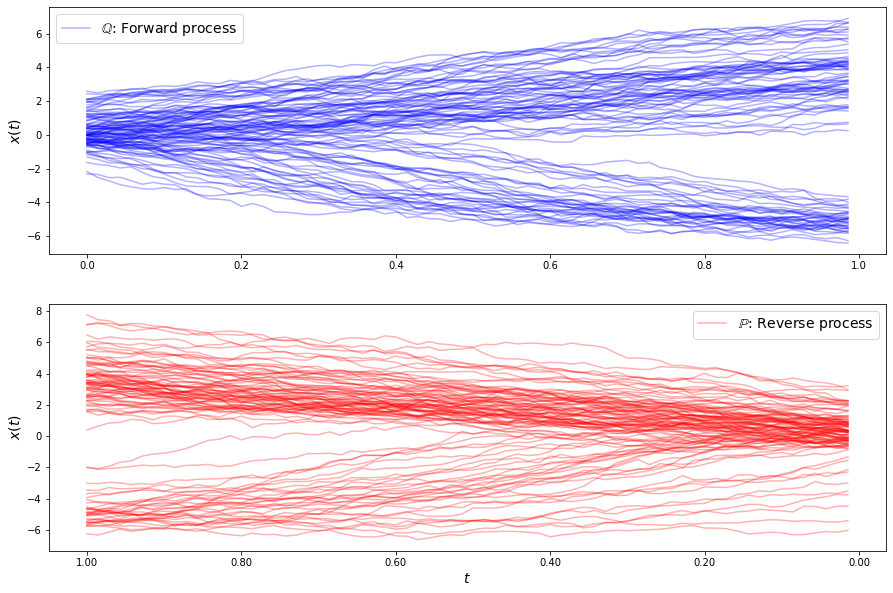

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


293979.86289863376
292603.3639325902
278374.69960486516
282802.2789004789
268467.1603772555
276841.93786995613
269244.40145955805
268362.7150236913
271783.2003318261
268804.62113501143
265956.517578616
267280.7575230304
268258.4972373962
265892.5770856498
263944.23971176223
264570.38656391425
265475.6897537889
264458.2982682557
262433.99797404686
261564.6399029956
262040.7905180588
262057.8157581411
260587.3818485589
258928.91153207305
258495.3759534445
258786.7952014264
258461.11915868823
257282.64191573358
256015.92648500708
255492.0948691353
255832.29921324918
255861.84285461187
254995.74129951216
254401.2610918177
254613.88084645616
255191.41221891769
255306.7130372602
254750.7551394578
254653.00097814132
255023.0590490027
255516.49142483983
255388.93364740492
254887.4532635134
254892.8331619178
255247.55352855142
255608.14834158754
255369.31788822182
254917.9609215125
254867.2375290763
255048.59239733202
283086.65249525884
277932.49998703273
266434.92945034476
260827.07629737747
2

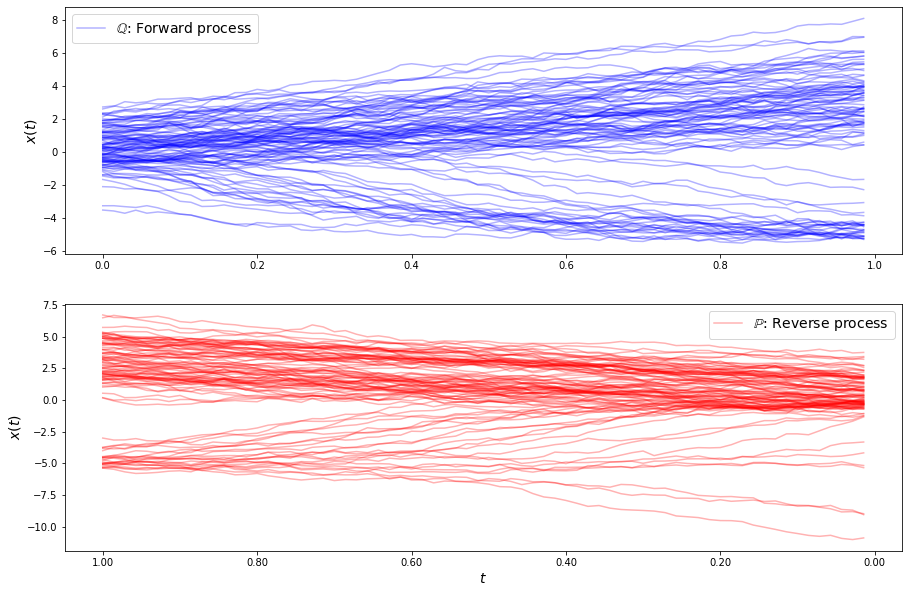

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


278294.6094100741
286216.26633171947
263321.2324884437
277396.797397378
263549.4666662028
260298.88224470784
264330.8622670856
262533.47023086203
259093.8767046984
259737.78528528663
261651.21099643293
261020.58640064567
258451.6541195829
257113.99954047508
257621.96852969128
258277.2359963967
257278.27108011596
255330.4923891817
254280.99299545283
254463.24882002192
254752.95649439917
254088.38385016678
252528.10257908667
250984.58610896452
250317.26928135206
250275.44245659176
249881.49086469435
248628.71193358768
247219.4233542676
246397.33516398864
246097.11346154084
245666.39101491225
244820.70695478554
243869.5565862307
243354.86056217563
243197.72093623708
242827.48737387918
242327.27855846123
242204.94531891396
242460.13330335415
242656.99600255355
242545.3794115201
242426.28878141148
242716.41647010163
243207.76388318173
243207.81222457215
242740.73600390487
242511.834556322
242659.85884526034
242811.1827409365
265520.647443326
291573.33259773406
258354.9800158298
267349.69861

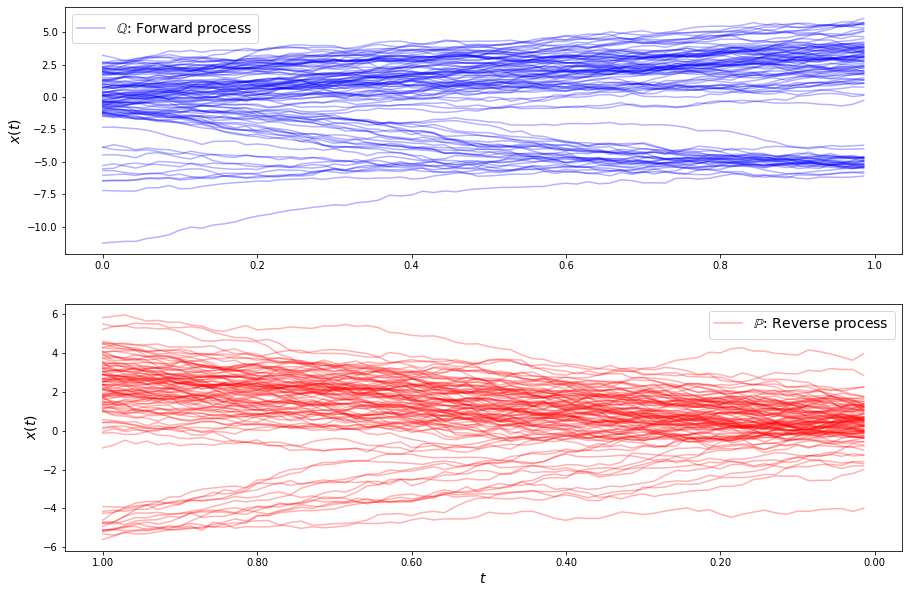

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


285794.7668509517
283153.4081074009
274759.05536325916
279640.71264674445
264366.95448291715
273230.4369849855
265316.70852023165
264594.76204234513
268655.9425543543
267344.20390965126
263731.9286070645
263615.55738877086
265728.70359630475
265868.50934906374
264024.86181094474
262866.43783941044
263205.8155193677
264191.2571130454
264678.60195941944
264084.2402248528
262916.89291667007
262195.9197348375
262330.3868222376
262918.69995992986
263319.8372877452
263110.9208251439
262356.70067950885
261716.60034672916
261722.5137302896
262130.87833972942
262472.39178431465
262632.5473995843
262488.5678829229
261932.68932976172
261402.90534499363
261321.09924105497
261503.87793282038
261759.35467157737
262024.31321021647
261927.90901113945
261470.1207879028
261200.22369621263
261174.7207105103
261222.17759041133
261443.4011017653
261600.55730936932
261420.34774102212
261211.55712240087
261093.11192090422
260928.56334369155
273364.98166158143
253479.9395777671
261372.50557775854
241621.03469

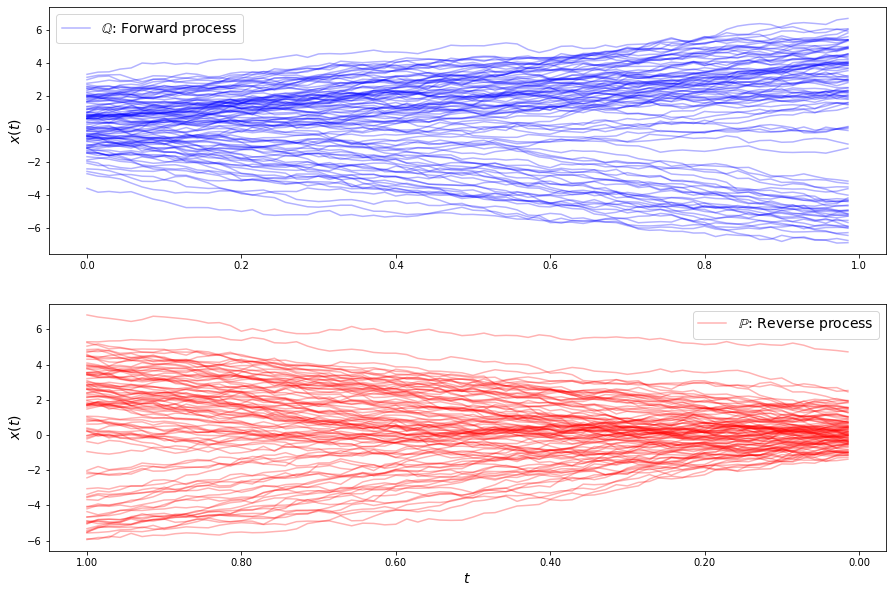

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


292193.87607377366
281716.47223862977
277790.3657775583
264300.15503675665
271328.3590329508
261371.13267780805
258847.29330797607
263829.7522724308
259866.67991773837
257039.35754050995
258675.56321985615
259950.67998336346
258533.13078362698
256080.31161326886
255415.8552263881
256907.93189722626
257874.33698617146
256576.8988615857
254619.54108705555
254133.11344196455
255127.46272095855
256030.1056442472
255820.38283642882
254925.1722105802
254121.35106381704
253838.09763218858
254253.43088567373
254933.0693289959
255003.68555499054
254333.06567918265
253711.81689499144
253645.78044227243
253913.95072601258
254207.60930012853
254432.62500481377
254380.7431469246
253923.33268219928
253417.6234393327
253197.21310583124
253148.35647005128
253186.93537843775
253435.43348053703
253745.76764192886
253795.2769123716
253634.71931967212
253501.84804993874
253365.88425468426
253200.02457607858
253220.04229404754
253429.51613810137
277505.68631158443
279303.6059339325
256779.75547710937
25963

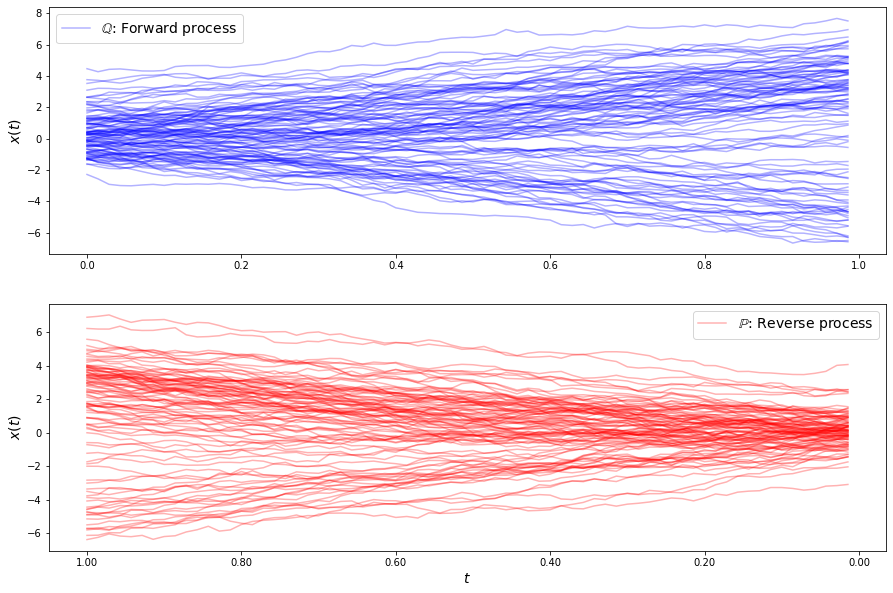

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


277578.7384937159
255976.2574115926
248879.0111324671
260987.14873963653
248715.32607567206
252850.29477715053
246731.8585041862
249590.7334040355
247916.34705331328
245054.3274020572
248212.46369497676
245956.43129456876
244927.42063798988
245624.89274013566
246098.66307585945
244684.67230740256
243510.61237730226
244839.37290902896
245204.9016010328
243677.64706094394
243384.01260559738
244037.5243490636
244245.45206622547
243929.58768475242
243171.98744030923
242674.51975506198
243130.8680592175
243714.1073289795
243445.92424958682
242876.0740247282
242668.26827911442
242641.94152138976
242670.7265615664
242799.92914351833
242712.12424860947
242371.43669902498
242291.92403007153
242425.01106132465
242349.3987981386
242171.47469222383
241980.33426832804
241656.0945421931
241669.59525081224
242151.66841226438
242089.83361721688
241406.83496472856
241206.0734326694
241439.30530866946
241510.4145358769
241416.70914614425
270652.52703408105
262746.72492382966
249909.6134982966
247835.197

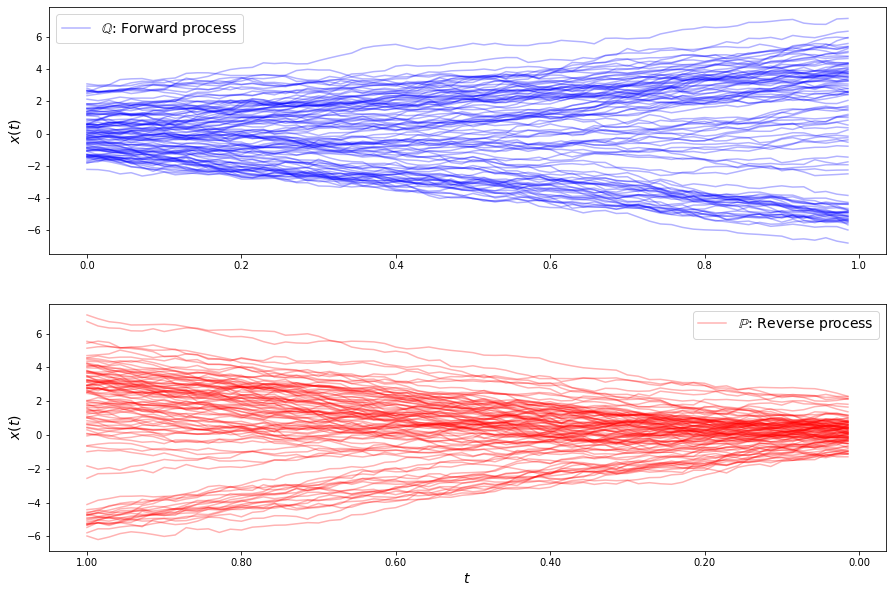

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


304470.5721607243
270384.6859711446
278581.0464404168
261975.2179951587
272654.01004627225
259657.35422857993
266984.62658464984
262481.44573053595
259332.27031657664
263247.6222296408
262509.1760395076
258990.4240546024
258917.0885967787
260788.30604945158
260676.4305260401
258839.06436384513
257972.62974022765
258726.7147409937
259782.78033110197
259838.29923795967
258880.97383428528
257936.02509863843
257739.05367730875
258252.72675143616
258755.31111619034
258710.68587670304
258189.2328144795
257679.60347126517
257558.65683392278
257856.78318382142
258472.47834175668
259272.3914572635
260023.92995689058
259693.09204511228
258158.7019573315
257655.84125226142
258621.024481261
258543.3973955097
257679.01501340265
258312.86941499123
258425.9868858573
257462.2399441343
258000.828916239
257879.8495368856
257474.92669611317
258068.23001941384
257402.09017120986
257812.43920799711
257379.9953604829
257412.5925787118
292218.0097044827
245099.76448192197
249290.7724103795
247764.07638048602

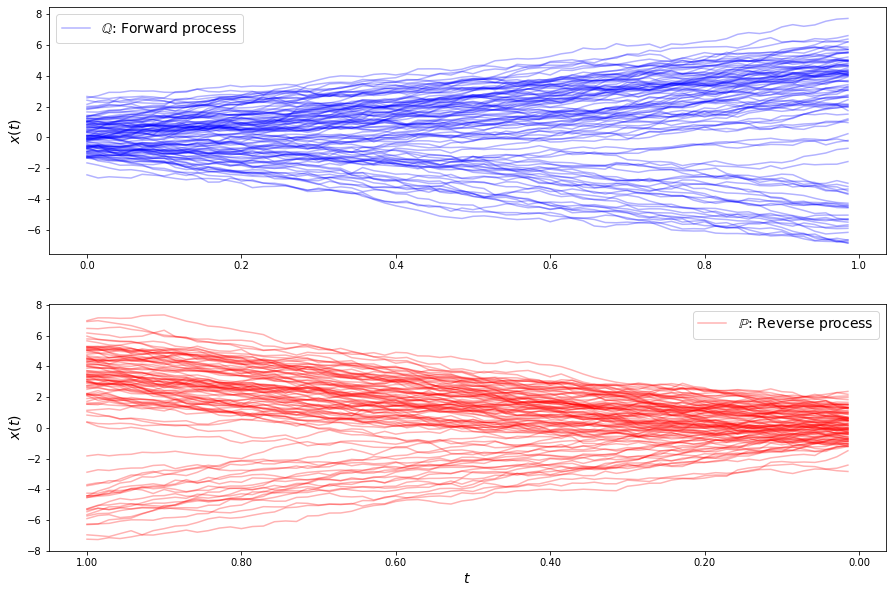

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


301906.59422557225
278499.2781507386
299301.3311935937
272696.1388788328
285005.5792620902
264362.48611380975
263213.67332185333
269249.25817878044
266571.5090733238
261807.4129374706
261994.0690236719
265192.5139088845
265625.377088253
262783.80947917415
260156.21091286605
259911.0579747348
261845.53593195986
262685.10533413704
261488.60979694437
259599.5845997757
258829.0254578704
259683.22238840268
260842.60157684714
261671.03890578198
261166.17437128216
260149.70496871395
259100.31232588371
258799.59501949965
259193.612826302
259826.2803495332
260282.06027309824
260067.6270414617
259591.02798357178
258926.81002711563
258696.476331867
258629.07641666723
258942.73942720966
259151.10832452166
259399.73810527404
259430.30851592292
259438.3631952002
259373.58436517935
259275.37216362858
259191.87946362715
258947.13162286673
258787.5352820299
258432.9661271179
258345.0160719501
258214.88343710612
258391.99859644446
297039.5813442634
258934.20141750987
251519.8847948056
255133.8305492262


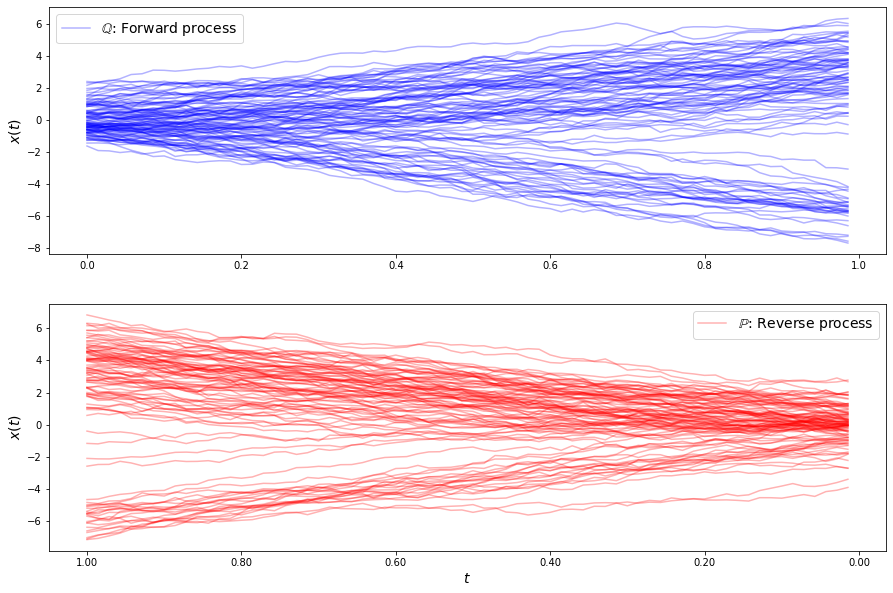

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


295894.3225496238
269982.34361193323
273200.69199017156
261761.06122662112
264675.9830457799
258926.10293818824
257606.17428986676
258738.79523236633
256696.91194472823
254204.37973173673
257212.27650438767
256340.14027051674
252575.60998668318
253751.5309108313
256075.93355954884
254545.2781257322
252138.50542873546
252372.90682592202
254081.26220572842
254311.44791820523
252847.4571408091
251758.62347758666
252019.31781107694
252988.48487237724
253560.84835550893
253203.19783803227
252274.8063183374
251561.68422499532
251562.0508371022
252136.56965127966
252670.07708701084
252637.64078037994
252093.3706675821
251512.87450282357
251296.5598125999
251505.38128962103
251925.05329850753
252257.26433500362
252293.68608611939
252010.15477697633
251559.9449272241
251176.35821924178
251042.49688733634
251191.7526508867
251486.21255483892
251695.10758262652
251646.86685501388
251353.89293153165
251001.03706547705
250798.1938390922
290221.65927441674
257304.34216940776
263306.47984948615
24612

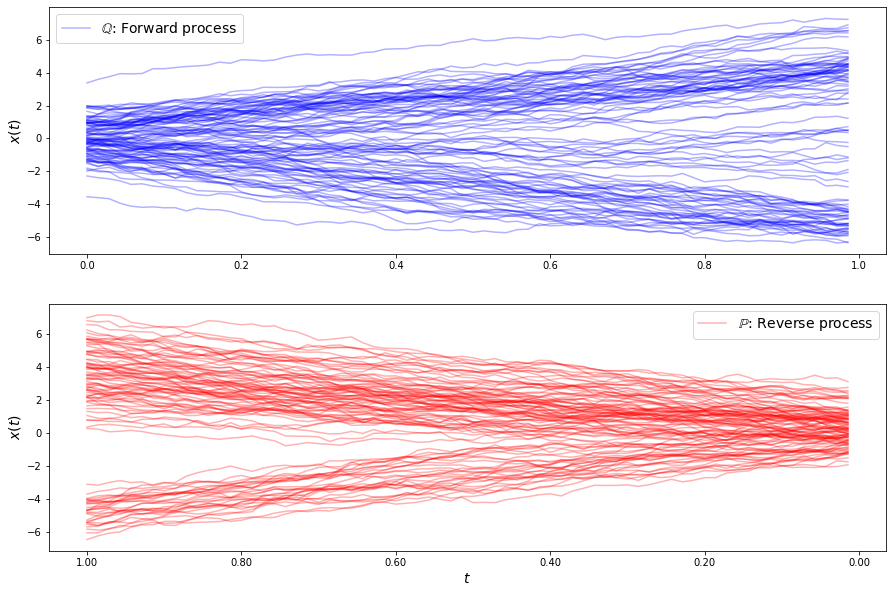

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


281646.5508857117
268205.56748853176
263773.3041641604
274863.28937743395
254877.71147542656
265055.14545192476
254927.29716424705
257362.22297709185
259649.50304848282
255566.81285012164
253991.4881372035
255750.74294586942
256388.36742198784
254503.6726172986
253119.23606793836
253739.26505590777
254678.35847895546
254731.40031933953
253629.14111006123
252483.38199757118
252295.79458823384
252705.90010640526
253175.32744801528
252839.68176614476
252100.69357749162
251775.50837441147
251973.3693716867
252503.91647428414
252583.95958060696
252348.15263193747
251938.32977744483
251780.12030742195
251922.90376705123
252068.54612440543
252056.24187453615
251678.56403691153
251412.2240656874
251318.7522154897
251624.39429209917
251893.85960852564
251981.99605320237
251724.81576641195
251413.65262297535
251229.1731606683
251291.6239444586
251513.8409134667
251721.72206696594
251805.73673713335
251682.22613904136
251470.71377763624
282868.11190112634
266299.9610862638
249063.83171986567
2557

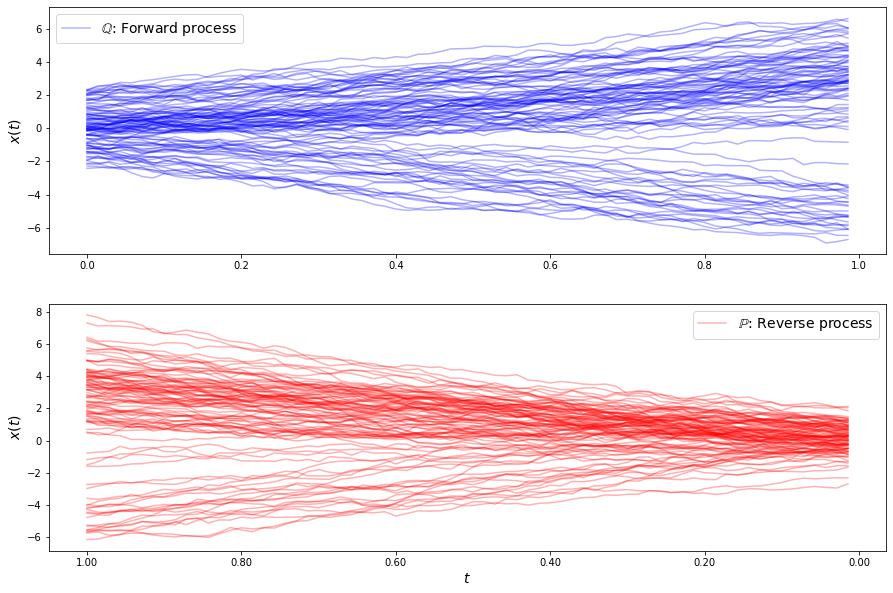

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


277246.76716208766
268548.9870474061
266628.74597067386
265939.97758199926
258268.44382289017
252786.7997902896
258709.91761737876
252387.67857808684
251964.57950565207
254472.43689140887
254591.65423055243
252707.8379079105
250544.79216844746
250711.02959259317
252660.1853323634
252660.4889636552
250583.65799487146
249682.89036638557
250501.24049591174
251195.66683353568
251342.6078056706
251290.68313174997
250537.18301109053
249409.68287480198
249162.40350604756
249806.45937110155
250207.4349307033
250158.141533339
250165.33975502173
249988.551964348
249375.7464497991
248971.6039097408
249251.58998868492
249632.58684350824
249638.79631502752
249688.5108547012
249893.4905680609
249731.10982983295
249216.91307272098
249010.73948141778
249153.58921942592
249123.72835785995
249057.15209245548
249328.05511117063
249551.46809288155
249306.08709967945
248990.0430736399
248987.67472969455
248945.58779022348
248719.38726504496
282632.3147091842
267996.20568685216
242018.73203601775
258060.095

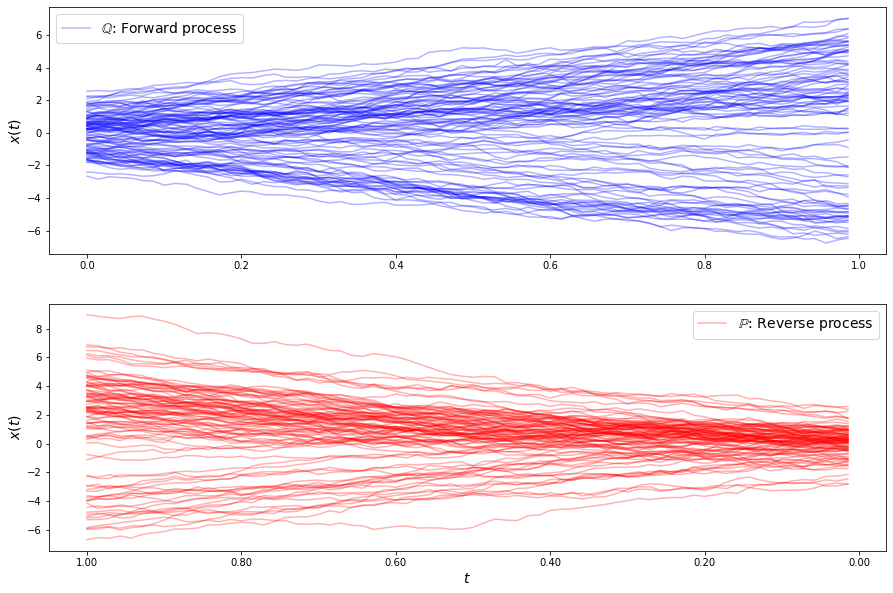

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


286358.37897015957
259149.38771528078
263678.0419241595
263266.73464781046
254713.79464310932
256491.44811189696
255776.55318835622
252372.1076722329
255834.11740418832
254354.17567958124
251787.00121846687
253015.33246135444
254022.44728281
252422.7279991143
251545.56316001125
252359.27025186818
253084.5813821683
252635.26842468273
251630.04579132318
251182.66902523243
251571.46890448264
252139.63457774225
252091.9286342191
251463.16200374492
250954.25161385868
251000.74386347324
251407.27330638838
251668.4446916146
251517.65535022283
251132.72247650515
250870.05208828105
250900.62098461424
251090.45819955185
251150.30042842356
251005.69529281824
250860.29132376646
250980.38135526015
251286.28982748048
251430.53954569018
251097.8126085444
250535.49199866375
250357.75918860684
250716.6387227167
251023.3268540221
250843.3551593187
250506.64113143575
250342.23447687505
250144.40033476226
249997.87753710765
250230.78618425835
292258.1304139662
247221.2633517517
253551.89313580602
242216.4

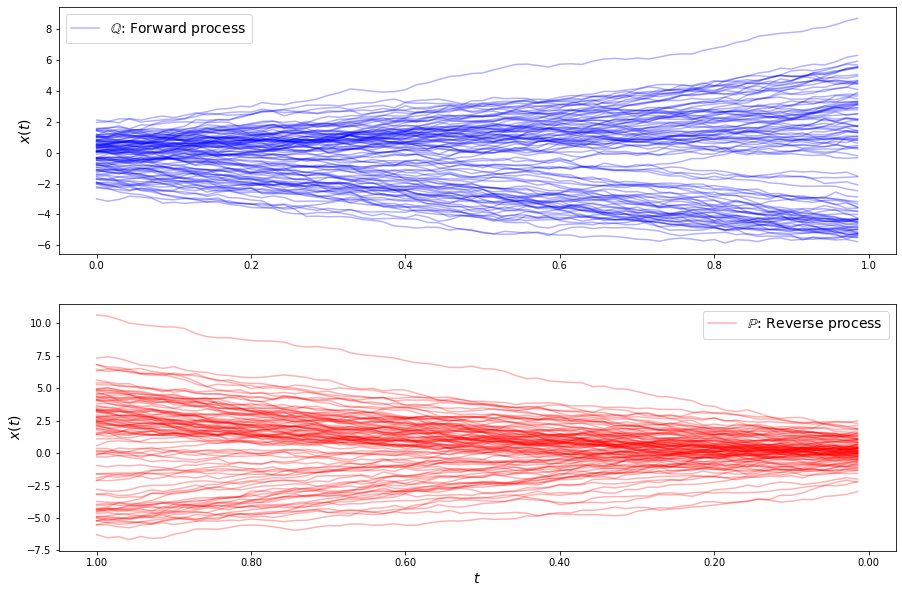

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


299385.5680214412
275446.6101539109
279201.6038445749
273877.61304785847
271765.7578933201
266567.2785295624
268445.45798545395
267554.8852595693
262824.00674042094
267099.9868214707
265449.09091464255
263198.4566010048
263267.55918886175
263691.5488282649
264819.65608070145
262597.22828786005
261233.49267876116
262528.0873088059
262839.3019334799
262677.8612886524
261808.62854388353
260603.2194525142
261230.04830818088
261853.02718279176
261768.3198924713
261825.86095241967
260995.60129128318
260260.78349193494
260630.46388055285
260670.71831427357
260937.6398815837
261234.48284020065
260546.76832339418
260327.46306741863
260116.73238724787
259899.4393406979
260482.83804360445
260588.53306972884
260457.65558929567
260447.3852113167
259857.12317883113
259635.110819087
259839.80797989227
259752.45244174066
260078.56708421797
260249.22488506447
259852.77669306146
259730.87487518977
259423.53890595946
259105.5768855018
266322.9499159623
253552.9057134188
268014.05513714
244206.42289347068

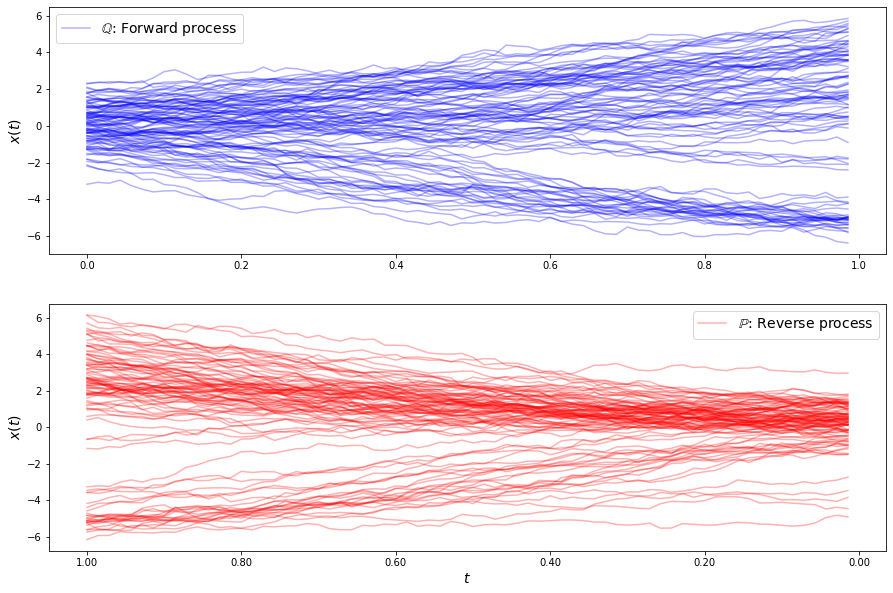

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


285329.4373696147
271576.1516248288
291201.9973398817
262770.5182044406
276065.8291318872
260607.7346304169
257268.0125317623
263160.2122390851
261685.59949651547
257059.6355450294
256583.09512231257
258922.95929971855
260107.6052589257
258370.9204461564
256146.18877110502
255293.7429843438
256272.44535409394
257344.74780874152
257234.7996705841
255933.14993200422
254706.6711792575
254367.8891666678
254638.60454073956
255332.98876086678
255689.61340013705
255488.29580820398
254987.64299319644
254312.38387028745
253692.22375579565
253459.13014755995
253656.48020239745
254082.72021305215
254548.65421180672
254987.15296759317
255646.3640446247
256810.9788900261
257790.58188879865
256611.13033246098
253795.4024653013
253680.98850936675
256177.14959290612
255909.07095950685
253668.3008804437
254988.4850437514
255848.57103677507
253513.37154625903
254416.30387350346
254446.28804790802
252777.71015759037
254303.91664298502
304772.1350925809
239312.8529607656
250404.59785639646
235585.38376893

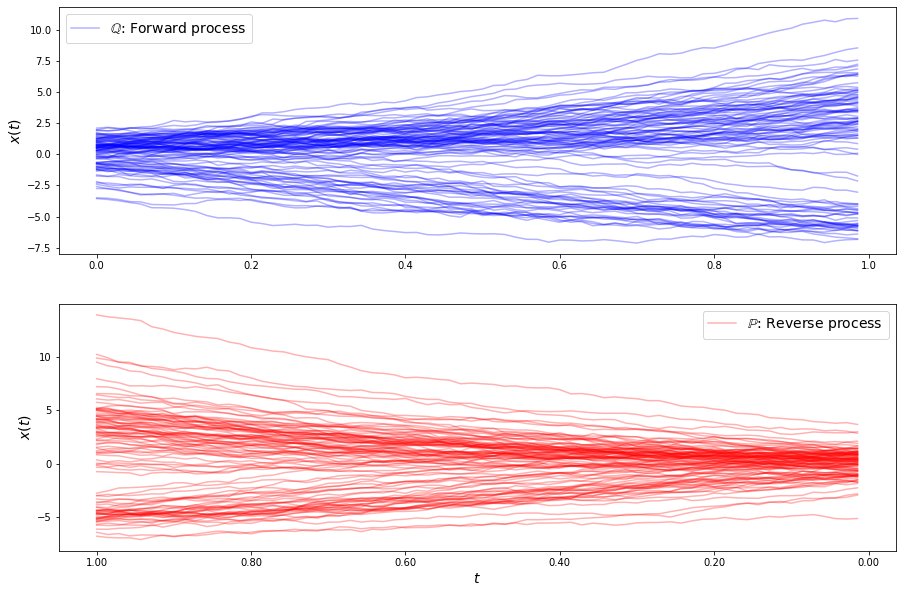

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


283160.1832659406
266888.0137662563
258533.54014742724
264370.58984979085
254290.39852515142
259709.2522905172
253730.65229213535
257496.2203734405
254405.0972162825
252808.18790536173
254303.01743342684
252796.05295252695
252092.1121707152
253101.83111633197
252535.24138274405
250779.85213957657
250378.2906292156
251072.13972437332
250695.1077323402
249820.65939631622
249734.8859206229
249597.79221051614
248973.4715317691
248630.4448064399
249086.4687640021
249276.65468551248
248493.7968969425
248027.55344059723
248537.16133929137
248846.56814581194
248270.61306552083
248010.05207053735
248466.64743499845
248385.37496765028
247757.37936410302
247733.36286791333
248235.48117705015
248300.5078914453
247811.9609163663
247630.76951854042
248103.17104283161
248634.39472899667
248723.45949410094
248553.9496194701
248000.64029239747
247528.90495442867
247620.0197566501
247680.78121623746
247258.12295014408
247592.884617177
300081.7944556824
255239.95523577847
260644.66409441057
246125.649741

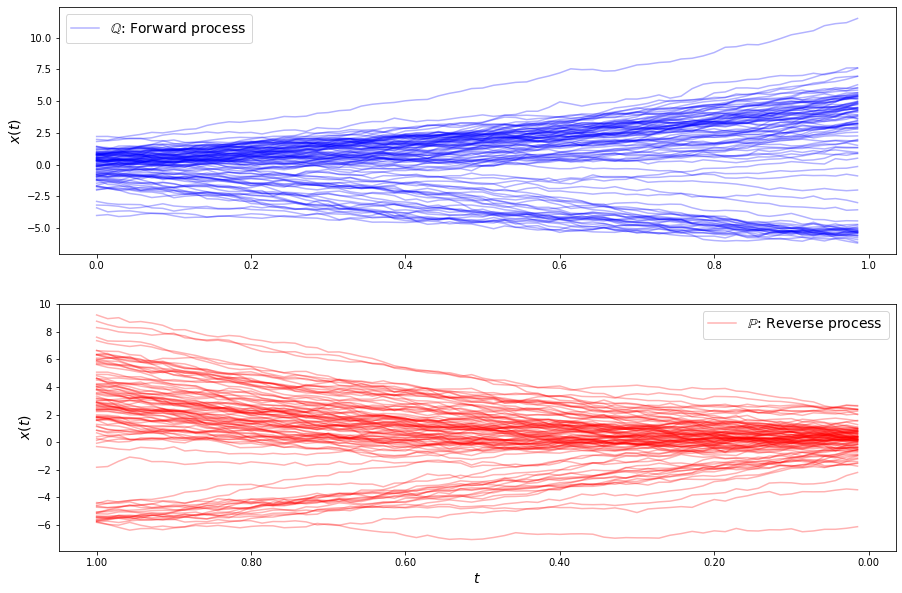

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


309187.7105113829
260113.92768817573
264949.04232372204
263506.8785399723
256765.91841587494
273824.1695589291
321229.45576289145
273530.90179928887
285199.2529537908
253984.34009270632
266196.42792275455
267915.13549004495
258189.8115764829
256485.2193526524
260987.47225380508
264123.9454717559
263100.2857402623
259580.3316133907
256272.6568025248
254792.2556769576
255344.95875976817
256840.00773725042
257613.50499756465
256743.87879793788
254814.5791425545
253379.58792900865
253543.57768922742
255028.4339983689
256478.8869686286
256660.8259143169
255555.25045170396
254066.77402513003
252961.27893450763
252483.50914703988
252553.37307957426
252973.38803810684
253488.27099861053
253829.8735825403
253811.22654426075
253423.2092820634
252820.51528708392
252198.20445780485
251680.10797807176
251311.65677845513
251121.79923480802
251133.0623977488
251284.1492496315
251378.2011421379
251189.58198612067
250686.09589346885
308981.5531580984
254168.0675673313
255753.96034417217
256939.34488045

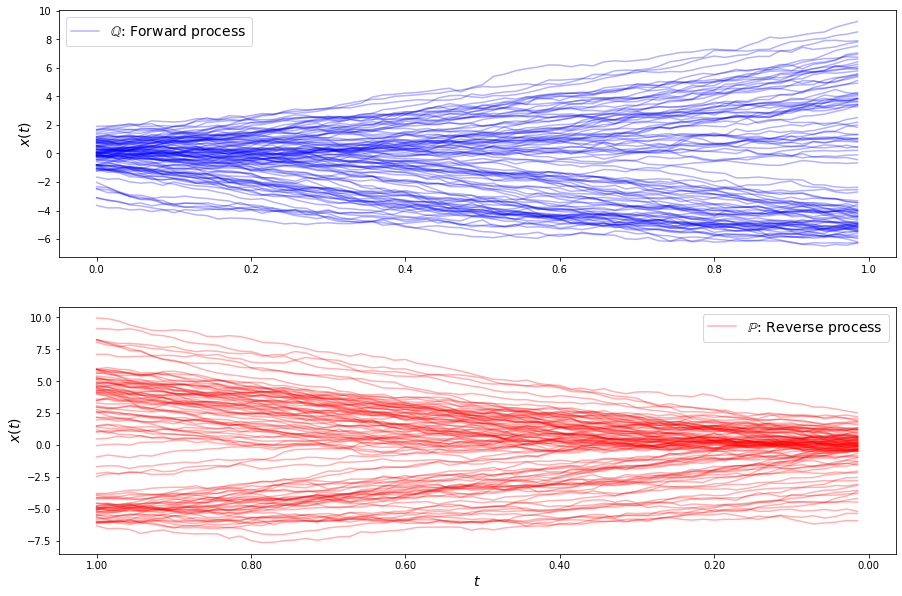

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


309743.11342000193
272079.4997215486
277686.6731946847
275491.46815957373
270545.381240571
266168.88581042655
270439.78134808945
263464.4068017528
265720.01591398235
266217.56240890455
261768.98467507964
261301.07811550633
262765.9424999559
261913.5276152898
259590.16089448705
259811.98631133733
259978.05028954864
259562.9663716259
257897.99373752606
257292.811527954
257999.9616130932
257846.0378073947
256905.2449077354
255620.4092067438
256167.00359031867
256823.3102964722
256446.4192137189
256235.61064152754
255911.96364062215
255486.1385469746
255342.27711264946
255657.43487383064
256074.4611885583
255767.38326152303
255430.74380794712
255419.57818066987
255296.64042646193
255132.60362365653
255667.262834128
256226.33863332277
255964.7030158267
255812.6208965426
256036.93392353656
255763.54469096282
255278.18763398688
255478.4825820299
255975.0256022469
255789.52561757542
255387.10841056332
255470.0097753715
298773.971088342
264488.1010626782
274581.1129335316
244164.94711223972
250

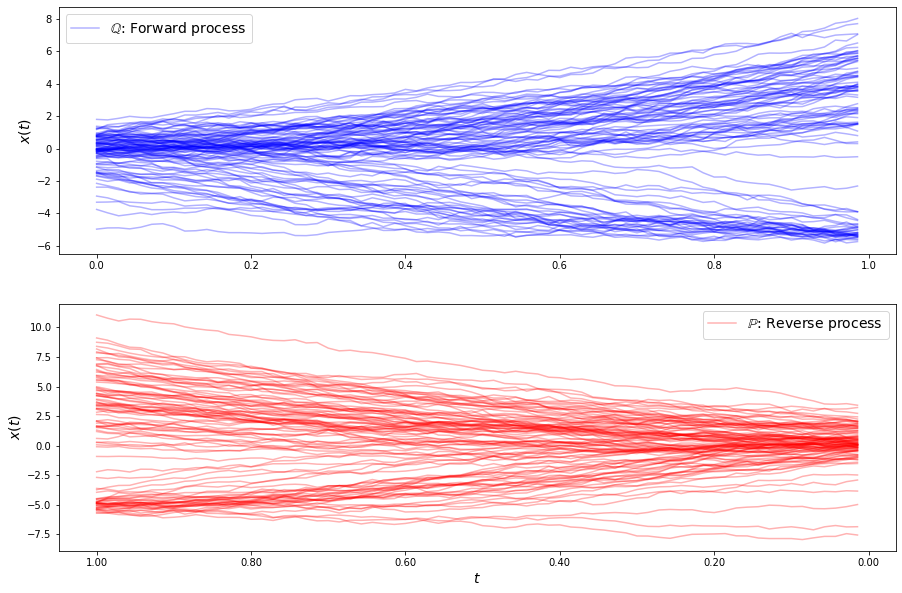

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


297336.6991368994
281129.5134038052
270650.8318468938
271402.4752467993
268655.3067067277
255756.03925378993
264697.0814979016
261517.24309868185
254936.60028313746
257212.8785724871
259919.19202242163
257686.0340759406
253890.9238253504
252991.98057005514
254835.2900065187
255927.41251780186
254418.5011130082
252217.72356625157
251506.57411752417
252208.49138803073
252749.36106217233
251921.33408212685
250118.4104032127
248816.7959285883
248900.19528802292
249719.49578951905
249778.691788356
248553.76003965404
247145.621872037
246645.1114344227
246750.49227054068
246563.48312541534
246017.3575040082
245773.67531023404
245996.1079769889
246068.36485722574
245493.4274939931
244709.59498366027
244688.94764068048
245509.82547175657
246000.90901080158
245548.502764698
245156.9140614185
245518.3899423422
245796.49028330896
245256.62044692197
244660.35367756442
244896.7987881942
245484.25609106227
245632.26080370822
291192.9593489326
256361.05578448228
270181.70776866504
250367.8064326747
25

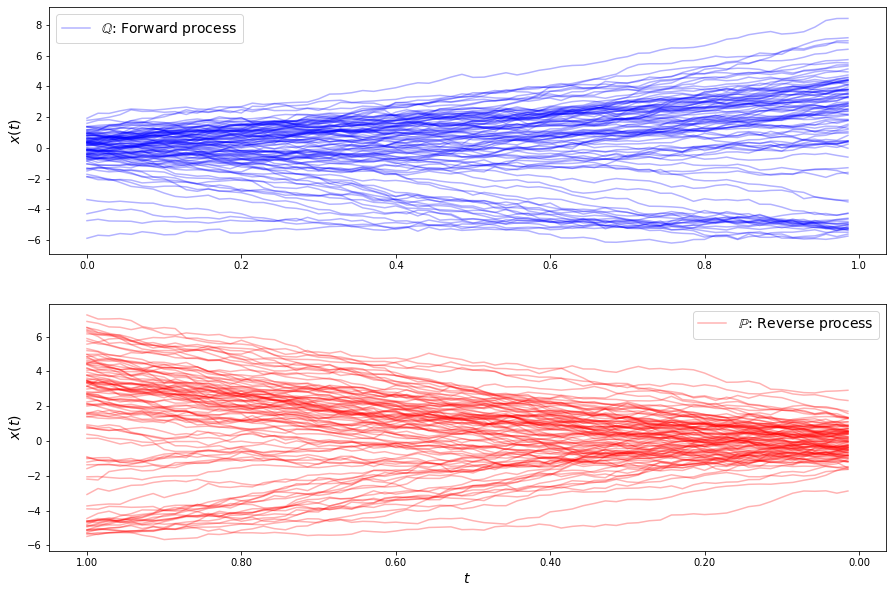

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


292001.5522169641
266096.77300733817
282033.98303342314
251234.1229290968
267080.36333207553
250862.3157001551
252879.21941222472
255987.12738010098
249591.70201383316
248588.11070408637
251655.94616342563
251423.86063345213
247728.03746467346
246832.34321111796
248331.08954888367
248539.13987244072
247134.60602202575
245677.3034496478
246218.55806457874
247659.11321211132
247222.72668818408
245829.19736230117
245346.4292769929
245506.0506037334
245784.30656151354
246086.9107501913
245856.9016898145
244949.4159431697
244389.26938012158
244640.42522696636
245086.66186816816
245225.0651274288
245164.39671223826
245025.37090694805
244645.57831492164
244149.89967539377
244054.98005157258
244430.86464294122
244694.5090016438
244497.15478160622
244079.29964191653
243775.28206677517
243671.91222298073
243753.7698930606
243996.69376488065
244229.08411035113
244195.04256812538
243861.8730070835
243490.65225142613
243402.25069419958
301888.67476022884
256552.72290069872
262696.57601872867
257017

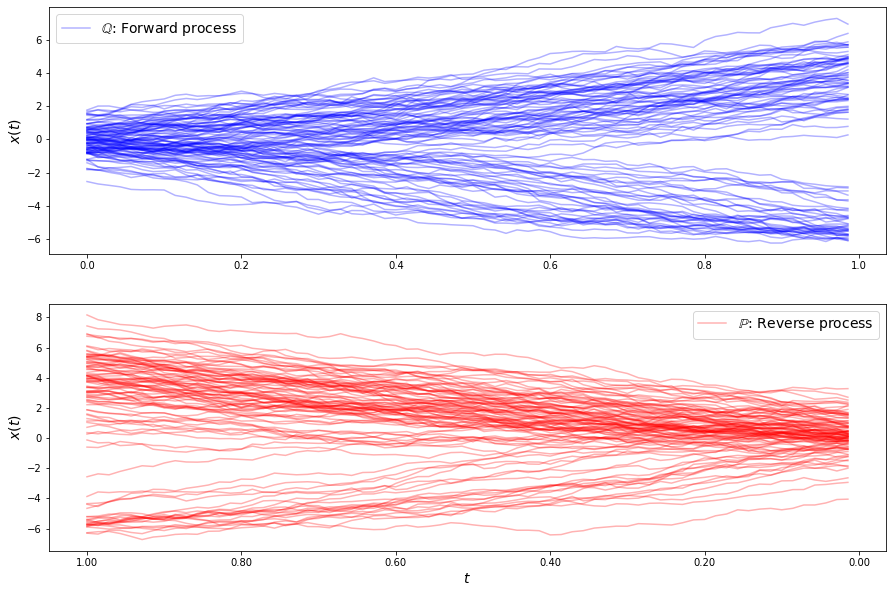

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


289972.7170732183
267213.55299721134
266105.998563146
261910.5438781847
260975.02005702935
257817.1442935762
256043.3421802682
258669.82150466717
253007.90594373632
255481.54782981204
254997.00283186382
251832.55970664177
253050.54899328167
253610.27810858111
252377.30528431648
251095.3019749879
251048.47599172592
251810.09336414034
251389.9554665786
249675.93776453607
249541.1117394166
250799.02962176845
250435.6997778935
248894.46413553768
248787.1051102716
249693.98767235715
249665.92991184886
248722.18774448466
248159.27310052456
248590.53647150134
249248.68640493223
248908.6864551803
248037.94687589086
247812.02088823993
248201.33030076796
248635.93364179478
248377.32481415506
247590.93194853974
247617.51801023626
248208.37527596022
248374.07891976886
247984.47240439034
247345.38549925573
247419.18438328098
248020.2189467272
248015.31285608665
247482.92440441728
247009.6889148348
247232.42317934113
247724.08083023917
289338.0484641014
254333.08435265147
264828.06491590553
252540.6

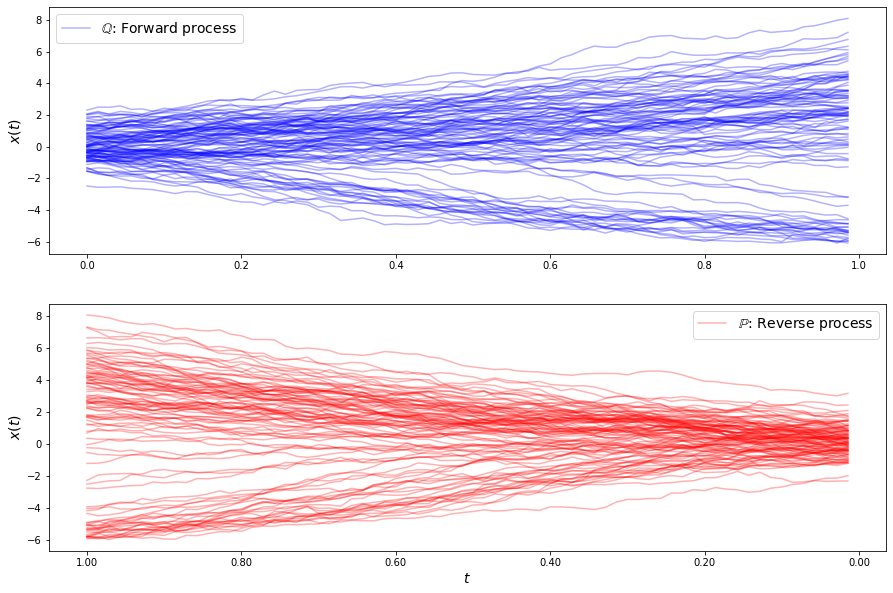

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


312495.66132994415
257781.32608074625
270056.6883626136
266666.06918889115
266945.0628502673
258949.56892627914
264130.3373099753
255718.1579355948
263265.2811810017
254520.88632705022
258830.57098031952
257958.93751049583
254439.2177324588
256474.66246355322
257083.37307083863
254891.27905762545
254179.29385609773
255734.6081950232
255820.94587927574
253757.5712100399
253448.5759717897
254906.64199160814
255241.65892953757
253834.34487707826
252770.165165756
253400.55389901553
254428.09501290252
254070.40749140875
252859.210213446
252419.29768732618
253042.32260963798
253768.7222048475
253720.923205854
252943.44458675134
252207.46561623807
252147.9222092667
252653.98387312653
253049.12499173338
252822.8579405039
252191.05392162234
251795.58681261106
251955.38094561023
252393.18936511446
252609.34924777452
252394.12058957655
251958.43156849133
251652.41140418296
251659.68863686896
251906.84902532198
252132.15104484535
292859.83709507284
255183.55430379944
264578.89596759673
249081.2698

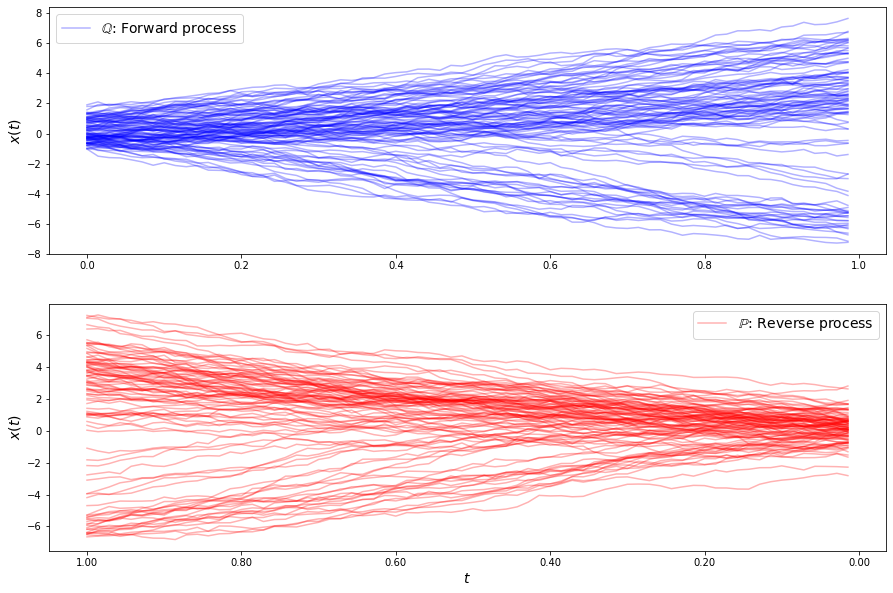

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


308359.33994564327
276605.39118777856
313788.74015386833
261602.34934140346
280298.7051641974
273807.44135374145
264753.00814701244
260705.48520956302
266340.22410060413
267228.0439591486
261851.12610182914
260646.8717345344
261288.72099184358
262429.356531445
263867.8037241171
262582.37567102554
259727.0444041912
258849.86686865045
259254.2908444748
259518.87224019278
260269.7376939135
260855.4957479847
259703.29876888782
258207.35807627114
258039.72284477422
258378.02297318075
258492.27319019445
259036.14096351818
259914.03810489204
259868.71869507313
259004.38259509363
258466.68040218414
258157.67349937325
257556.78520151152
257225.57420075778
257740.0217509709
258347.98224435293
258302.5503772097
258132.07852112045
258127.345573274
257773.0473045788
257117.20552550047
256940.4529725692
257311.12432524544
257489.12677658536
257444.91490271638
257709.4355136081
257989.27082189423
257707.1044216543
257228.17479778038
293756.90416319633
256427.03987222596
254807.01793295564
248428.8106

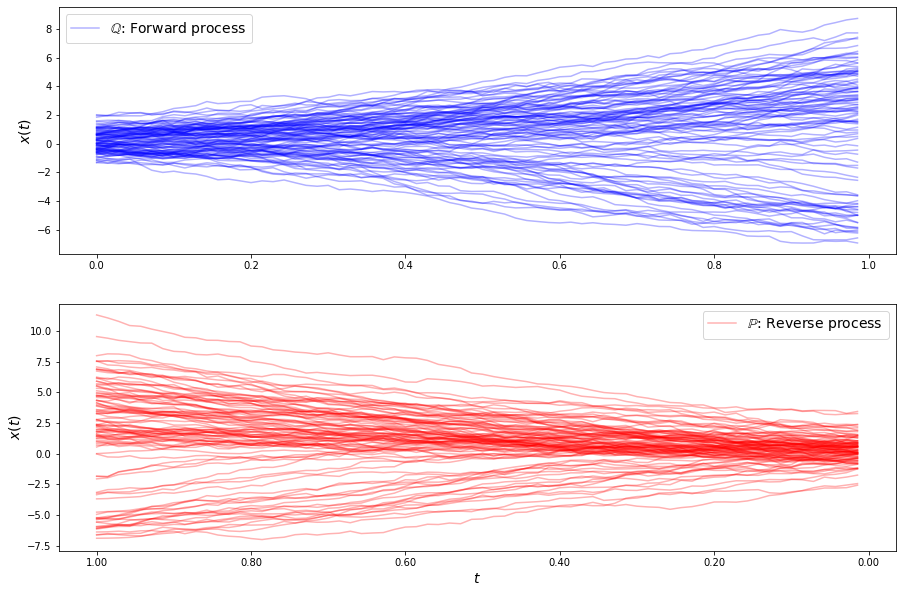

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


308175.36012262286
272417.37730851467
275485.37861805735
259951.32221361468
264811.1059301598
264036.7401162551
258187.04230427058
261656.29668318914
260886.20655241684
257851.59252615203
259317.44321969833
259994.73021199345
257956.38302123634
257097.8994608139
258759.00699074485
258556.61560201907
256460.567849132
256597.341780468
257844.04287440877
257530.51436613334
256333.1356321181
255822.38345402305
256197.70903150272
256722.81041272887
256474.78020732343
255673.4029201789
255278.0505174388
255688.4975576402
256286.79597771214
256310.42227311712
255634.14060104804
254857.4725035629
254691.6621414143
255134.11546304674
255559.03658993795
255475.8455528654
254962.09645245317
254542.35595883362
254612.46119790178
255032.5130539997
255241.73822693844
254966.96968988376
254432.53161047286
254229.84658449035
254555.62856195006
254834.27106199058
254485.48623829402
253905.374250349
253944.92378160113
254445.7864792935
295774.0058654405
250192.91803953506
257542.6506814864
243359.430510

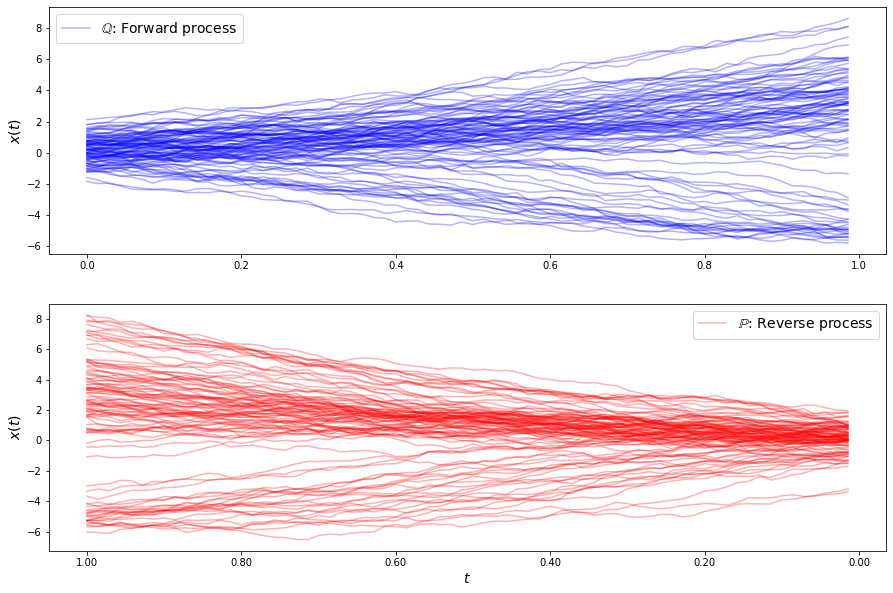

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


297029.97671309655
276266.5235683916
268382.0056080848
270857.41495475767
265164.1906077892
263635.2757202948
265796.80645710265
259573.9545115547
264141.397263945
260985.99300665697
258162.06748401892
260442.13714160206
259677.76644581457
257190.97579388274
257766.75505364162
258799.04469242744
257244.78931249553
255459.37406930962
255557.03339254946
256255.41540470853
255799.65933931628
255068.94560510007
255251.50996717892
255167.97008067666
254341.71343978547
254136.3086465026
254926.91575918347
255444.65639263828
254914.98906085314
254186.17731795664
254261.27781840847
254728.9119449492
254551.90780874
253900.61859423041
253861.3975177115
254431.0468843936
254599.4719085687
254066.5977934702
253589.02280248658
253735.07950660045
254124.31066542107
254159.3840388491
253868.945324638
253652.05676029494
253697.74381715953
253849.78369558498
253803.7825413156
253439.23171060448
253011.42215188578
252930.1253484605
287753.9401903169
260044.03192108832
262324.7455140088
251682.690638588

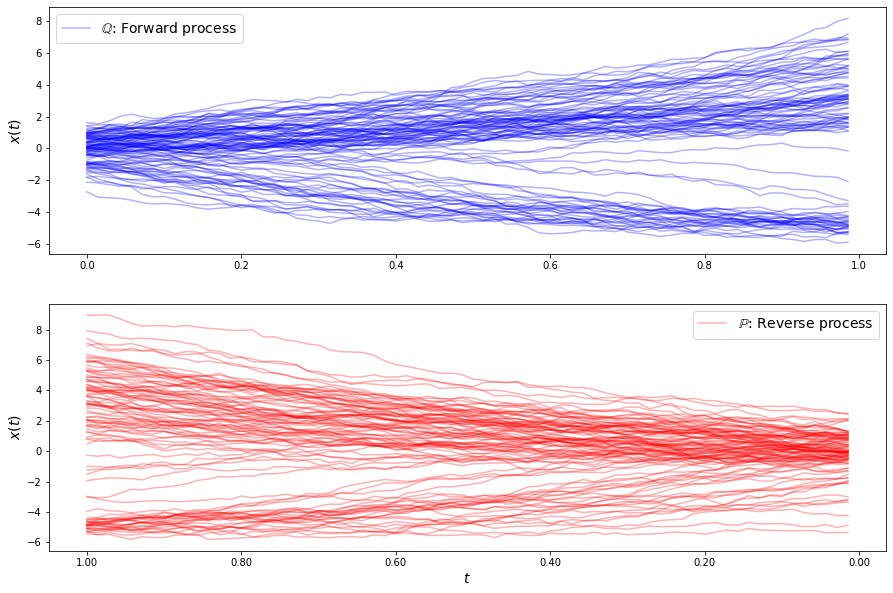

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


307998.67782283365
271892.4612744717
264201.9171871341
271879.752721971
261223.49399005313
261541.88738223154
258431.47032349426
257546.77343432393
257853.3713267227
257281.11723513744
256428.13895987248
255148.1175558261
256821.16136974638
255273.70877652033
253010.3210478216
254542.9704393446
255593.73841858102
253866.38441924317
252894.98554404045
253433.09350442392
253394.06803903062
252706.10171002042
252286.3043917818
251780.8696985179
251436.61471075134
252059.83307146523
252339.04975952857
251118.0007075018
250202.33105633396
250915.34388395588
251610.11453566875
250721.33020858833
249524.34862098415
249896.36009032727
250860.93820914146
250360.0273866003
249360.25321248473
249628.6985378539
250205.7548780383
249938.2834725015
249402.45227595777
249351.86021847546
249583.19465672135
249437.1771375017
249193.49377823347
249321.20562621916
249224.12565552644
248989.70200636197
249138.74339352443
249309.6992938362
277082.58986697445
277470.0454039349
260923.7713847249
257638.72616

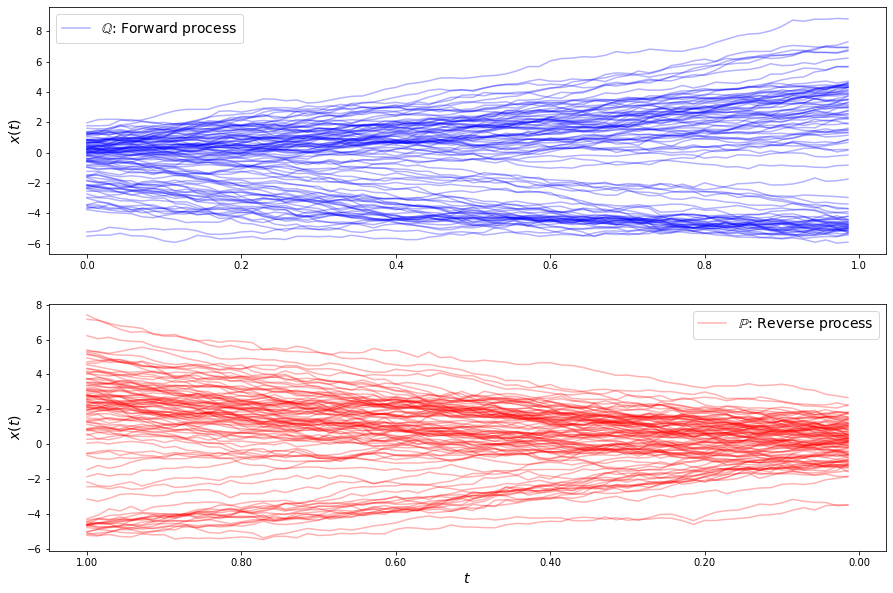

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


296830.4828143193
280113.63350023725
263409.613334166
270452.0615209448
258492.2812104815
264289.2060800248
259624.2878477713
256948.94709787593
260716.31162267333
259804.70652201126
255507.3294712758
256318.0575792796
258197.66564731274
257106.25422657872
255579.30624719802
254323.08843096954
256401.77740195594
256305.48615940174
256427.72217091592
254882.8060309696
253876.03881545283
254600.6551358023
254639.15816783634
255357.73426038885
254933.6356623914
253745.1959519891
253769.69857719552
253684.4753145882
253861.28205865313
254641.49875389866
254502.5826354856
253890.54403500358
253648.98297577145
253205.2701793805
252928.88377548716
253427.46923673426
253822.3482143308
253583.8556135221
253326.72744155175
253148.1604174245
252780.3111318082
252639.40017827478
253010.45492822223
253339.26431568153
253220.10207037703
252984.0441585599
252820.7376084354
252480.404707338
252110.45904657236
252199.15157335735
291400.5551100763
261352.88986244873
273221.2647244254
245633.4926987891
2

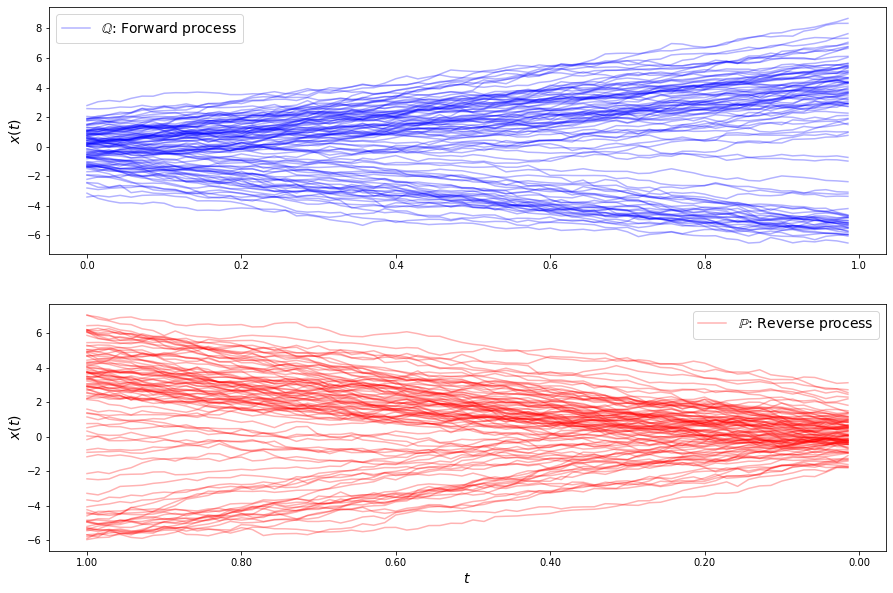

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


302928.83485550445
266637.7874825897
267273.0329149743
275886.7069760608
271980.0956507247
285971.6041704975
264757.42402447003
274837.40430837503
264250.25551832817
265307.34554514784
268006.866754784
264619.3526201812
262439.72704835935
265293.1392843579
266146.17634250136
263330.72606679145
262388.65297994856
262786.3773731404
263531.67686002713
264260.7074778959
263098.90415564174
261492.65061371477
261713.53775442706
262421.0756653956
262463.76809043647
262598.22171625646
262427.077721514
261440.54674119918
260844.9115480967
261227.90113447566
261541.92353792937
261547.82334028214
261777.27820123796
261731.46005424234
261056.33315171383
260616.5657346274
260869.54679174122
261047.80515208433
261064.91177788778
261437.34416762827
261664.26102786194
261255.69244580844
260837.56834580892
260776.74390785492
260574.43862270343
260377.89346693904
260707.02949844958
261116.75467246256
261062.62586183284
260897.55314821022
313295.58749140595
248176.12009244447
259820.1737354531
254377.242

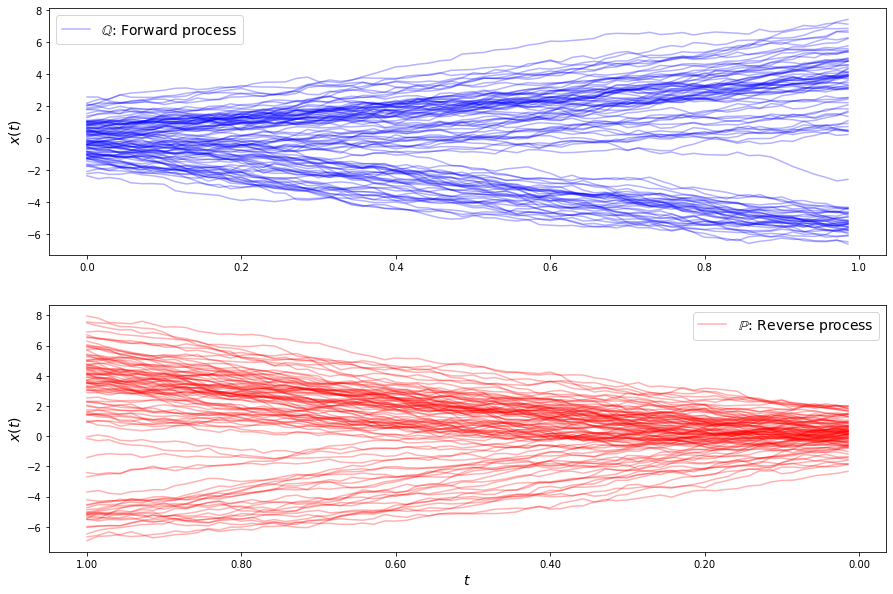

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


323109.3627584439
262884.86927832075
280808.78030777304
262510.9395926031
278943.1781248294
266418.756954635
265385.6547517262
268546.5403326127
261548.33978246516
262557.3279234569
266095.2934395174
262497.3959284979
259160.7497166315
261330.247290045
262320.1928858182
261608.89380350616
259208.78049632342
258951.390610804
260728.6512798685
261221.57095504148
260235.2939843259
259181.55100390472
258487.1189680571
258569.66988883476
259597.47561518708
260187.82960676288
259372.10617363808
258366.92086811547
258156.1988308264
258468.00553675927
258894.48932753198
259205.1497355236
259101.9479798841
258468.1324034101
257734.50291586673
257566.3634200327
258082.7306769587
258648.20344013226
258636.4647067627
258137.93092991415
257618.87432707782
257333.43025519923
257323.89933194732
257540.8716506979
257808.41180596506
257885.43335873313
257655.59209342732
257234.85516919053
256886.95619850798
256828.13728901488
308415.7137408969
248244.15493833274
251196.5283922233
248837.63516831968
248

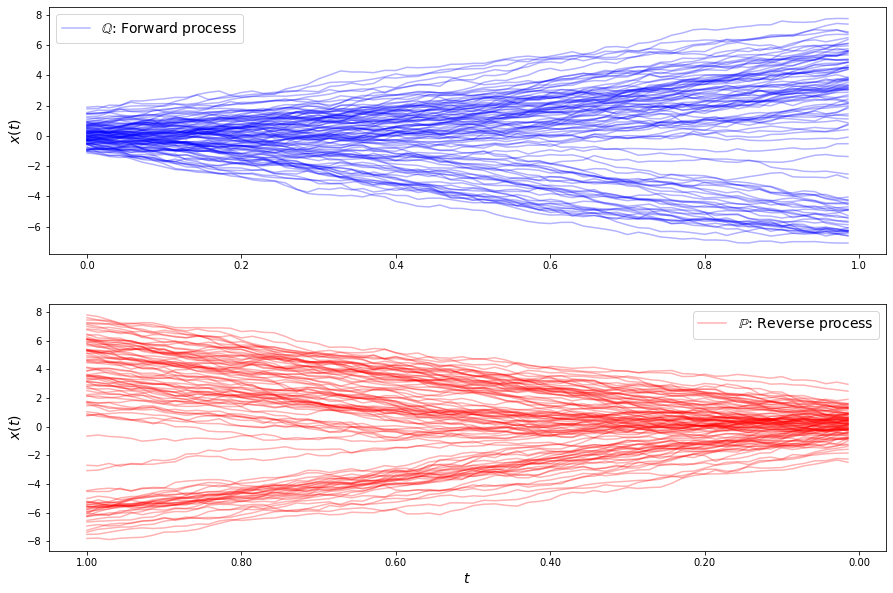

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


305805.7702002746
272064.7926624884
280099.5313416361
259396.1337890501
271061.9866683092
261419.2294230972
259039.44593313502
263749.65261308925
259492.0805816536
256770.91232354648
259244.95284008348
260129.62743554488
257439.64577840563
255737.0936461544
256751.7318386509
257727.44246015168
256542.738609439
255175.0842163595
255400.02652521612
256511.2042959513
256586.0885483073
255391.3896023587
254365.15099022837
254575.0967764525
255401.61676511023
255374.9058615834
254369.80469849543
253476.2987305873
253625.7946012818
254364.56540928624
254706.17043544486
254140.22133175243
253282.90019548012
253014.29590696187
253483.1594636678
254091.21892019958
254117.41904695847
253578.74659587722
252997.48075998656
252923.67085502803
253291.84914697212
253617.3880891226
253522.66579396432
253023.7993197335
252570.73492838963
252456.23609378602
252709.56255336865
253046.35373882359
253126.53398792844
252898.904690516
292920.32497443946
247673.20801668853
247873.47953625137
253361.9394911191

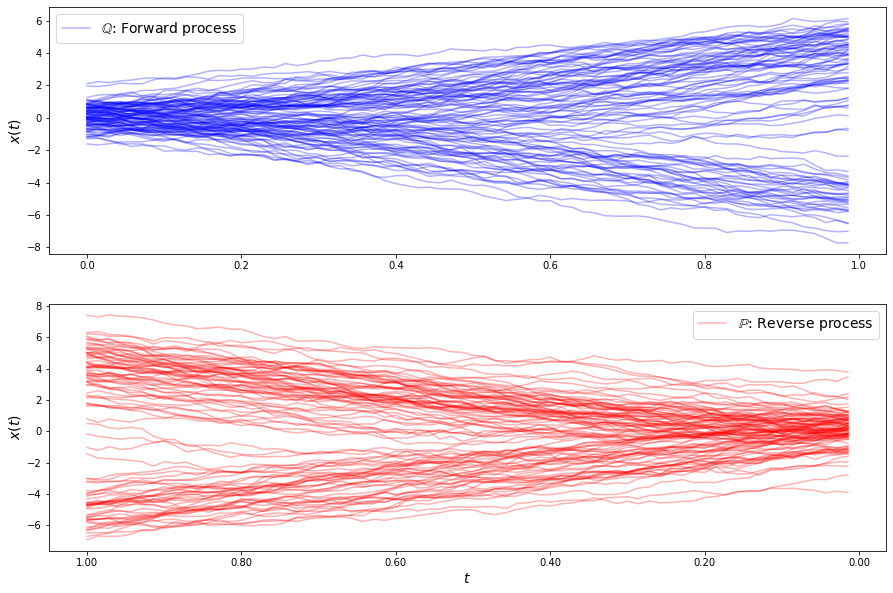

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


295646.7739086235
281360.82007686596
282277.9541739392
273709.7090479457
276249.61006769945
262836.89187292726
268619.4718087518
267109.5887403373
262175.3600519566
262718.78974815184
265905.96311103104
264485.82192036975
260403.92978266976
260252.2320681485
261608.0271659647
262037.07791916834
261091.68347641212
258881.23820894927
258635.89944451602
259775.44588366395
260154.833284154
260230.15038042847
258981.60126750707
257593.46594217123
257647.45045340376
257914.73982441268
258651.84196716675
258598.85164736942
257422.53549845942
256886.6117701807
256383.65410645097
256731.32613664327
257285.1054444259
257208.5460764302
257262.4174003154
256428.1734672301
255965.83848481387
255668.0887614
255630.25626901345
256239.64744171433
256318.40617660724
256669.39817255613
256255.05245656575
255988.01680458715
255728.89213745907
255523.3805020181
255786.1342379198
255643.21604801522
255918.11018090282
255627.61879027824
296702.5730717183
267380.39813576883
254201.2532398688
261548.996344097

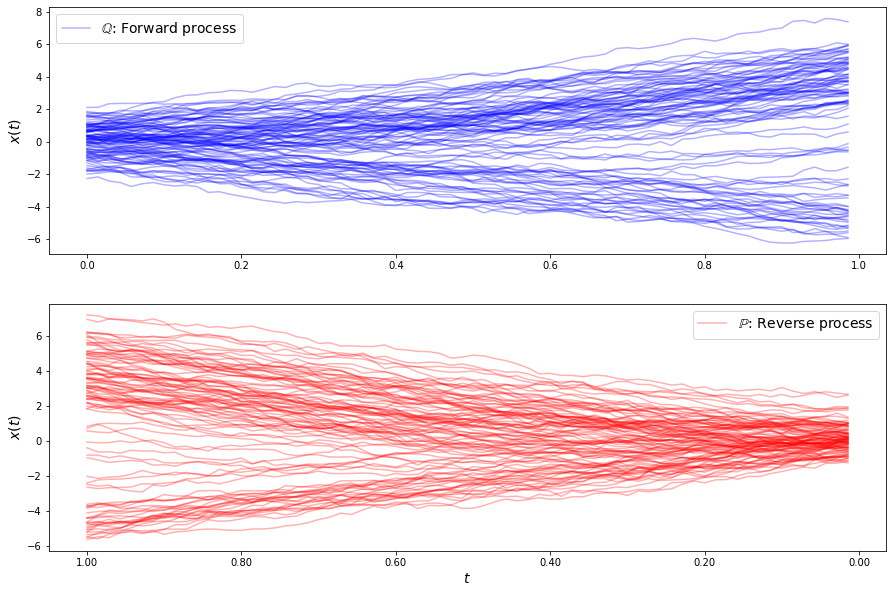

 /anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning:nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


308036.654144275
273749.2385705127
278629.103101829
263640.09765685
273088.1909570367
262167.2983298823
267420.75000120077
263499.0227000206
261399.9157227542
264645.7805578561
262024.882473496
259809.66401554694
261786.19730836037
261864.82399961093
259652.19129189773
259473.5543802611
260857.73734061726
261166.12822648778
260376.4424987108
260354.18941239745
260679.49594062363
260093.2824514358
258946.23763393404
258831.78512290484
258713.6937492586
258048.47621979387
258980.58885576582
259408.68700498974
258103.1837090936
258198.71761166508
257776.8481835591
257604.4244656871
258647.2838940464
258059.18619666056
258246.78430142452
257615.32722559827
257256.97022618895
257483.32324597499
257381.86677260068
257922.53932322236
257574.00232003722
257734.60819927786
256998.72678130955
257093.6725406806
256631.7556206928
257089.54312899284
256925.17488056468
257246.70029107513
256786.58948695066
256779.3057416228
291571.9041287346
241084.50609028863
260244.19322980085
244322.74634406337
2

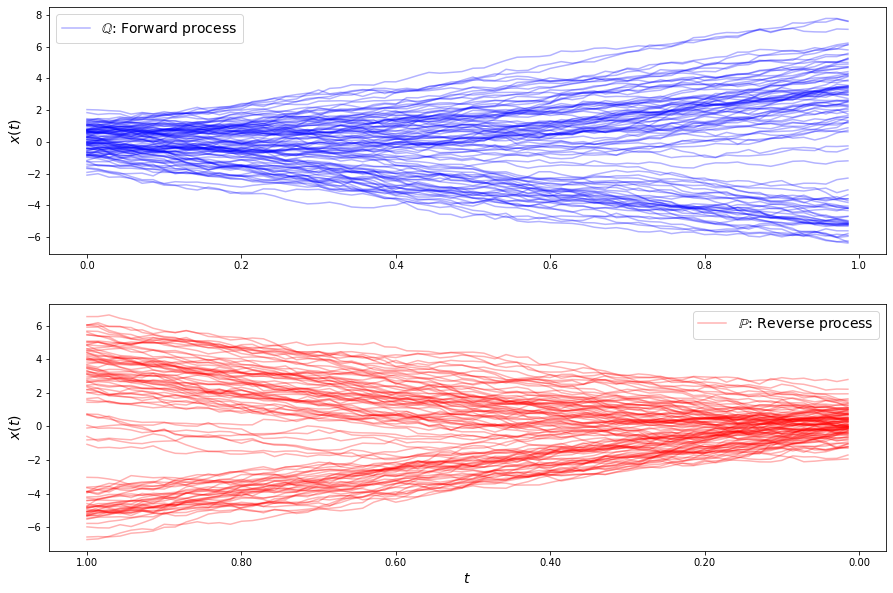

In [45]:
time = True

dim = 2 if time else 1

drift_q = lambda x: 0
N = 70
dt = 1.0 / N


# Estimating the backward drift of brownian motion
t, Q_2 = solve_sde_RK(alfa=drift_q, beta=1.0, X0=X1, dt=dt, N=int(1/dt))

Xs2, Ys2 = get_drift_data(Q_2, dt)

m_p = set_up_nn(Xs2, Ys2)

drift_p = lambda x: gp_drift_mean(x, m_p)



for i in range(100):
    
    # backward
    t, Q_1 = solve_sde_RK(alfa=drift_p, beta=1.0, X0=X2,dt=dt, N=int(1/dt))
    
    Xs, Ys = get_drift_data(Q_1, dt)
    
    m_q = set_up_nn(Xs, Ys)
    
    drift_q = lambda x: gp_drift_mean(x, m_q)
    
    
    T, M = solve_sde_RK(alfa=drift_q, beta=1, X0=Q_1[:,-1,:-1],dt=dt, N=int(1/dt))

#     plot_trajectories_(M, T)
    
    # forward
    t, Q_2 = solve_sde_RK(alfa=drift_q, beta=1.0, X0=X1,dt=dt, N=int(1/dt))
    
    Xs2, Ys2 = get_drift_data(Q_2, dt)
    
    m_p = set_up_nn(Xs2, Ys2)
    
    drift_p = lambda x: gp_drift_mean(x, m_p)
    
    
    T2, M2 = solve_sde_RK(alfa=drift_p, beta=1, X0=Q_2[:,-1,:-1],dt=dt, N=int(1/dt))

#     plot_trajectories_(M2,  T2)
    plot_trajectories_both(M, T, M2, T2)

In [46]:
# fig, axs = plt.subplots(1,2, sharey=False, figsize=(15, 8))
# axs[0].plot(c.loss_f[2:], color="blue", label="forward")
# axs[0].set_xlabel("Iteration")
# axs[0].set_ylabel("Loss")
# axs[0].legend()
# axs[1].plot(c.loss_b[2:], color="red", label="backward")
# axs[1].set_xlabel("Iteration")
# axs[1].set_ylabel("Loss")
# axs[1].legend()
# plt.savefig("_hard_relu_30_30_30__succesfl_bimodal_epochs.png")


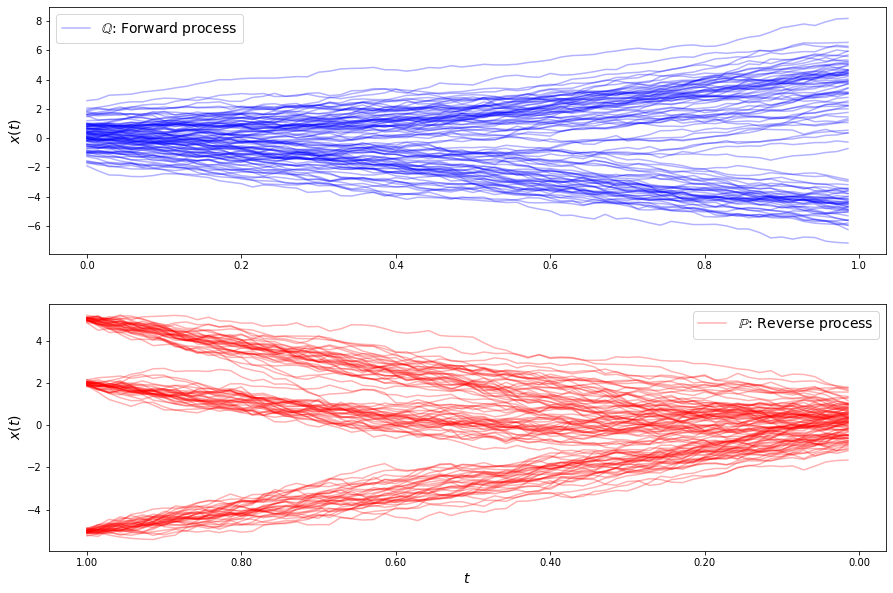

In [47]:
t, Xts = solve_sde_RK(alfa=drift_q, beta=1, X0=X1,dt=dt, N=int(1/dt))
t_, Xts_ = solve_sde_RK(alfa=drift_p, beta=1, X0=X2,dt=dt, N=int(1/dt))

plot_trajectories_both(Xts, t, Xts_, t_)

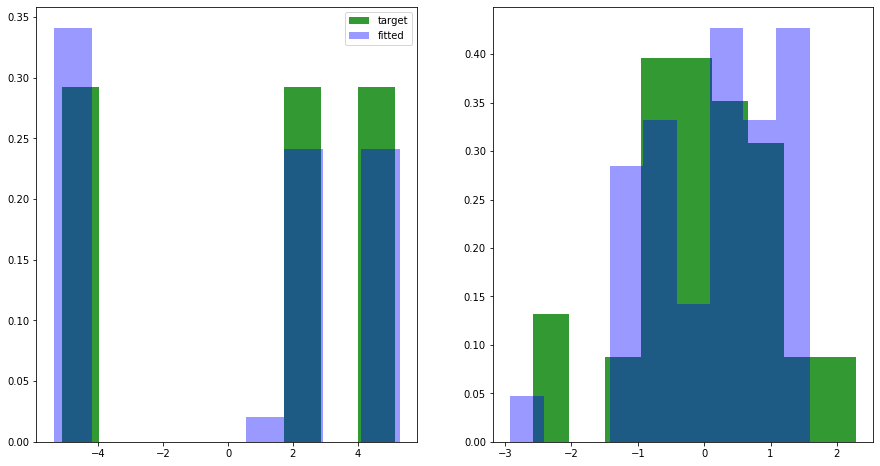

In [18]:
fig, axs = plt.subplots(1,2, figsize=(15, 8))


bins = 9
axs[1].hist(( X1.detach().cpu().numpy().flatten()), alpha=0.8, bins=bins, label="target", density=True, color="green");
axs[1].hist(( Xts_[:,-1,:-1].flatten().detach().cpu().numpy()), alpha=0.4, bins=bins, label="fitted", density=True, color="blue");



xx = torch.linspace(float(min(X1.min().detach().cpu().numpy(), Xts_[:,-1,:-1].min().detach().cpu().numpy() )) -3 ,
                    float(max(X1.max().detach().cpu().numpy(), Xts_[:,-1,:-1].max().detach().cpu().numpy() ))+3).reshape(-1,1).cuda().double()



# xx = torch.linspace(-10, 10).reshape(-1,1).cuda().double()
xx = torch.linspace(float(min(X2.min().detach().cpu().numpy(), Xts[:,-1,:-1].min().detach().cpu().numpy() )) -3 ,
                    float(max(X2.max().detach().cpu().numpy(), Xts[:,-1,:-1].max().detach().cpu().numpy() ))+3).reshape(-1,1).cuda().double()



bins = 9
axs[0].hist(( X2.detach().cpu().numpy().flatten()), alpha=0.8, bins=bins, label="target", density=True, color="green");
axs[0].hist(( Xts[:,-1,:-1].flatten().detach().cpu().numpy()), alpha=0.4, bins=bins, label="fitted", density=True, color="blue");
axs[0].legend()
# plt.savefig("hard_relu_20_20_20__succesfl_bimodal_boundaires.png")